# Visualising RNA velocity results on a per sample basis

Trophoblast organoid data without cytokine activation

07.2021

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import loompy
import scvelo as scv

import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import anndata
#import palantir
import matplotlib as mpl
import matplotlib.pyplot as plt
import os
#import matplotlib.font_manager


sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()

In [3]:
np.random.seed(0)

In [4]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
#sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

scanpy==1.7.1 anndata==0.7.5 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [5]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202105_troph_organoids_exp_1_2/'

In [6]:
%%bash

pip freeze

absl-py==0.12.0
aiohttp==3.7.4.post0
airr==1.3.1
alabaster==0.7.12
alembic @ file:///home/conda/feedstock_root/build_artifacts/alembic_1613901514078/work
anndata @ file:///home/conda/feedstock_root/build_artifacts/anndata_1605539061264/work
annoy @ file:///home/conda/feedstock_root/build_artifacts/python-annoy_1610271511811/work
anyio @ file:///home/conda/feedstock_root/build_artifacts/anyio_1614388751160/work/dist
arboreto==0.1.6
argon2-cffi @ file:///home/conda/feedstock_root/build_artifacts/argon2-cffi_1610522574055/work
async-generator==1.10
async-timeout==3.0.1
attrs @ file:///home/conda/feedstock_root/build_artifacts/attrs_1605083924122/work
Babel @ file:///home/conda/feedstock_root/build_artifacts/babel_1605182336601/work
backcall @ file:///home/conda/feedstock_root/build_artifacts/backcall_1592338393461/work
backports.functools-lru-cache==1.6.1
bbknn @ file:///opt/conda/conda-bld/bbknn_1616434096000/work
bleach @ file:///home/conda/feedstock_root/build_artifacts/bleach_16122134

In [7]:
# reading in adata with final annotation v5
adata = sc.read(save_path + 'adata_scVI_analysed_no_cytokines_after_scVI_with_gene_filter_and_excluding_filter_mix_cluster.h5ad')

## 4. RNA velocity

In [8]:
np.unique(adata.obs['sample'])

array(['6044STDY8640561', '6044STDY8640563', '6044STDY8640565',
       'Pla_Camb10123928', 'Pla_Camb10123929', 'Pla_Camb10123930',
       'Pla_Camb10123932', 'Pla_Camb10123934'], dtype=object)

In [9]:
save_path

'/lustre/scratch117/cellgen/team292/aa22/adata_objects/202105_troph_organoids_exp_1_2/'

In [10]:
# for all samples together

In [17]:
%%time

loom_paths = {}

loom_paths['6044STDY8640561'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640561_GRCh38-3_0_0/velocyto/possorted_genome_bam_BMQAN.loom'
loom_paths['6044STDY8640562'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640562_GRCh38-3_0_0/velocyto/possorted_genome_bam_BSTKJ.loom'
loom_paths['6044STDY8640563'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640563_GRCh38-3_0_0/velocyto/possorted_genome_bam_35OPS.loom'
loom_paths['6044STDY8640564'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640564_GRCh38-3_0_0/velocyto/possorted_genome_bam_7ERUS.loom'
loom_paths['6044STDY8640565'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640565_GRCh38-3_0_0/velocyto/possorted_genome_bam_HIH7J.loom'
loom_paths['6044STDY8640566'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640566_GRCh38-3_0_0/velocyto/possorted_genome_bam_5GU1C.loom'

loom_paths['Pla_Camb10123928'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123928_GRCh38-3_0_0/velocyto/possorted_genome_bam_NWG8F.loom'
loom_paths['Pla_Camb10123929'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123929_GRCh38-3_0_0/velocyto/possorted_genome_bam_8WBL5.loom'
loom_paths['Pla_Camb10123930'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123930_GRCh38-3_0_0/velocyto/possorted_genome_bam_QAIB6.loom'
loom_paths['Pla_Camb10123931'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123931_GRCh38-3_0_0/velocyto/possorted_genome_bam_EBF5C.loom'
loom_paths['Pla_Camb10123932'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123932_GRCh38-3_0_0/velocyto/possorted_genome_bam_WB6NO.loom'
loom_paths['Pla_Camb10123933'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123933_GRCh38-3_0_0/velocyto/possorted_genome_bam_QYPT4.loom'
loom_paths['Pla_Camb10123934'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123934_GRCh38-3_0_0/velocyto/possorted_genome_bam_9KR96.loom'
loom_paths['Pla_Camb10123935'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123935_GRCh38-3_0_0/velocyto/possorted_genome_bam_4RYRL.loom'

looms = []
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    looms.append(loom_paths[sample])

loompy.combine(looms, save_path + '20210801_velocyto_troph_organoids_no_cytokine.loom')

6044STDY8640561
6044STDY8640563
6044STDY8640565
Pla_Camb10123928
Pla_Camb10123929
Pla_Camb10123930
Pla_Camb10123932
Pla_Camb10123934


╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465
╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465
╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465
╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465
╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465
╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465
╭── 'batch_scan_layers' is deprecated. Use 'scan' instead
╰──> at /opt/conda/lib/python3.8/site-packages/loompy/loompy.py, line 465


CPU times: user 41min 34s, sys: 6min 51s, total: 48min 25s
Wall time: 1h 9min 45s


In [11]:
%%time
# takes about 25 minutes, but later faster
adata_loom = scv.read(save_path + '20210801_velocyto_troph_organoids_no_cytokine.loom', cache=True)

... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202105_troph_organoids_exp_1_2-20210801_velocyto_troph_organoids_no_cytokine.h5ad
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


CPU times: user 16.1 s, sys: 2.76 s, total: 18.9 s
Wall time: 48.5 s


In [12]:
adata_loom

AnnData object with n_obs × n_vars = 452097 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [13]:
adata_loom.obs.head()

""
possorted_genome_bam_BMQAN:AAACCCAAGAAGATCT
possorted_genome_bam_BMQAN:AAACCCAAGAAAGCGA
possorted_genome_bam_BMQAN:AAACCCAAGATAGCAT
possorted_genome_bam_BMQAN:AAACCCAAGATTCGCT
possorted_genome_bam_BMQAN:AAACCCAAGAGCATCG


In [14]:
adata

AnnData object with n_obs × n_vars = 37480 × 23281
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', '

In [15]:
len(adata.obs_names)

37480

In [16]:
adata_loom.obs_names

Index(['possorted_genome_bam_BMQAN:AAACCCAAGAAGATCT',
       'possorted_genome_bam_BMQAN:AAACCCAAGAAAGCGA',
       'possorted_genome_bam_BMQAN:AAACCCAAGATAGCAT',
       'possorted_genome_bam_BMQAN:AAACCCAAGATTCGCT',
       'possorted_genome_bam_BMQAN:AAACCCAAGAGCATCG',
       'possorted_genome_bam_BMQAN:AAACCCAAGAAGCTCG',
       'possorted_genome_bam_BMQAN:AAACCCAAGCTGAAGC',
       'possorted_genome_bam_BMQAN:AAACCCAAGCTAGTTC',
       'possorted_genome_bam_BMQAN:AAACCCAAGGACATCG',
       'possorted_genome_bam_BMQAN:AAACCCAAGTACGAGC',
       ...
       'possorted_genome_bam_9KR96:TTTGTTGTCCAAGCTA',
       'possorted_genome_bam_9KR96:TTTGTTGTCCAATCTT',
       'possorted_genome_bam_9KR96:TTTGTTGTCCACTTTA',
       'possorted_genome_bam_9KR96:TTTGTTGTCCGGCTTT',
       'possorted_genome_bam_9KR96:TTTGTTGTCGCATTAG',
       'possorted_genome_bam_9KR96:TTTGTTGTCGACATAC',
       'possorted_genome_bam_9KR96:TTTGTTGTCGAGTCCG',
       'possorted_genome_bam_9KR96:TTTGTTGTCCGTATGA',
       'possorted

In [17]:
# dict of bam names to sample names
bam2sample = {}

bam2sample['possorted_genome_bam_BMQAN'] = '6044STDY8640561'
bam2sample['possorted_genome_bam_BSTKJ'] = '6044STDY8640562'
bam2sample['possorted_genome_bam_35OPS'] = '6044STDY8640563'
bam2sample['possorted_genome_bam_7ERUS'] = '6044STDY8640564'
bam2sample['possorted_genome_bam_HIH7J'] = '6044STDY8640565'
bam2sample['possorted_genome_bam_5GU1C'] = '6044STDY8640566'
bam2sample['possorted_genome_bam_NWG8F'] = 'Pla_Camb10123928'
bam2sample['possorted_genome_bam_8WBL5'] = 'Pla_Camb10123929'
bam2sample['possorted_genome_bam_QAIB6'] = 'Pla_Camb10123930'
bam2sample['possorted_genome_bam_EBF5C'] = 'Pla_Camb10123931'
bam2sample['possorted_genome_bam_WB6NO'] = 'Pla_Camb10123932'
bam2sample['possorted_genome_bam_QYPT4'] = 'Pla_Camb10123933'
bam2sample['possorted_genome_bam_9KR96'] = 'Pla_Camb10123934'
bam2sample['possorted_genome_bam_4RYRL'] = 'Pla_Camb10123935'



In [18]:
adata.obs['barcode_sample_copy'] = adata.obs.index

In [19]:
for barcode_sample in list(adata.obs['barcode_sample_copy']):
    if '-1' not in barcode_sample:
        print(barcode_sample)

In [20]:
adata_loom

AnnData object with n_obs × n_vars = 452097 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [21]:
adata

AnnData object with n_obs × n_vars = 37480 × 23281
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', '

In [22]:
# getting from the indices above to the ones in adata.obs['barcode_sample']
adata_loom.obs['barcode_sample_sc_like'] = [elem.split(':')[1] + '-1_' + bam2sample[elem.split(':')[0]] for elem in adata_loom.obs_names]

In [23]:
adata_loom.obs.set_index('barcode_sample_sc_like', inplace=True)
adata_loom.obs

""
barcode_sample_sc_like
AAACCCAAGAAGATCT-1_6044STDY8640561
AAACCCAAGAAAGCGA-1_6044STDY8640561
AAACCCAAGATAGCAT-1_6044STDY8640561
AAACCCAAGATTCGCT-1_6044STDY8640561
AAACCCAAGAGCATCG-1_6044STDY8640561
...
TTTGTTGTCGACATAC-1_Pla_Camb10123934
TTTGTTGTCGAGTCCG-1_Pla_Camb10123934
TTTGTTGTCCGTATGA-1_Pla_Camb10123934


In [24]:
#adata_loom.obs_names = [i.split(':')[1] for i in adata_loom.obs_names]

In [25]:
adata_loom.obs_names_make_unique()

In [26]:
adata_loom.obs_names

Index(['AAACCCAAGAAGATCT-1_6044STDY8640561',
       'AAACCCAAGAAAGCGA-1_6044STDY8640561',
       'AAACCCAAGATAGCAT-1_6044STDY8640561',
       'AAACCCAAGATTCGCT-1_6044STDY8640561',
       'AAACCCAAGAGCATCG-1_6044STDY8640561',
       'AAACCCAAGAAGCTCG-1_6044STDY8640561',
       'AAACCCAAGCTGAAGC-1_6044STDY8640561',
       'AAACCCAAGCTAGTTC-1_6044STDY8640561',
       'AAACCCAAGGACATCG-1_6044STDY8640561',
       'AAACCCAAGTACGAGC-1_6044STDY8640561',
       ...
       'TTTGTTGTCCAAGCTA-1_Pla_Camb10123934',
       'TTTGTTGTCCAATCTT-1_Pla_Camb10123934',
       'TTTGTTGTCCACTTTA-1_Pla_Camb10123934',
       'TTTGTTGTCCGGCTTT-1_Pla_Camb10123934',
       'TTTGTTGTCGCATTAG-1_Pla_Camb10123934',
       'TTTGTTGTCGACATAC-1_Pla_Camb10123934',
       'TTTGTTGTCGAGTCCG-1_Pla_Camb10123934',
       'TTTGTTGTCCGTATGA-1_Pla_Camb10123934',
       'TTTGTTGTCGAGCCAC-1_Pla_Camb10123934',
       'TTTGTTGTCGTACCTC-1_Pla_Camb10123934'],
      dtype='object', name='barcode_sample_sc_like', length=452097)

In [27]:
len(set(adata_loom.obs.index) & set(adata.obs.index))

34961

In [28]:
adata

AnnData object with n_obs × n_vars = 37480 × 23281
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', '

In [29]:
adata_loom = adata_loom[[i for i in list(set(adata_loom.obs.index) & set(adata.obs.index))]].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [30]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [31]:
adata_loom.var_names_make_unique()
adata_loom.obs_names_make_unique()

In [32]:
scv.pp.show_proportions(adata_loom)
scv.pp.cleanup(adata_loom, clean='all')

Abundance of ['spliced', 'unspliced']: [0.73 0.27]


In [33]:
adata_loom.layers['spliced']

<34961x33538 sparse matrix of type '<class 'numpy.uint32'>'
	with 89915492 stored elements in Compressed Sparse Row format>

In [34]:
adata_loom.layers['unspliced']

<34961x33538 sparse matrix of type '<class 'numpy.uint32'>'
	with 64791912 stored elements in Compressed Sparse Row format>

In [35]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 33538
    layers: 'spliced', 'unspliced'

In [36]:
adata_loom.obs['n_counts_spliced'] = adata_loom.layers['spliced'].sum(1)

In [37]:
adata_loom.obs['n_counts_unspliced'] = adata_loom.layers['unspliced'].sum(1)

In [38]:
np.unique(adata_loom.obs['n_counts_spliced'])

array([   346,    362,    366, ..., 112031, 124098, 126342], dtype=uint64)

In [39]:
np.unique(adata_loom.obs['n_counts_unspliced'])

array([   14,    16,    18, ..., 46149, 47812, 61546], dtype=uint64)

In [40]:
adata_loom.var_names_make_unique()
scv.pp.filter_and_normalize(adata_loom, min_counts=20, 
                            #min_counts_u=10, 
                            n_top_genes=4000)

Filtered out 15437 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.


In [41]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 4000
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable'
    layers: 'spliced', 'unspliced'

In [42]:
scv.pp.moments(adata_loom)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:14)


computing neighbors
    finished (0:00:20) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:07) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [43]:
%%time
scv.tl.velocity(adata_loom)
scv.tl.velocity_graph(adata_loom)

computing velocities
    finished (0:00:25) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:01:23) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
CPU times: user 2min 12s, sys: 1min 2s, total: 3min 15s
Wall time: 1min 50s


In [44]:
scv.tl.louvain(adata_loom, resolution=0.6)
scv.tl.velocity_embedding(adata_loom, basis='pca')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:10)


computing velocity embedding
    finished (0:00:10) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


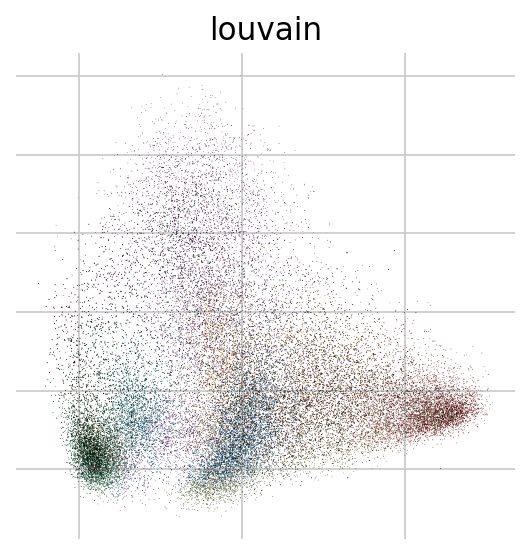

In [45]:
scv.pl.velocity_embedding(adata_loom, basis='pca')

In [46]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 4000
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'velocity_pca'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

In [47]:
#scv.pl.velocity_embedding_stream(adata_loom, basis='umap', color='prelim_annot_v3')

In [48]:
scv.tl.terminal_states(adata_loom) # rerun

computing terminal states
    identified 10 regions of root cells and 2 regions of end points .
    finished (0:00:37) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


In [49]:
adata_loom.obs.columns

Index(['n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced',
       'initial_size_unspliced', 'initial_size', 'n_counts',
       'velocity_self_transition', 'louvain', 'root_cells', 'end_points'],
      dtype='object')

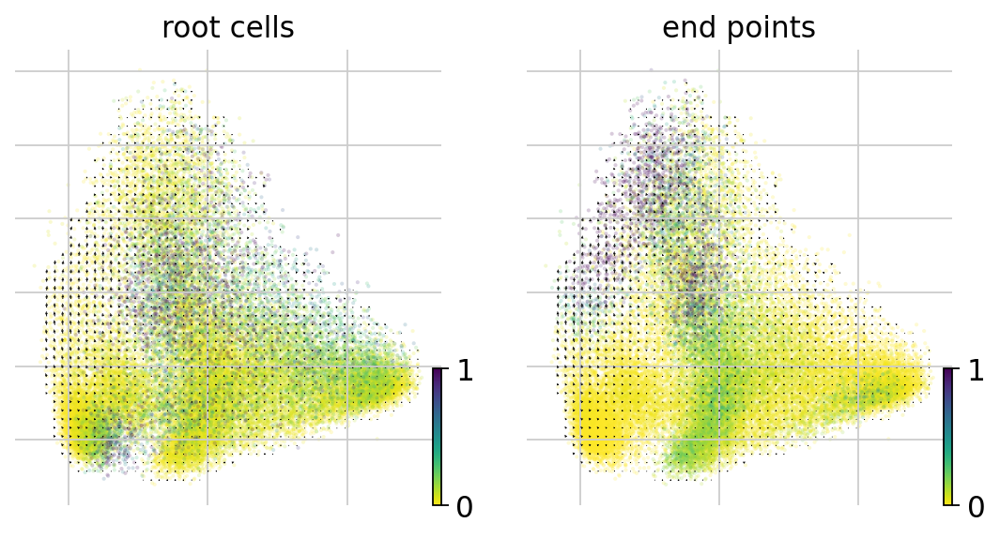

In [50]:
scv.pl.velocity_embedding_grid(adata_loom, basis='pca', color=['root_cells', 'end_points'])

In [51]:
adata

AnnData object with n_obs × n_vars = 37480 × 23281
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', '

In [70]:
adata_loom.uns['neighbors_scVI_n_latent_40_donor_sample_gf_v3'] = adata[adata_loom.obs_names,:].uns['neighbors_scVI_n_latent_40_donor_sample_gf_v3']
adata_loom.obsp['neighbors_scVI_n_latent_40_donor_sample_gf_v3_distances'] = adata[adata_loom.obs_names,:].obsp['neighbors_scVI_n_latent_40_donor_sample_gf_v3_distances']
adata_loom.obsp['neighbors_scVI_n_latent_40_donor_sample_gf_v3_connectivities'] = adata[adata_loom.obs_names,:].obsp['neighbors_scVI_n_latent_40_donor_sample_gf_v3_connectivities']


In [71]:
adata_loom.obsm['X_scVI_n_latent_40_donor_sample_gf_v3'] = adata[adata_loom.obs_names,:].obsm['X_scVI_n_latent_40_donor_sample_gf_v3']

In [72]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 4000
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'louvain', 'louvain_colors', 'neighbors_scVI', 'umap', 'neighbors_scVI_n_latent_40_donor_sample_gf_v3'
    obsm: 'X_pca', 'velocity_pca', 'X_umap', 'X_scVI_n_latent_40_donor_sample_gf_v3'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities', 'neighbors_scVI_n_latent_40_donor_sample_gf_v3_distances', 'neighbors_scVI_n_latent_40_donor_sample_gf_v3_connectivities'

In [77]:
for col in adata.obs.columns:
    print(col)
    adata_loom.obs[col] = adata.obs.loc[adata_loom.obs_names, col]

n_genes
time_point
activation_status
media
sample
percent_mito
n_counts
dataset
technique
scrublet_score
scrublet_cluster_score
bh_pval
batch
is_doublet
experiment
barcode
souporcell_assignment
inter_ind_doublet
donor
prelim_annot_v2
S_score
G2M_score
phase
celltype_predictions_P13
probabilities_P13
celltype_predictions_Roser
probabilities_Roser
louvain
louvain_R
barcode_sample_copy
prelim_annot_v3
final_annot_v4
louvain_R_5
louvain_R_5,1
louvain_R_4
louvain_RR_4
louvain_final
louvain_RR_4_1
final_annot_v5


In [73]:
scv.tl.umap(adata_loom, neighbors_key = 'neighbors_scVI_n_latent_40_donor_sample_gf_v3')

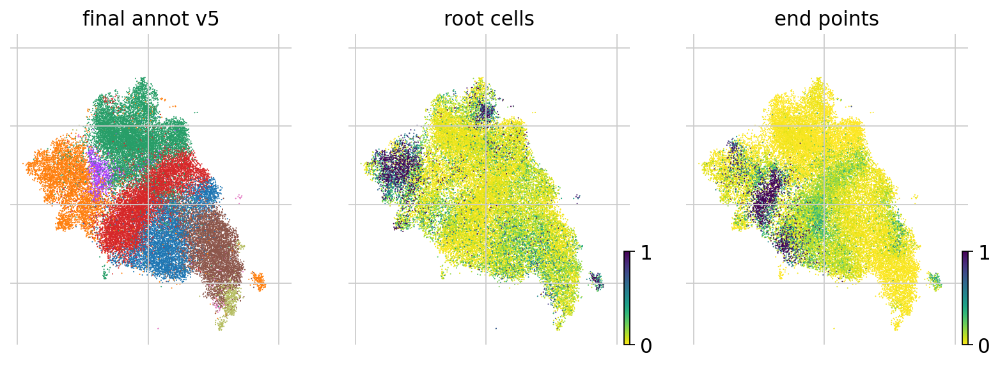

In [79]:
scv.pl.umap(adata_loom, color=['final_annot_v5','root_cells','end_points'])

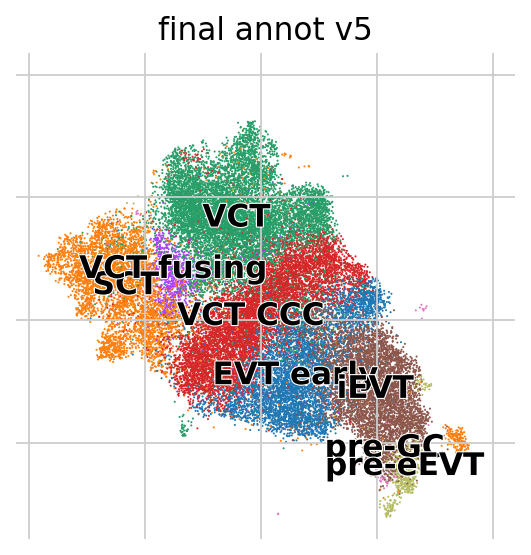

In [84]:
scv.pl.umap(adata_loom, color=['final_annot_v5'])

In [80]:
scv.tl.terminal_states(adata_loom)

computing terminal states
    identified 10 regions of root cells and 2 regions of end points .
    finished (0:00:38) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


In [81]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 4000
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points', 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'v

computing velocity embedding
    finished (0:00:07) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


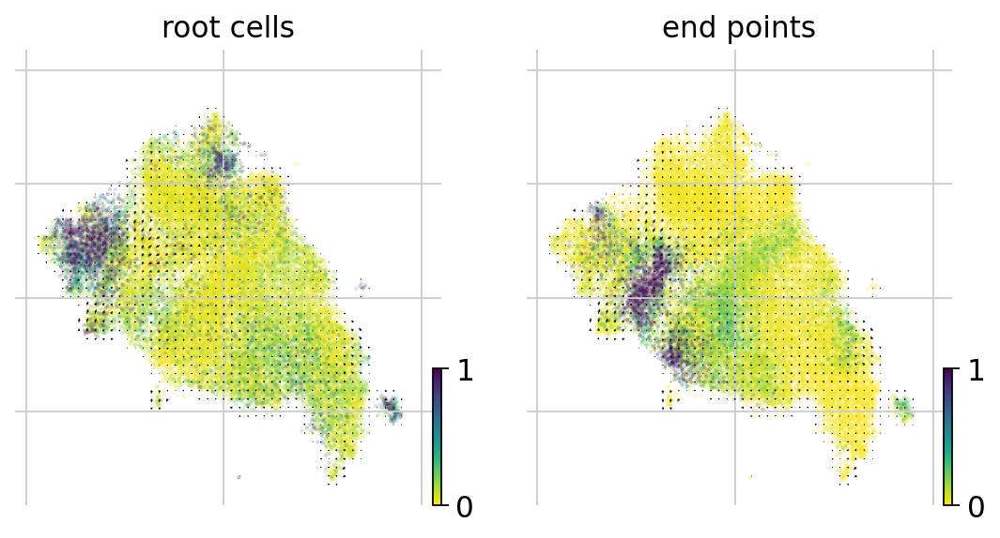

In [83]:
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

scv.pl.velocity_embedding_grid(adata_loom, basis='X_umap', 
                               color=['root_cells', 'end_points'], )

In [85]:
scv.tl.umap(adata_loom)

computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 10 regions of root cells and 2 regions of end points .
    finished (0:00:40) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


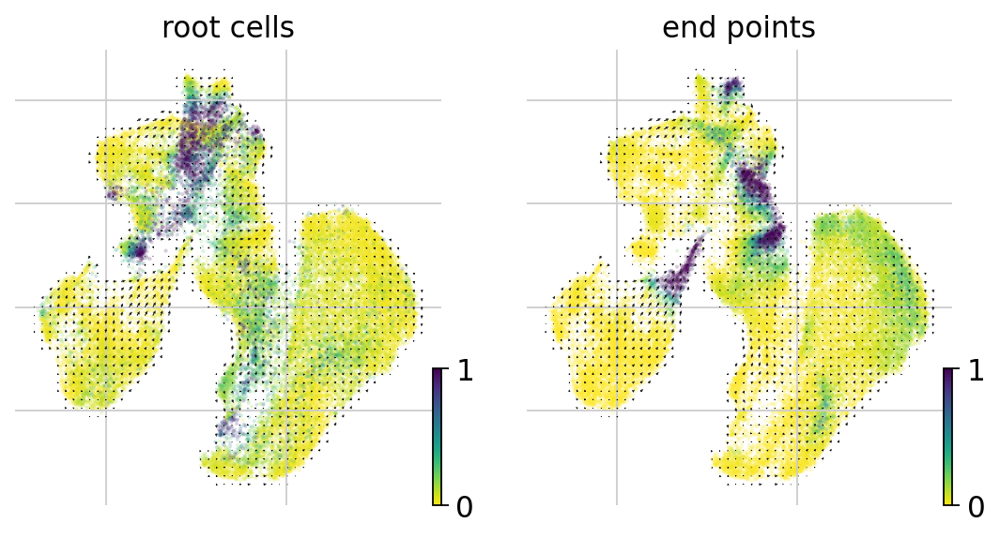

In [86]:
scv.tl.velocity_embedding(adata_loom, basis='umap')
scv.tl.terminal_states(adata_loom)
scv.pl.velocity_embedding_grid(adata_loom, basis='umap', color=['root_cells', 'end_points'])

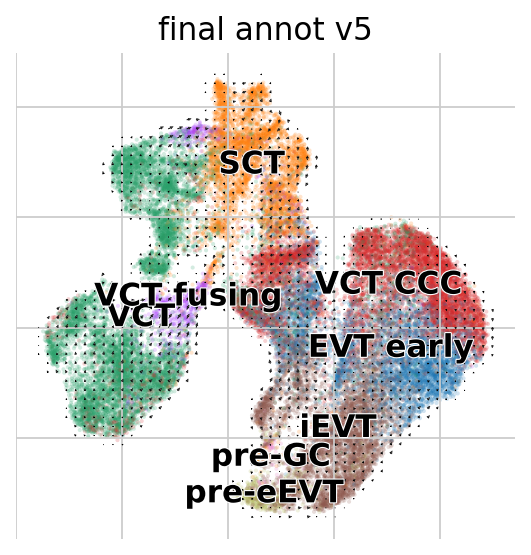

In [90]:
scv.pl.velocity_embedding_grid(adata_loom, basis='umap', color=['final_annot_v5'], legend_loc='on data')

In [87]:
adata_loom.obs

,n_counts_spliced,n_counts_unspliced,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,louvain,root_cells,end_points,...,barcode_sample_copy,prelim_annot_v3,final_annot_v4,louvain_R_5,"louvain_R_5,1",louvain_R_4,louvain_RR_4,louvain_final,louvain_RR_4_1,final_annot_v5
barcode_sample_sc_like,,,,,,,,,,,,,,,,,,,,,
ACGGTTAAGACCCGCT-1_Pla_Camb10123929,12814,3817,12814,3817,12814.0,17123.0,0.196185,4,0.697967,0.004107,...,ACGGTTAAGACCCGCT-1_Pla_Camb10123929,eEVT?,EVT,4,4,"4,1","4,1,2","4,1,2","4,1,2",pre-eEVT
TGCAGGCCATACCAGT-1_6044STDY8640561,2698,1737,2698,1737,2698.0,3778.0,0.106312,2,0.032216,0.034366,...,TGCAGGCCATACCAGT-1_6044STDY8640561,EVT,EVT,2,2,2,2,2,2,EVT_early
AGACTCATCCCGAGGT-1_Pla_Camb10123929,11139,4361,11139,4361,11139.0,14816.0,0.259893,10,0.017318,0.194860,...,AGACTCATCCCGAGGT-1_Pla_Camb10123929,EVT,EVT,10,10,10,10,10,10,EVT_early
GTAGAAAAGACCAACG-1_Pla_Camb10123932,7584,2321,7584,2321,7584.0,9847.0,0.269324,2,0.032497,0.014650,...,GTAGAAAAGACCAACG-1_Pla_Camb10123932,EVT,EVT,2,2,2,2,2,2,EVT_early
GTAGATCCAGAGTCTT-1_Pla_Camb10123932,10968,4397,10968,4397,10968.0,14055.0,0.371431,4,0.084163,0.004114,...,GTAGATCCAGAGTCTT-1_Pla_Camb10123932,EVT,EVT,4,4,"4,2","4,2","4,2","4,2",iEVT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCATTTGTCTAGGCAT-1_Pla_Camb10123929,8989,3037,8989,3037,8989.0,12145.0,0.231376,2,0.091397,0.027259,...,TCATTTGTCTAGGCAT-1_Pla_Camb10123929,EVT,EVT,2,2,2,2,2,2,EVT_early
TAATTCCTCGATGCAT-1_Pla_Camb10123934,6313,1362,6313,1362,6313.0,8397.0,0.235365,5,0.093300,0.000081,...,TAATTCCTCGATGCAT-1_Pla_Camb10123934,VCT,VCT,"5,0","5,0","5,0","5,0","5,0","5,0",VCT
TTGTGTTTCGGAGTAG-1_6044STDY8640565,16882,6344,16882,6344,16882.0,22509.0,0.271172,3,0.167291,0.000779,...,TTGTGTTTCGGAGTAG-1_6044STDY8640565,EVT_p,VCT_CCC,"3,0","3,0","3,0","3,0","3,0","3,0",VCT_CCC


In [147]:
adata.obs['root_cells_velocyto'] = list(adata_loom.obs['root_cells'])
adata.obs['end_points_velocyto'] = list(adata_loom.obs['end_points'])

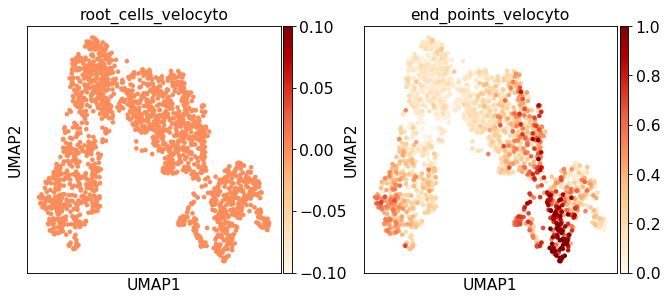

In [148]:
sc.pl.umap(adata, color=['root_cells_velocyto','end_points_velocyto'], cmap='OrRd')

In [149]:
adata_loom.obs

,n_counts_spliced,n_counts_unspliced,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,louvain,root_cells,end_points
barcode_sample_sn_like,,,,,,,,,,
AACAACCAGTCCTGCG-1_WSSS_PLA8764121,708,4643,708,4643,708.0,862.067810,0.077434,2,0.0,0.361075
AACACACCACTGAGGA-1_WSSS_PLA8764121,538,2588,538,2588,538.0,844.293579,0.348836,4,0.0,0.379664
AACCAACAGGTGGTTG-1_WSSS_PLA8764121,919,4928,919,4928,919.0,856.087036,0.131639,2,0.0,0.123704
AACCATGCACTAAACC-1_WSSS_PLA8764121,514,3316,514,3316,514.0,847.681030,0.246179,4,0.0,0.245112
AACCATGTCCAGCACG-1_WSSS_PLA8764121,344,1709,344,1709,344.0,838.412842,0.176096,4,0.0,0.264425
...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1_WSSS_PLA8810751,1903,9059,1903,9059,1903.0,866.705200,0.215555,0,0.0,0.771966
TTTACTGTCTGCATGA-1_WSSS_PLA8810751,1007,5238,1007,5238,1007.0,853.096313,0.088361,0,0.0,0.120079
TTTATGCCAGATACCT-1_WSSS_PLA8810751,784,4088,784,4088,784.0,869.625000,0.090821,0,0.0,0.094314


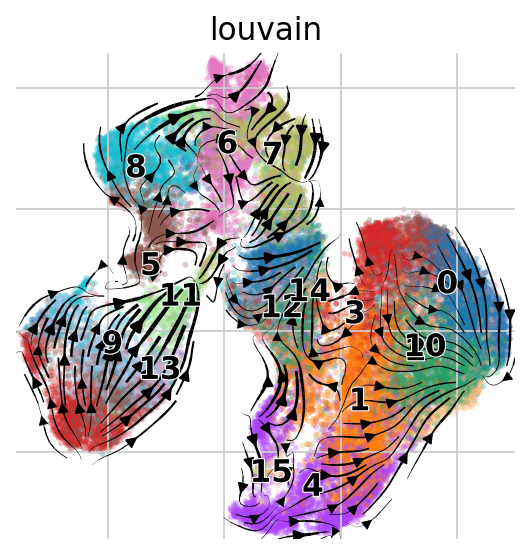

In [91]:
scv.pl.velocity_embedding_stream(adata_loom, basis='umap')


In [92]:
adata_loom

AnnData object with n_obs × n_vars = 34961 × 4000
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points', 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'v

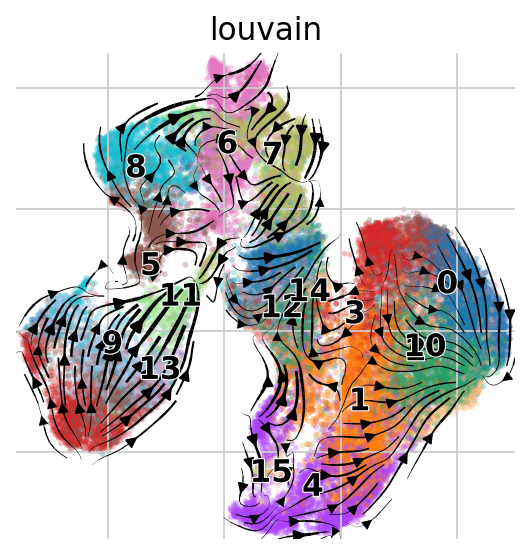

In [93]:
scv.pl.velocity_embedding_stream(adata_loom, basis='X_umap')


In [95]:
adata_loom.obs['cell_type'] = adata.obs.loc[adata_loom.obs_names,'final_annot_v5']

In [97]:
np.unique(adata_loom.obs['sample'])

array(['6044STDY8640561', '6044STDY8640563', '6044STDY8640565',
       'Pla_Camb10123928', 'Pla_Camb10123929', 'Pla_Camb10123930',
       'Pla_Camb10123932', 'Pla_Camb10123934'], dtype=object)

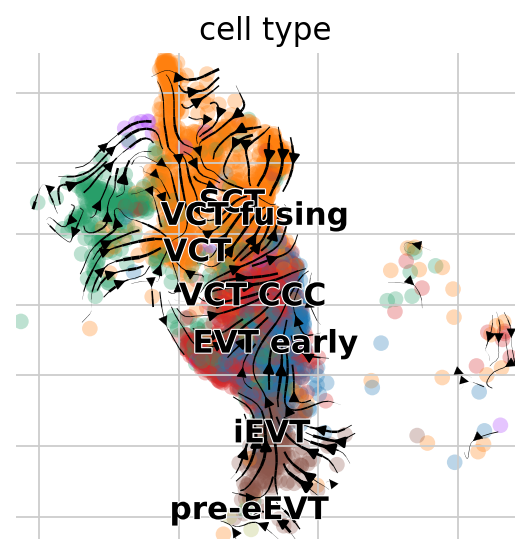

In [109]:
scv.pl.velocity_embedding_stream(adata_loom[adata_loom.obs['sample'] == 'Pla_Camb10123929'], basis='X_umap', color = 'cell_type')

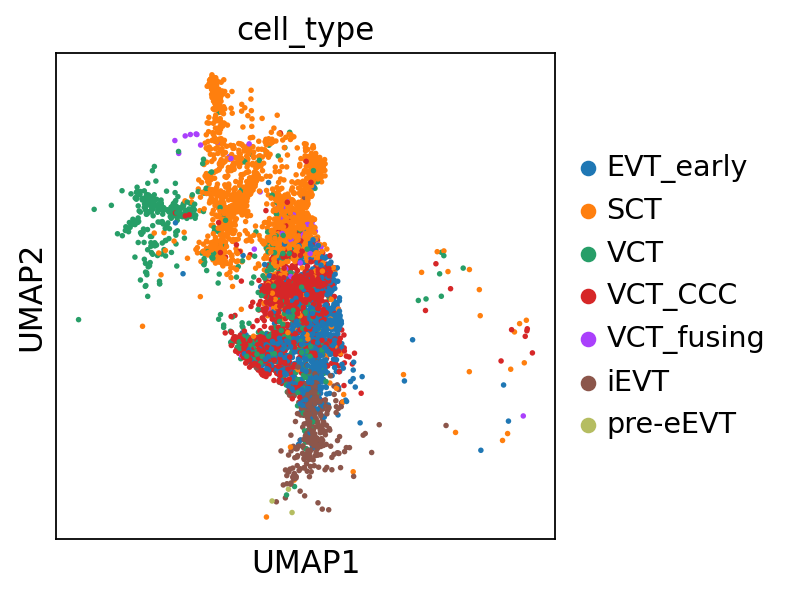

In [110]:
sc.pl.umap(adata_loom[adata_loom.obs['sample'] == 'Pla_Camb10123929'], color='cell_type')

In [160]:
adata_loom.obs['sample'] = adata.obs.set_index('barcode_sample').loc[adata_loom.obs_names,'sample']
adata_loom.obs['tissue_block'] = adata.obs.set_index('barcode_sample').loc[adata_loom.obs_names,'tissue_block']

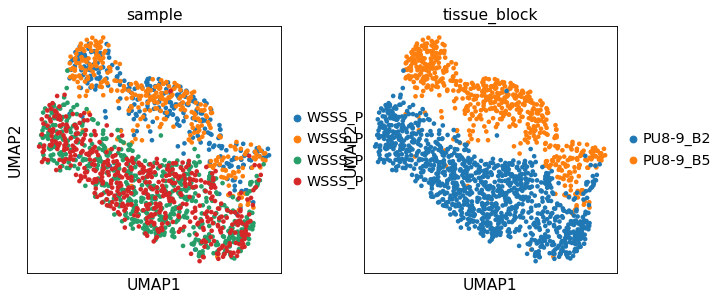

In [162]:
sc.pl.umap(adata_loom, color=['sample','tissue_block'])

In [163]:
adata_loom

AnnData object with n_obs × n_vars = 1729 × 4000
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points', 'cell_type', 'sample', 'tissue_block'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'louvain', 'louvain_colors', 'umap', 'cell_type_colors', 'sample_colors', 'tissue_block_colors'
    obsm: 'X_pca', 'velocity_pca', 'X_umap', 'velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

In [15]:
%%time

# reading separately

loom_paths = {}

loom_paths['6044STDY8640561'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640561_GRCh38-3_0_0/velocyto/possorted_genome_bam_BMQAN.loom'
loom_paths['6044STDY8640562'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640562_GRCh38-3_0_0/velocyto/possorted_genome_bam_BSTKJ.loom'
loom_paths['6044STDY8640563'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640563_GRCh38-3_0_0/velocyto/possorted_genome_bam_35OPS.loom'
loom_paths['6044STDY8640564'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640564_GRCh38-3_0_0/velocyto/possorted_genome_bam_7ERUS.loom'
loom_paths['6044STDY8640565'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640565_GRCh38-3_0_0/velocyto/possorted_genome_bam_HIH7J.loom'
loom_paths['6044STDY8640566'] = '/lustre/scratch117/cellgen/team292/aa22/data/201911_troph_organoids_experiment_1_cellranger/cellranger302_count_32734_6044STDY8640566_GRCh38-3_0_0/velocyto/possorted_genome_bam_5GU1C.loom'

loom_paths['Pla_Camb10123928'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123928_GRCh38-3_0_0/velocyto/possorted_genome_bam_NWG8F.loom'
loom_paths['Pla_Camb10123929'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123929_GRCh38-3_0_0/velocyto/possorted_genome_bam_8WBL5.loom'
loom_paths['Pla_Camb10123930'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123930_GRCh38-3_0_0/velocyto/possorted_genome_bam_QAIB6.loom'
loom_paths['Pla_Camb10123931'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123931_GRCh38-3_0_0/velocyto/possorted_genome_bam_EBF5C.loom'
loom_paths['Pla_Camb10123932'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123932_GRCh38-3_0_0/velocyto/possorted_genome_bam_WB6NO.loom'
loom_paths['Pla_Camb10123933'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123933_GRCh38-3_0_0/velocyto/possorted_genome_bam_QYPT4.loom'
loom_paths['Pla_Camb10123934'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123934_GRCh38-3_0_0/velocyto/possorted_genome_bam_9KR96.loom'
loom_paths['Pla_Camb10123935'] = '/lustre/scratch117/cellgen/team292/aa22/data/202104_placental_organoids_experiment_2/cellranger302_count_37295_Pla_Camb10123935_GRCh38-3_0_0/velocyto/possorted_genome_bam_4RYRL.loom'



#looms = []
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    #looms.append(loom_paths[sample])
    curr_loom =[]
    curr_loom.append(loom_paths[sample])
    loompy.combine(curr_loom, save_path + '20210801_velocyto_donor_sample_' + sample + '.loom')

6044STDY8640561
6044STDY8640563
6044STDY8640565
Pla_Camb10123928
Pla_Camb10123929
Pla_Camb10123930
Pla_Camb10123932
Pla_Camb10123934
CPU times: user 1.84 s, sys: 9.83 s, total: 11.7 s
Wall time: 1min 7s


In [32]:
%%time
# takes about 25 minutes, but later faster
adatas_loom = {}

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample] = scv.read(save_path + '20210423_velocyto_donor_P13_sample_' + sample + '.loom', cache=True)

WSSS_PLA8764121


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... writing an h5ad cache file to speedup reading next time
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


WSSS_PLA8764122


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... writing an h5ad cache file to speedup reading next time
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


WSSS_PLA8810750


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... writing an h5ad cache file to speedup reading next time
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


WSSS_PLA8810751


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... writing an h5ad cache file to speedup reading next time
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


CPU times: user 16min 12s, sys: 1min, total: 17min 12s
Wall time: 17min 44s


In [33]:
adatas_loom

{'WSSS_PLA8764121': AnnData object with n_obs × n_vars = 85256 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'matrix', 'ambiguous', 'spliced', 'unspliced',
 'WSSS_PLA8764122': AnnData object with n_obs × n_vars = 81782 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'matrix', 'ambiguous', 'spliced', 'unspliced',
 'WSSS_PLA8810750': AnnData object with n_obs × n_vars = 84598 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'matrix', 'ambiguous', 'spliced', 'unspliced',
 'WSSS_PLA8810751': AnnData object with n_obs × n_vars = 71733 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'}

In [34]:
adatas_loom['WSSS_PLA8764121'].obs.head()

""
possorted_genome_bam_7ZNK7:AAACCCAAGATCACCT
possorted_genome_bam_7ZNK7:AAACCCAAGATCGCTT
possorted_genome_bam_7ZNK7:AAACCCAAGATACATG
possorted_genome_bam_7ZNK7:AAACCCAAGATTGCGG
possorted_genome_bam_7ZNK7:AAACCCAAGACGCTCC


In [35]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [36]:
len(adata.obs_names)

1729

In [38]:
adatas_loom['WSSS_PLA8764121'].obs_names

Index(['possorted_genome_bam_7ZNK7:AAACCCAAGATCACCT',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATCGCTT',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATACATG',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATTGCGG',
       'possorted_genome_bam_7ZNK7:AAACCCAAGACGCTCC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGAGTCAGC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGAGGATCC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCTCACTA',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCGTGCTC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCGGTAGT',
       ...
       'possorted_genome_bam_7ZNK7:TTTGTTGTCCTTTGAT',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCCGTAATG',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCGGACTGC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTCCGCAT',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTGCTAGA',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACGGGC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACCCAC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACAGGT',
       'possorted

In [39]:
# dict of bam names to sample names
bam2sample = {}

bam2sample['possorted_genome_bam_7ZNK7'] = 'WSSS_PLA8764121'
bam2sample['possorted_genome_bam_V4O8B'] = 'WSSS_PLA8764122'
bam2sample['possorted_genome_bam_PSPJC'] = 'WSSS_PLA8810750'
bam2sample['possorted_genome_bam_T8XDM'] = 'WSSS_PLA8810751'



In [40]:
for barcode_sample in list(adata.obs['barcode_sample']):
    if '-1' not in barcode_sample:
        print(barcode_sample)

In [42]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 85256 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [43]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [45]:
# getting from the indices above to the ones in adata.obs['barcode_sample']

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['barcode_sample_sn_like'] = [elem.split(':')[1] + '-1_' + bam2sample[elem.split(':')[0]] for elem in adatas_loom[sample].obs_names]

    adatas_loom[sample].obs.set_index('barcode_sample_sn_like', inplace=True)
    

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [46]:
adatas_loom['WSSS_PLA8764121'].obs

""
barcode_sample_sn_like
AAACCCAAGATCACCT-1_WSSS_PLA8764121
AAACCCAAGATCGCTT-1_WSSS_PLA8764121
AAACCCAAGATACATG-1_WSSS_PLA8764121
AAACCCAAGATTGCGG-1_WSSS_PLA8764121
AAACCCAAGACGCTCC-1_WSSS_PLA8764121
...
TTTGTTGTCTACGGGC-1_WSSS_PLA8764121
TTTGTTGTCTACCCAC-1_WSSS_PLA8764121
TTTGTTGTCTACAGGT-1_WSSS_PLA8764121


In [52]:
#adata_loom.obs_names = [i.split(':')[1] for i in adata_loom.obs_names]

In [47]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs_names_make_unique()

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [49]:
adatas_loom['WSSS_PLA8764121'].obs_names

Index(['AAACCCAAGATCACCT-1_WSSS_PLA8764121',
       'AAACCCAAGATCGCTT-1_WSSS_PLA8764121',
       'AAACCCAAGATACATG-1_WSSS_PLA8764121',
       'AAACCCAAGATTGCGG-1_WSSS_PLA8764121',
       'AAACCCAAGACGCTCC-1_WSSS_PLA8764121',
       'AAACCCAAGAGTCAGC-1_WSSS_PLA8764121',
       'AAACCCAAGAGGATCC-1_WSSS_PLA8764121',
       'AAACCCAAGCTCACTA-1_WSSS_PLA8764121',
       'AAACCCAAGCGTGCTC-1_WSSS_PLA8764121',
       'AAACCCAAGCGGTAGT-1_WSSS_PLA8764121',
       ...
       'TTTGTTGTCCTTTGAT-1_WSSS_PLA8764121',
       'TTTGTTGTCCGTAATG-1_WSSS_PLA8764121',
       'TTTGTTGTCGGACTGC-1_WSSS_PLA8764121',
       'TTTGTTGTCTCCGCAT-1_WSSS_PLA8764121',
       'TTTGTTGTCTGCTAGA-1_WSSS_PLA8764121',
       'TTTGTTGTCTACGGGC-1_WSSS_PLA8764121',
       'TTTGTTGTCTACCCAC-1_WSSS_PLA8764121',
       'TTTGTTGTCTACAGGT-1_WSSS_PLA8764121',
       'TTTGTTGTCGGTGTAT-1_WSSS_PLA8764121',
       'TTTGTTGTCTTGTTAC-1_WSSS_PLA8764121'],
      dtype='object', name='barcode_sample_sn_like', length=85256)

In [51]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['WSSS_PLA8764121', 'WSSS_PLA8764122', 'WSSS_PLA8810750',
        'WSSS_PLA8810751'], dtype=object),
 array([272, 326, 606, 525]))

In [52]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [58]:
# subsetting to only final cells

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    curr_overlap = set(adata.obs['barcode_sample']) & set(adatas_loom[sample].obs_names)
    #print('curr_overlap', list(curr_overlap)[:5])
    adatas_loom[sample] = adatas_loom[sample][list(curr_overlap),:].copy()
    
    adatas_loom[sample].var_names_make_unique()
    adatas_loom[sample].obs_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [59]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [60]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.show_proportions(adatas_loom[sample])
    scv.pp.cleanup(adatas_loom[sample], clean='all')

WSSS_PLA8764121
Abundance of ['spliced', 'unspliced']: [0.19 0.81]
WSSS_PLA8764122
Abundance of ['spliced', 'unspliced']: [0.19 0.81]
WSSS_PLA8810750
Abundance of ['spliced', 'unspliced']: [0.2 0.8]
WSSS_PLA8810751
Abundance of ['spliced', 'unspliced']: [0.19 0.81]


In [61]:
adatas_loom['WSSS_PLA8764121'].layers['spliced']

<272x33538 sparse matrix of type '<class 'numpy.uint32'>'
	with 164741 stored elements in Compressed Sparse Row format>

In [62]:
adatas_loom['WSSS_PLA8764121'].layers['unspliced']

<272x33538 sparse matrix of type '<class 'numpy.uint32'>'
	with 475215 stored elements in Compressed Sparse Row format>

In [63]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 33538
    layers: 'spliced', 'unspliced'

In [64]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['n_counts_spliced'] = adatas_loom[sample].layers['spliced'].sum(1)
    adatas_loom[sample].obs['n_counts_unspliced'] = adatas_loom[sample].layers['unspliced'].sum(1)

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [65]:
np.unique(adatas_loom['WSSS_PLA8764121'].obs['n_counts_spliced'])

array([  165,   168,   172,   176,   195,   201,   211,   224,   236,
         237,   238,   241,   242,   245,   249,   254,   265,   268,
         285,   290,   299,   302,   305,   306,   309,   310,   321,
         326,   333,   334,   340,   344,   363,   374,   375,   387,
         392,   393,   394,   396,   402,   403,   406,   409,   411,
         413,   414,   415,   417,   419,   421,   428,   440,   442,
         447,   449,   450,   452,   454,   455,   457,   461,   467,
         468,   470,   471,   475,   478,   479,   481,   484,   486,
         487,   490,   493,   503,   504,   506,   509,   511,   512,
         514,   517,   518,   525,   529,   530,   531,   532,   534,
         536,   538,   543,   544,   547,   548,   549,   554,   561,
         568,   569,   571,   577,   578,   583,   584,   585,   596,
         597,   598,   599,   603,   607,   608,   610,   620,   623,
         630,   632,   635,   639,   643,   649,   651,   652,   659,
         663,   668,

In [66]:
np.unique(adatas_loom['WSSS_PLA8764121'].obs['n_counts_unspliced'])

array([  335,   501,   556,   635,   714,   759,   788,   849,   850,
         874,   882,   908,   925,   945,   965,   971,   974,   976,
        1020,  1028,  1057,  1060,  1073,  1078,  1129,  1135,  1157,
        1163,  1239,  1293,  1306,  1344,  1356,  1359,  1366,  1379,
        1391,  1392,  1394,  1415,  1424,  1428,  1440,  1441,  1446,
        1476,  1493,  1526,  1558,  1577,  1646,  1708,  1709,  1726,
        1728,  1746,  1748,  1752,  1766,  1784,  1820,  1823,  1834,
        1853,  1906,  1946,  1963,  1970,  1977,  1985,  2023,  2070,
        2077,  2124,  2183,  2213,  2230,  2232,  2239,  2244,  2258,
        2261,  2273,  2278,  2299,  2317,  2329,  2348,  2350,  2362,
        2367,  2368,  2381,  2387,  2410,  2418,  2445,  2446,  2471,
        2528,  2584,  2588,  2610,  2646,  2676,  2740,  2752,  2774,
        2810,  2826,  2831,  2842,  2845,  2849,  2880,  2885,  2902,
        2914,  2934,  2952,  2964,  2975,  2981,  2995,  3020,  3021,
        3025,  3036,

In [67]:
#adata_loom.var_names_make_unique()

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.filter_and_normalize(adatas_loom[sample], min_counts=20, 
                            #min_counts_u=10, 
                            n_top_genes=4000)

WSSS_PLA8764121
Filtered out 30584 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
WSSS_PLA8764122
Filtered out 29470 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
WSSS_PLA8810750
Filtered out 27483 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
WSSS_PLA8810751
Filtered out 27488 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.


In [68]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 2954
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    layers: 'spliced', 'unspliced'

In [69]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.moments(adatas_loom[sample])

computing PCA
    with n_comps=30


WSSS_PLA8764121


    finished (0:00:00)


computing neighbors


computing PCA
    on highly variable genes
    with n_comps=30


    finished (0:00:15) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8764122


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities


computing PCA
    on highly variable genes
    with n_comps=30


    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8810750


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities


computing PCA
    on highly variable genes
    with n_comps=30


    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8810751


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [70]:
%%time

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity(adatas_loom[sample])
    scv.tl.velocity_graph(adatas_loom[sample])

WSSS_PLA8764121
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8764122
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8810750
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8810751
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
   

In [71]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.louvain(adatas_loom[sample], resolution=0.6)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='pca')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8764122
computing velocity embedding


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8810750
computing velocity embedding


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


WSSS_PLA8764121


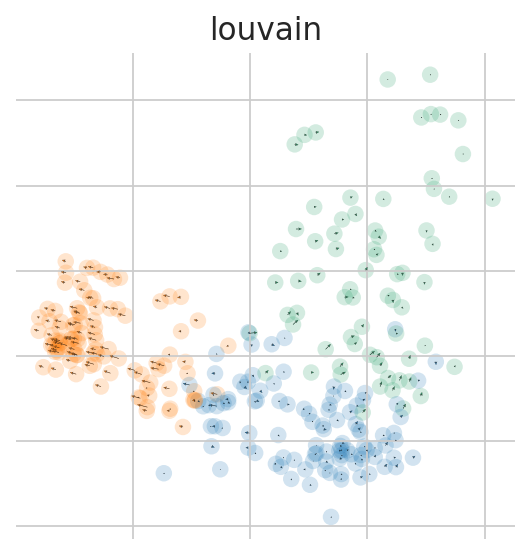

WSSS_PLA8764122


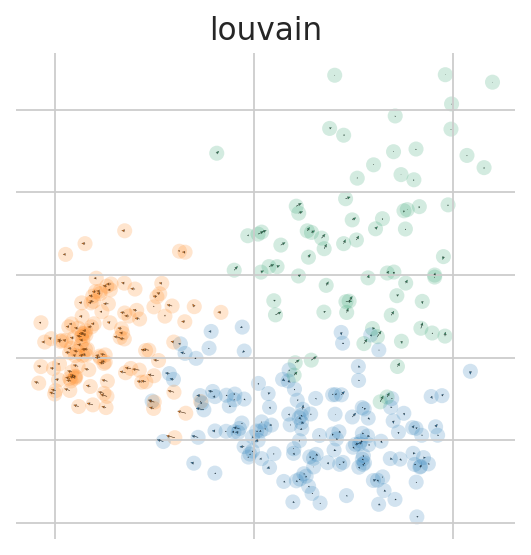

WSSS_PLA8810750


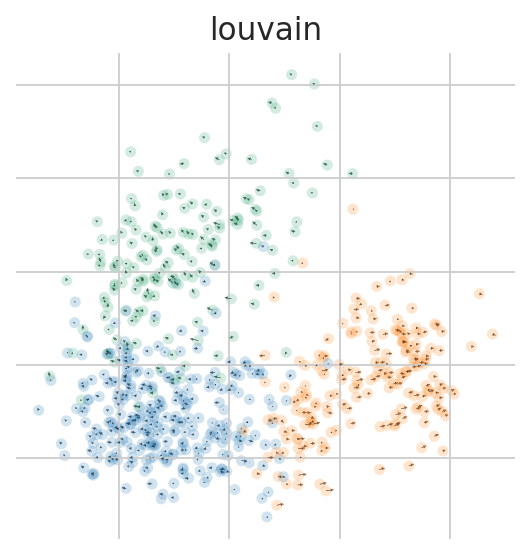

WSSS_PLA8810751


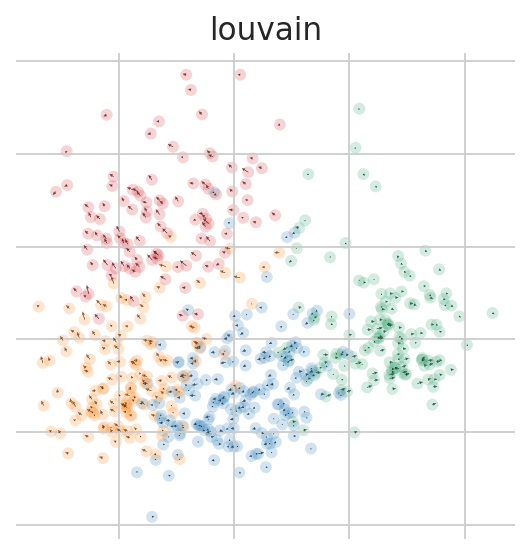

In [72]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding(adatas_loom[sample], basis='pca')

In [73]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.terminal_states(adatas_loom[sample])

WSSS_PLA8764121
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8764122
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810750
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810751
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', 

In [74]:
adatas_loom['WSSS_PLA8764121'].obs.columns

Index(['n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced',
       'initial_size_unspliced', 'initial_size', 'n_counts',
       'velocity_self_transition', 'louvain', 'root_cells', 'end_points'],
      dtype='object')

WSSS_PLA8764121


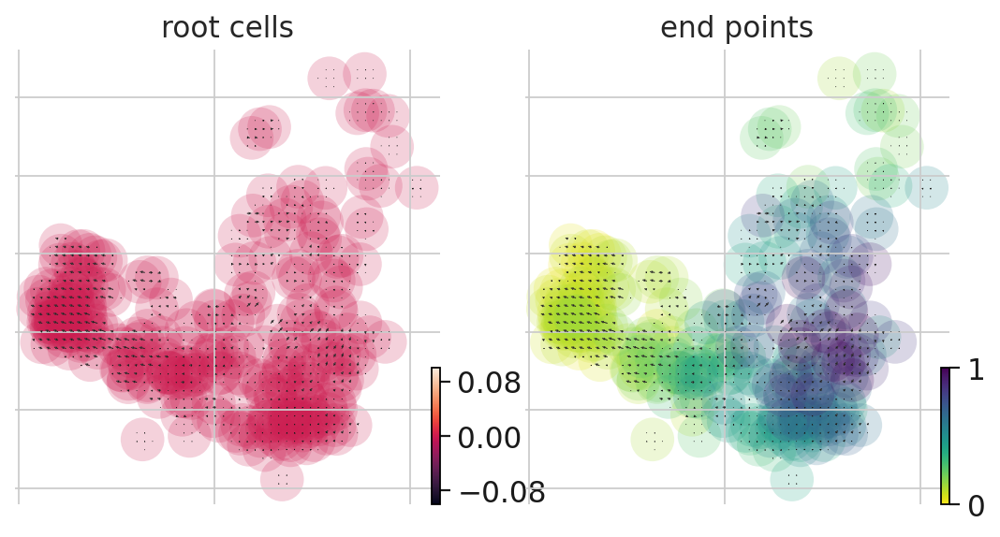

WSSS_PLA8764122


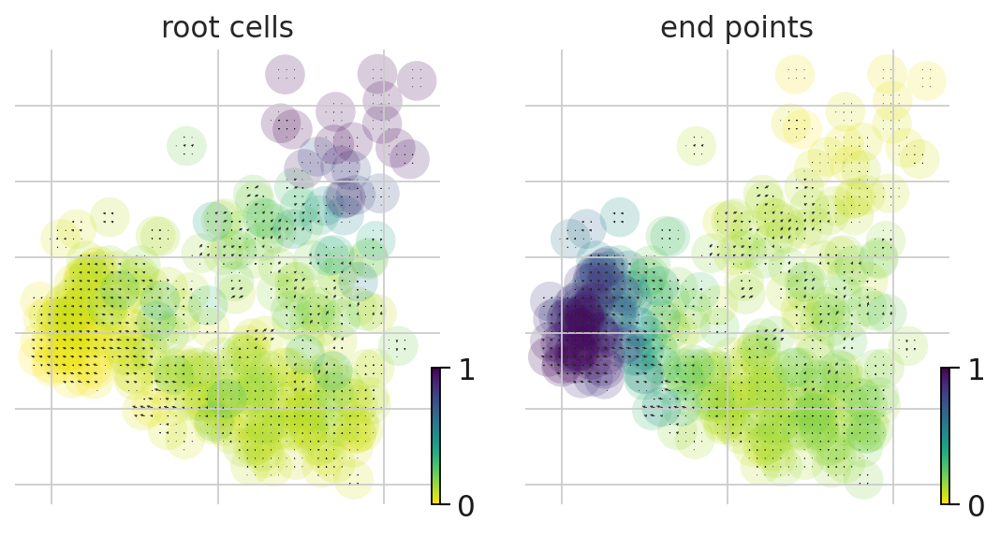

WSSS_PLA8810750


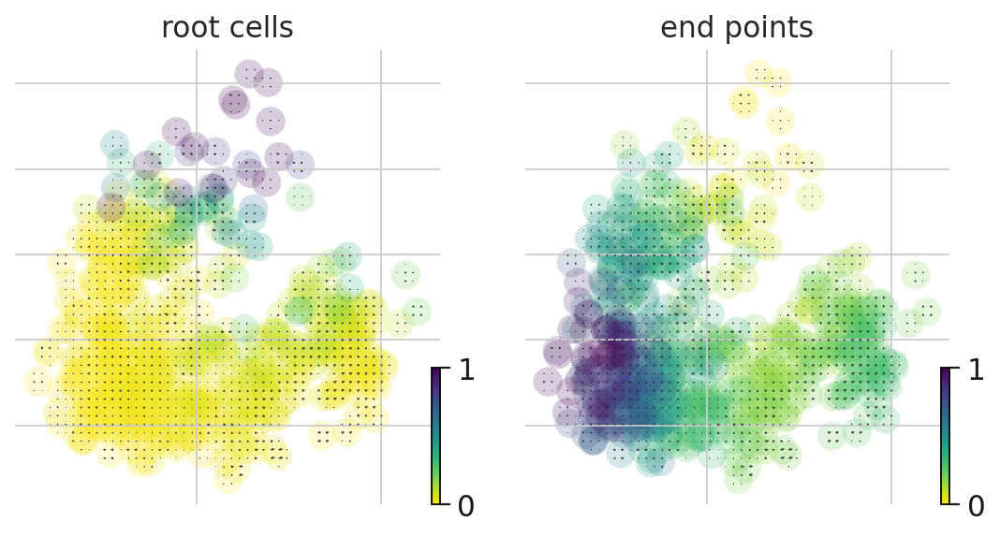

WSSS_PLA8810751


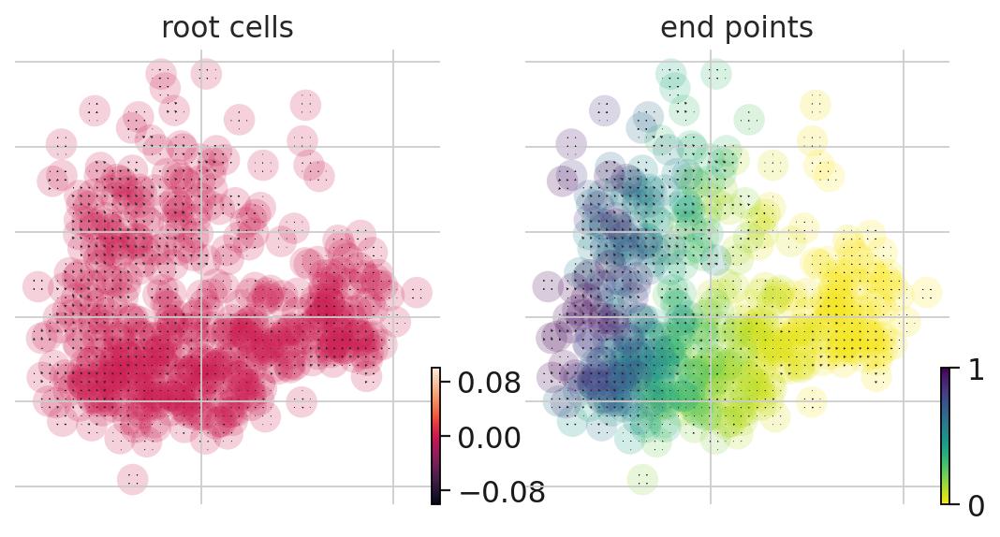

In [75]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='pca', color=['root_cells', 'end_points'])

In [77]:
adata.obs

,n_genes,donor,tissue_block,age,sample,barcode_sample,percent_mito,n_counts,dataset,technique,...,louvain_R_2,prelim_annot_inv_troph,final_annot_inv_troph,root_score_+LGR5_+TP63,root_score_+LGR5_+TP63_-HLA-G_-MKI67,root_argmax_+LGR5_+TP63,root_argmax_+LGR5_+TP63_-HLA-G_-MKI67,rootcell,dpt_pseudotime,palantir_pseudotime
AACAACCAGTCCTGCG-1,2486,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACAACCAGTCCTGCG-1_WSSS_PLA8764121,0.000170,5877.0,snRNA-seq,10X,...,1,inv_troph_3,EVT_3,0.000000,-0.993825,0,0,0,0.736640,0.646171
AACACACCACTGAGGA-1,2081,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACACACCACTGAGGA-1_WSSS_PLA8764121,0.000291,3433.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,0.000000,0.000000,0,0,0,0.229578,0.470050
AACCAACAGGTGGTTG-1,2721,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCAACAGGTGGTTG-1_WSSS_PLA8764121,0.000157,6351.0,snRNA-seq,10X,...,"2,0",VCT_CCC,EVT_1,0.000000,-1.891354,0,0,0,0.258171,0.540808
AACCATGCACTAAACC-1,1718,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCATGCACTAAACC-1_WSSS_PLA8764121,0.000244,4098.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,2.894890,2.894890,0,0,0,0.227170,0.492076
AACCATGTCCAGCACG-1,1489,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCATGTCCAGCACG-1_WSSS_PLA8764121,0.001342,2236.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,1.699694,1.699694,0,0,0,0.219780,0.428034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1,3863,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTACTGCATTGTAGC-1_WSSS_PLA8810751,0.000334,11983.0,snRNA-seq,10X,...,1,inv_troph_3,EVT_3,0.606780,-1.036591,0,0,0,0.720896,0.625391
TTTACTGTCTGCATGA-1,2917,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTACTGTCTGCATGA-1_WSSS_PLA8810751,0.001026,6823.0,snRNA-seq,10X,...,4,inv_troph_4,EVT_2,0.000000,0.000000,0,0,0,0.550102,0.612573
TTTATGCCAGATACCT-1,2361,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTATGCCAGATACCT-1_WSSS_PLA8810751,0.001711,5259.0,snRNA-seq,10X,...,4,inv_troph_4,EVT_2,0.000000,-1.569242,0,0,0,0.651858,0.690932
TTTGACTCAGGAATAT-1,3547,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTGACTCAGGAATAT-1_WSSS_PLA8810751,0.000207,9681.0,snRNA-seq,10X,...,4,inv_troph_3,EVT_2,0.000000,-0.709489,0,0,0,0.634959,0.725957


In [78]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adata_subset = adata[adata.obs['sample'] == sample]
    adata_subset.obs_names = adata_subset.obs['barcode_sample']
    adata_subset.obs.set_index('barcode_sample', inplace=True)
    adatas_loom[sample].obsm['X_umap'] = adata_subset.obsm['X_umap']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [79]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='umap')

WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8764122
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8810750
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


In [80]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.terminal_states(adatas_loom[sample])

WSSS_PLA8764121
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8764122
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810750
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810751
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', 

WSSS_PLA8764121


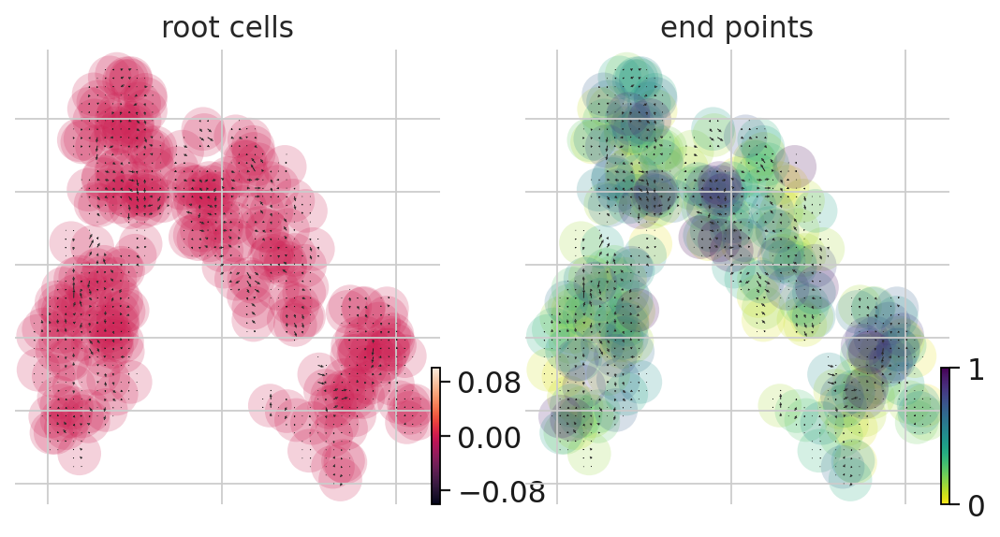

WSSS_PLA8764122


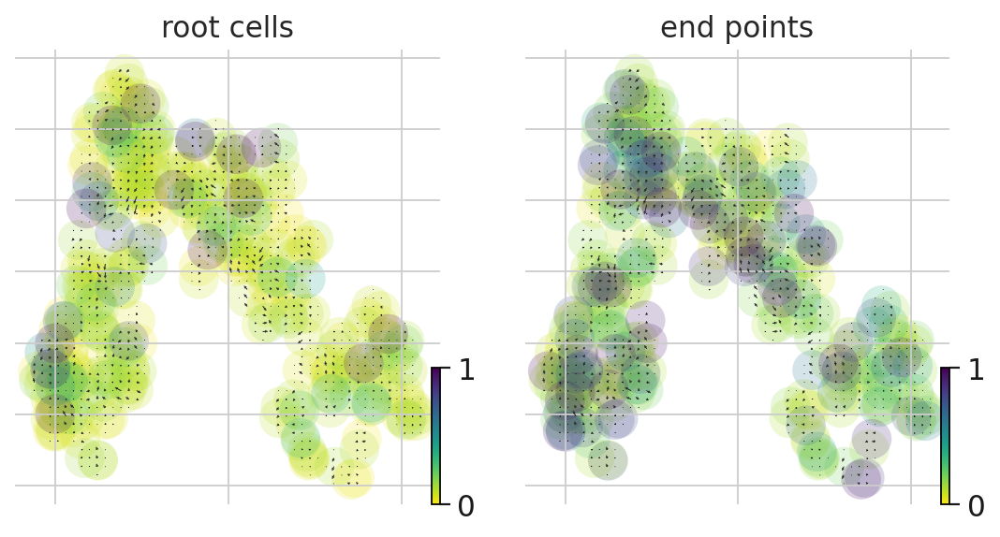

WSSS_PLA8810750


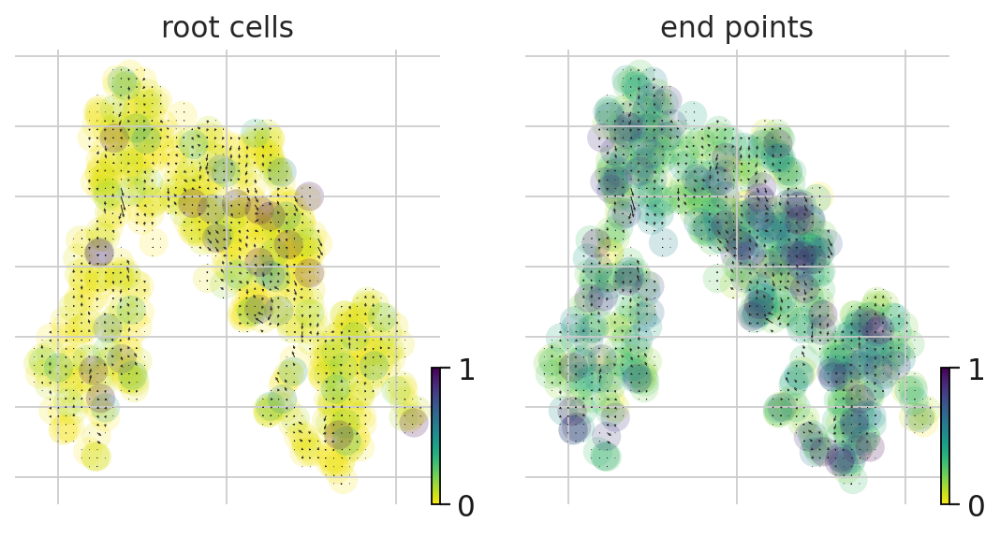

WSSS_PLA8810751


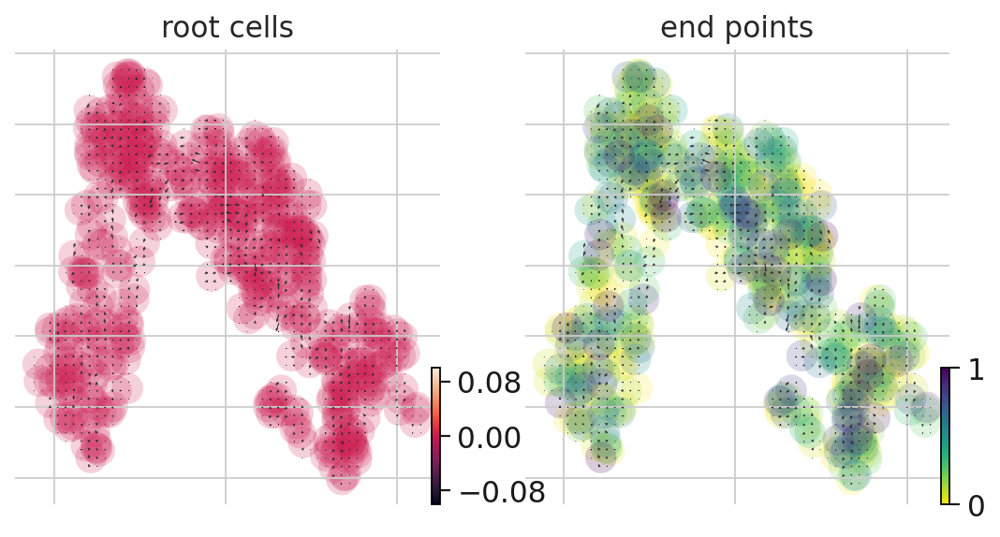

In [81]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='umap', color=['root_cells', 'end_points'])

In [82]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.umap(adatas_loom[sample])

computing UMAP


WSSS_PLA8764121


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8764122


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8810750


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8810751


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


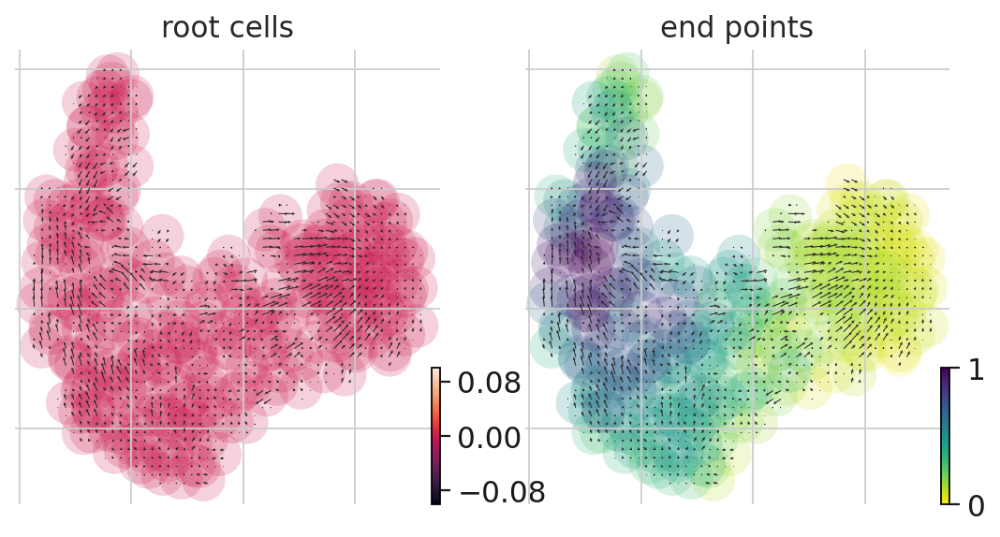

WSSS_PLA8764122
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


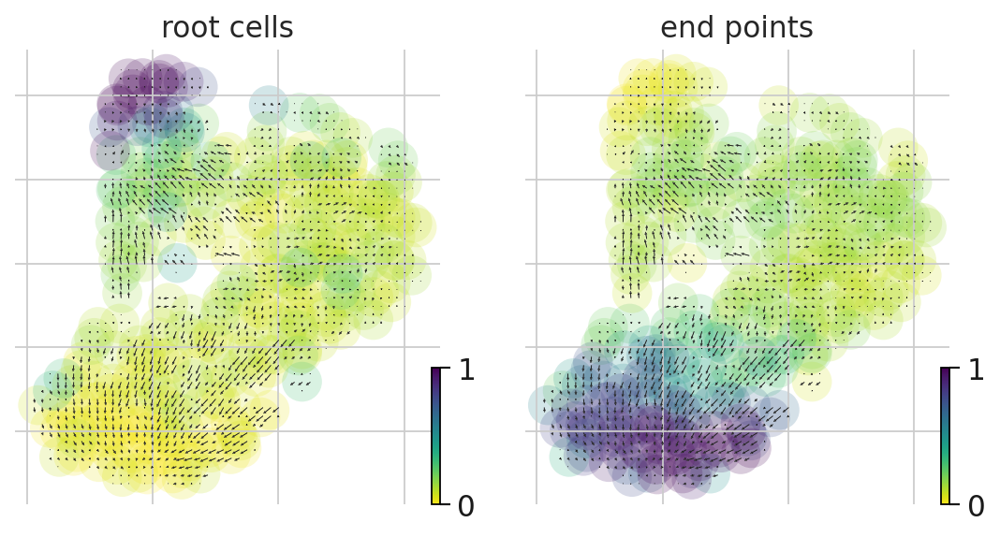

WSSS_PLA8810750
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


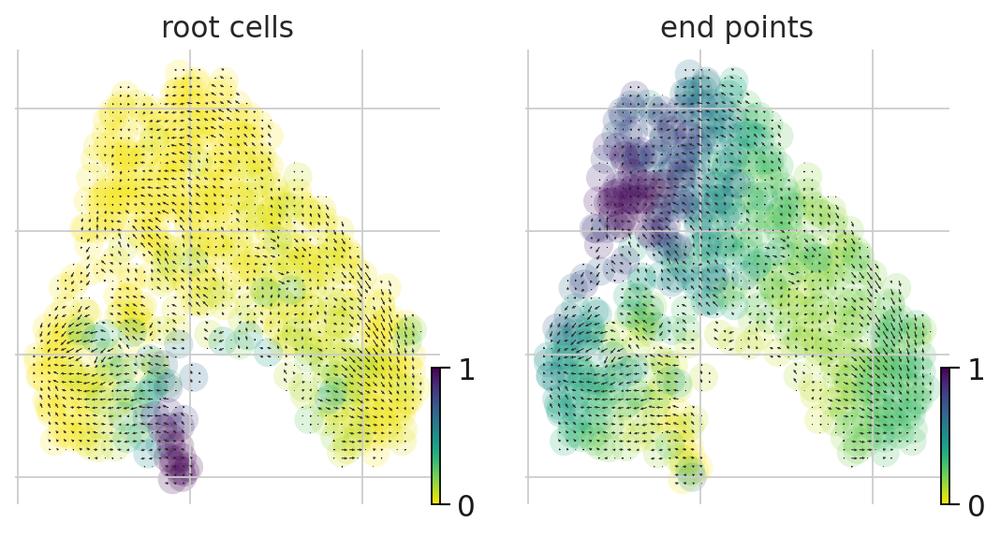

WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


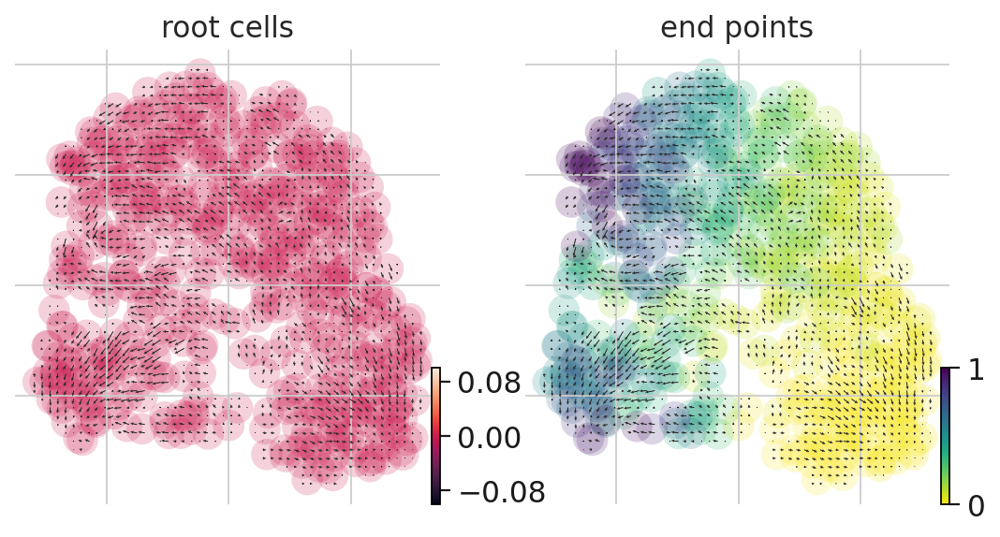

In [83]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='umap')
    scv.tl.terminal_states(adatas_loom[sample])
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='umap', color=['root_cells', 'end_points'])

In [84]:
adatas_loom['WSSS_PLA8764121'].obs

,n_counts_spliced,n_counts_unspliced,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,louvain,root_cells,end_points
barcode_sample_sn_like,,,,,,,,,,
CTGCCTATCGCTTTAT-1_WSSS_PLA8764121,761,1946,761,1946,761.0,461.181396,0.133594,1,0.0,0.079398
TAACTTCGTCTACGTA-1_WSSS_PLA8764121,1225,4543,1225,4543,1225.0,509.385712,0.178845,0,0.0,0.628789
ACGCACGTCGATTGAC-1_WSSS_PLA8764121,1017,5455,1017,5455,1017.0,512.032410,0.120321,0,0.0,0.428508
TGGATGTGTGCACAAG-1_WSSS_PLA8764121,561,2329,561,2329,561.0,447.176483,0.101185,1,0.0,0.130645
CAACGATTCCTCTCGA-1_WSSS_PLA8764121,530,1415,530,1415,530.0,504.409485,0.085015,2,0.0,0.421365
...,...,...,...,...,...,...,...,...,...,...
CAGGTATTCACTAGCA-1_WSSS_PLA8764121,812,4277,812,4277,812.0,503.991364,0.142940,0,0.0,0.794199
TCTTTGATCTCTGACC-1_WSSS_PLA8764121,534,1963,534,1963,534.0,438.942017,0.175929,1,0.0,0.078637
CACTGAATCGCTCTCA-1_WSSS_PLA8764121,518,1728,518,1728,518.0,496.527069,0.274078,2,0.0,0.767688


In [86]:
adata.obs_names = adata.obs['barcode_sample']
adata.obs.set_index('barcode_sample', inplace=True)

In [90]:
adata.obs['root_cells_velocyto'] = [0 for i in range(len(adata.obs))]
adata.obs['end_points_velocyto'] = [0 for i in range(len(adata.obs))]

In [91]:
# smth wrong with this code
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adata[adata.obs['sample'] == sample].obs.loc[adatas_loom[sample].obs_names,'root_cells_velocyto'] = list(adatas_loom[sample].obs['root_cells'])
    adata[adata.obs['sample'] == sample].obs.loc[adatas_loom[sample].obs_names,'end_points_velocyto'] = list(adatas_loom[sample].obs['end_points'])


WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


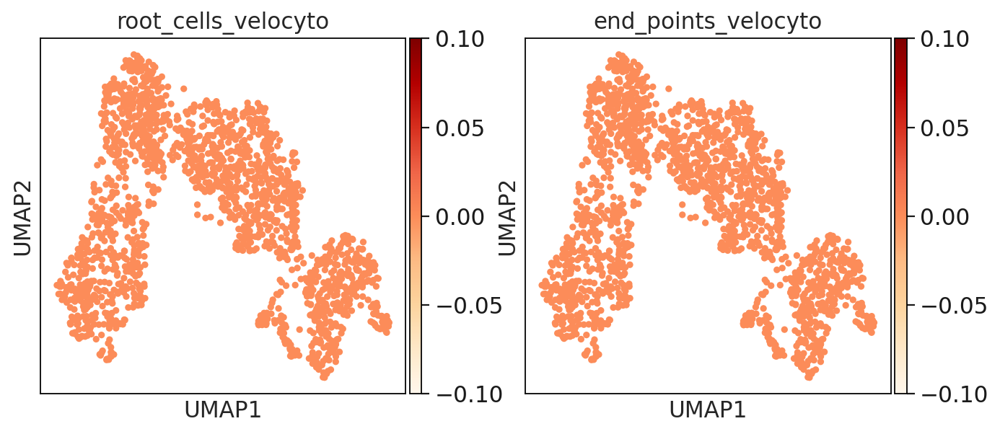

In [92]:
# this is wrong
sc.pl.umap(adata, color=['root_cells_velocyto','end_points_velocyto'], cmap='OrRd')

In [149]:
adata_loom.obs

,n_counts_spliced,n_counts_unspliced,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,louvain,root_cells,end_points
barcode_sample_sn_like,,,,,,,,,,
AACAACCAGTCCTGCG-1_WSSS_PLA8764121,708,4643,708,4643,708.0,862.067810,0.077434,2,0.0,0.361075
AACACACCACTGAGGA-1_WSSS_PLA8764121,538,2588,538,2588,538.0,844.293579,0.348836,4,0.0,0.379664
AACCAACAGGTGGTTG-1_WSSS_PLA8764121,919,4928,919,4928,919.0,856.087036,0.131639,2,0.0,0.123704
AACCATGCACTAAACC-1_WSSS_PLA8764121,514,3316,514,3316,514.0,847.681030,0.246179,4,0.0,0.245112
AACCATGTCCAGCACG-1_WSSS_PLA8764121,344,1709,344,1709,344.0,838.412842,0.176096,4,0.0,0.264425
...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1_WSSS_PLA8810751,1903,9059,1903,9059,1903.0,866.705200,0.215555,0,0.0,0.771966
TTTACTGTCTGCATGA-1_WSSS_PLA8810751,1007,5238,1007,5238,1007.0,853.096313,0.088361,0,0.0,0.120079
TTTATGCCAGATACCT-1_WSSS_PLA8810751,784,4088,784,4088,784.0,869.625000,0.090821,0,0.0,0.094314


WSSS_PLA8764121


findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.


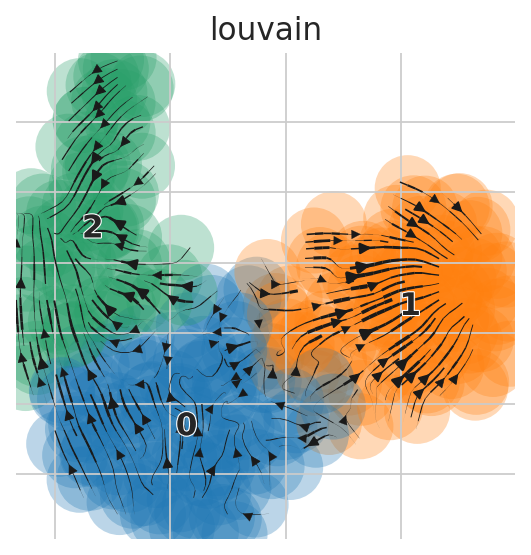

WSSS_PLA8764122


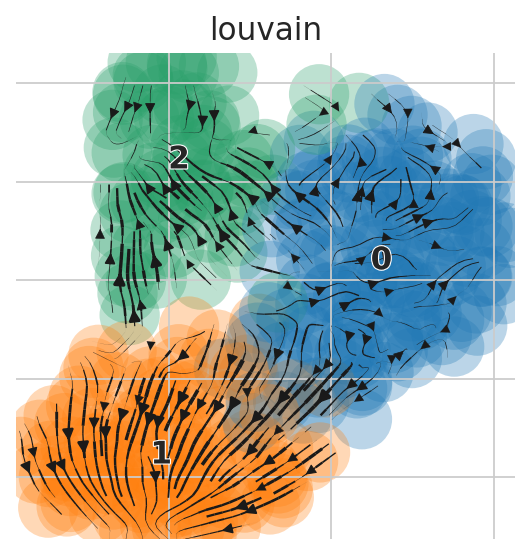

WSSS_PLA8810750


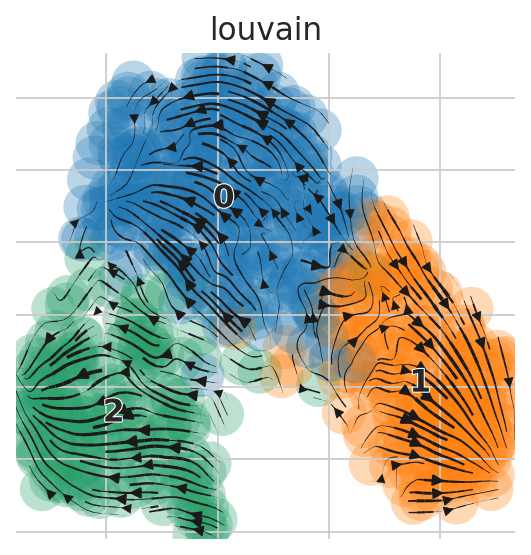

WSSS_PLA8810751


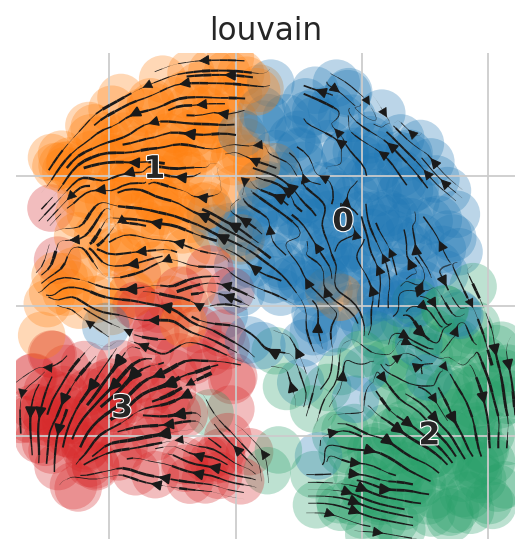

In [93]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_stream(adatas_loom[sample], basis='umap')


In [94]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 2954
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points'
    var: 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'louvain', 'louvain_colors', 'umap'
    obsm: 'X_pca', 'velocity_pca', 'X_umap', 'velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

WSSS_PLA8764121


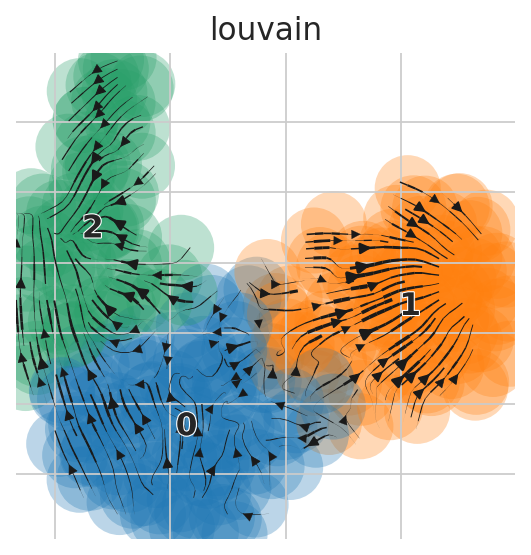

WSSS_PLA8764122


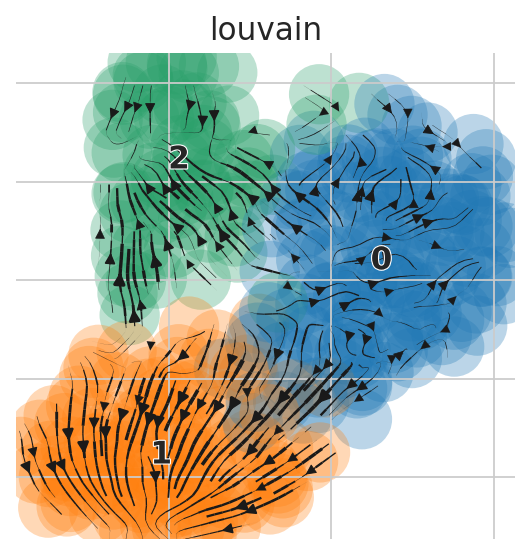

WSSS_PLA8810750


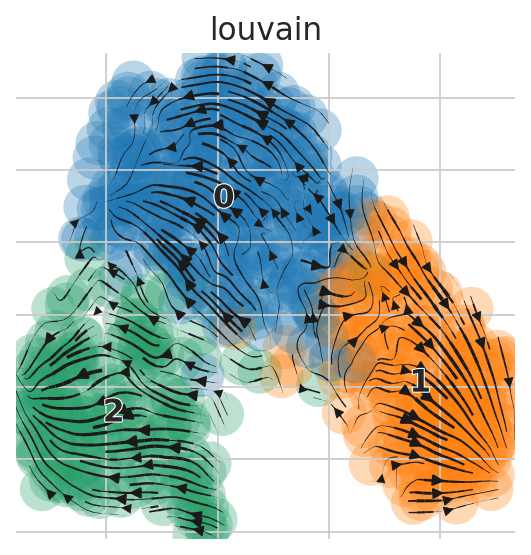

WSSS_PLA8810751


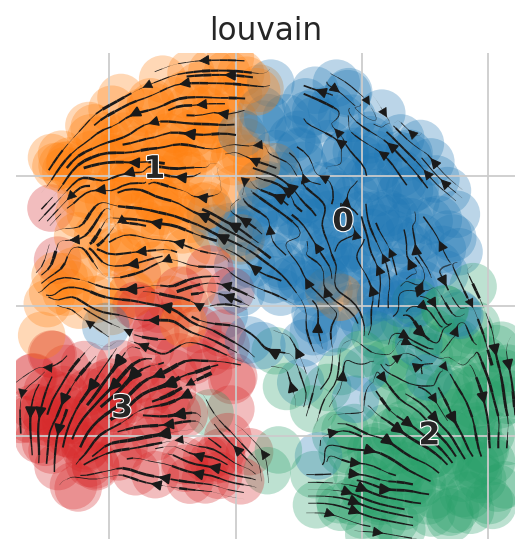

In [95]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_stream(adatas_loom[sample], basis='X_umap')


In [98]:
adata.obs

,n_genes,donor,tissue_block,age,sample,percent_mito,n_counts,dataset,technique,scrublet_score,...,root_score_+LGR5_+TP63,root_score_+LGR5_+TP63_-HLA-G_-MKI67,root_argmax_+LGR5_+TP63,root_argmax_+LGR5_+TP63_-HLA-G_-MKI67,rootcell,dpt_pseudotime,palantir_pseudotime,root_cells_velocyto,end_points,end_points_velocyto
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AACAACCAGTCCTGCG-1_WSSS_PLA8764121,2486,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000170,5877.0,snRNA-seq,10X,0.068493,...,0.000000,-0.993825,0,0,0,0.736640,0.646171,0,0,0
AACACACCACTGAGGA-1_WSSS_PLA8764121,2081,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000291,3433.0,snRNA-seq,10X,0.070162,...,0.000000,0.000000,0,0,0,0.229578,0.470050,0,0,0
AACCAACAGGTGGTTG-1_WSSS_PLA8764121,2721,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000157,6351.0,snRNA-seq,10X,0.107143,...,0.000000,-1.891354,0,0,0,0.258171,0.540808,0,0,0
AACCATGCACTAAACC-1_WSSS_PLA8764121,1718,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000244,4098.0,snRNA-seq,10X,0.068493,...,2.894890,2.894890,0,0,0,0.227170,0.492076,0,0,0
AACCATGTCCAGCACG-1_WSSS_PLA8764121,1489,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.001342,2236.0,snRNA-seq,10X,0.062229,...,1.699694,1.699694,0,0,0,0.219780,0.428034,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1_WSSS_PLA8810751,3863,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.000334,11983.0,snRNA-seq,10X,0.025431,...,0.606780,-1.036591,0,0,0,0.720896,0.625391,0,0,0
TTTACTGTCTGCATGA-1_WSSS_PLA8810751,2917,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.001026,6823.0,snRNA-seq,10X,0.030408,...,0.000000,0.000000,0,0,0,0.550102,0.612573,0,0,0
TTTATGCCAGATACCT-1_WSSS_PLA8810751,2361,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.001711,5259.0,snRNA-seq,10X,0.022047,...,0.000000,-1.569242,0,0,0,0.651858,0.690932,0,0,0


In [99]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['cell_type'] = adata.obs.loc[adatas_loom[sample].obs_names,'final_annot_inv_troph']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


WSSS_PLA8764121


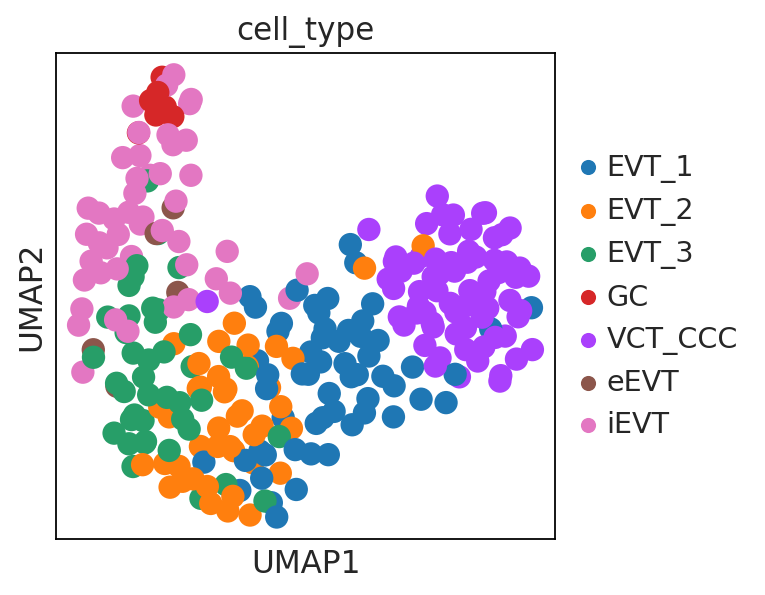

WSSS_PLA8764122


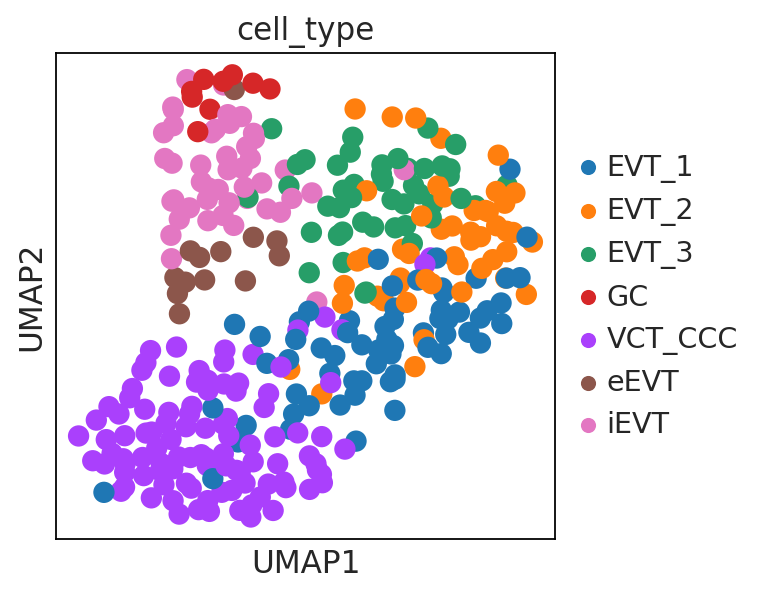

WSSS_PLA8810750


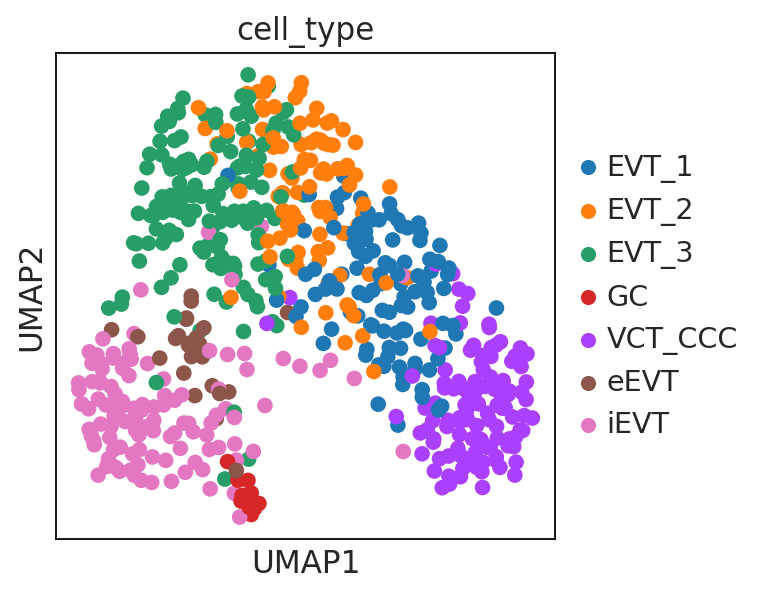

WSSS_PLA8810751


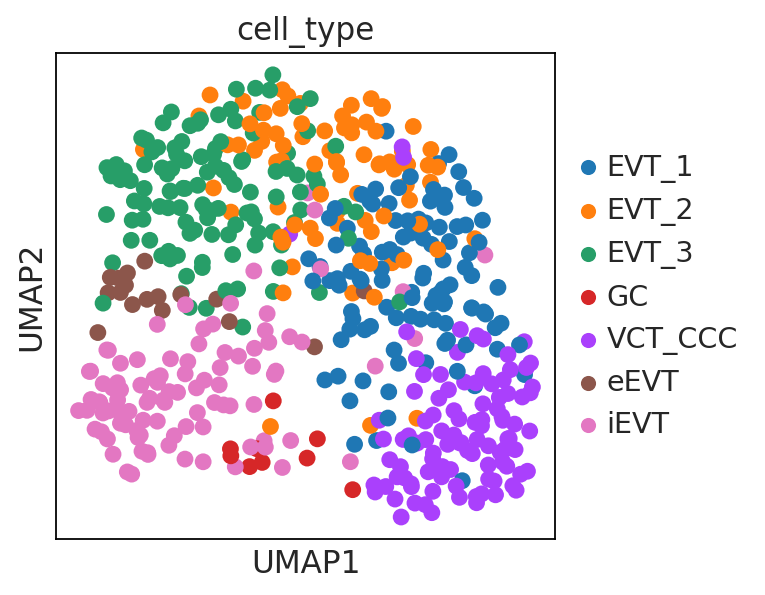

In [100]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    sc.pl.umap(adatas_loom[sample], color='cell_type')

In [101]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['sample'] = adata.obs.loc[adatas_loom[sample].obs_names,'sample']
    adatas_loom[sample].obs['tissue_block'] = adata.obs.loc[adatas_loom[sample].obs_names,'tissue_block']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


WSSS_PLA8764121


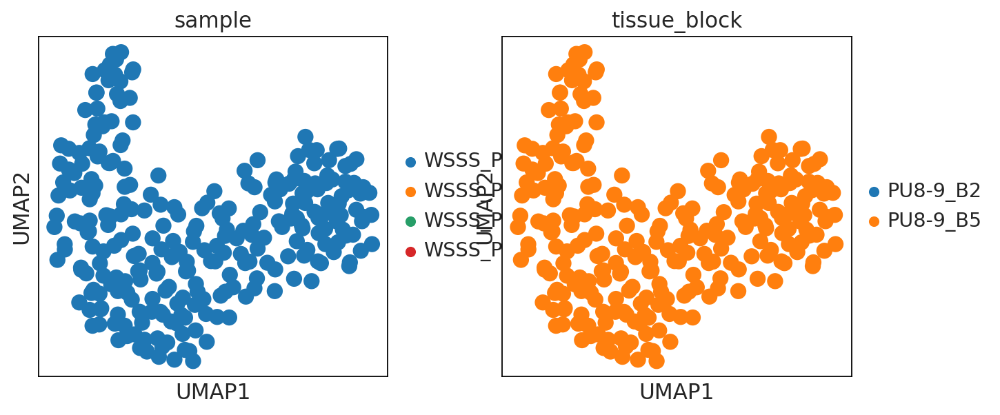

WSSS_PLA8764122


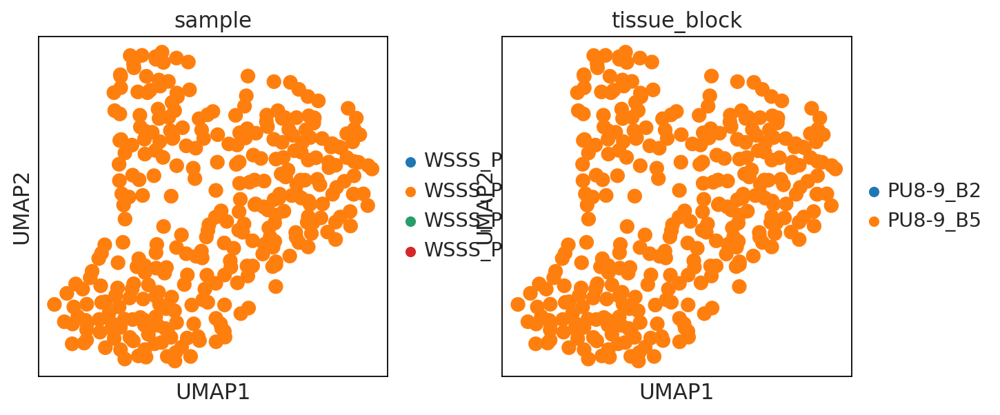

WSSS_PLA8810750


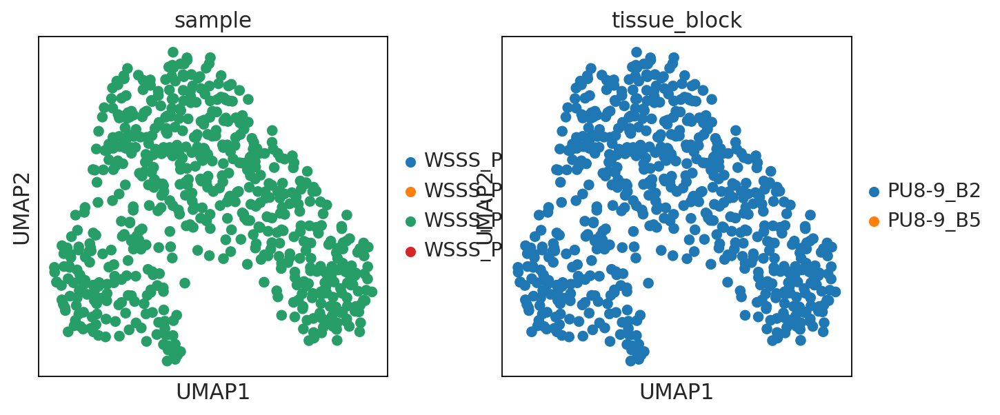

WSSS_PLA8810751


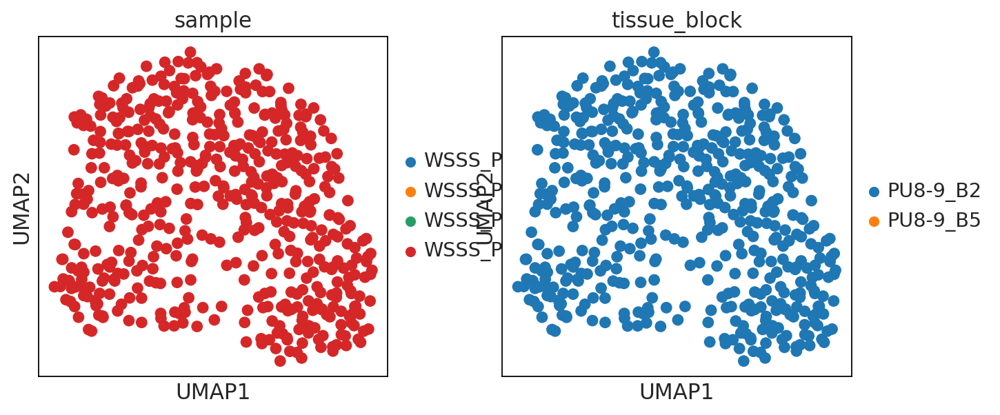

In [102]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    sc.pl.umap(adatas_loom[sample], color=['sample','tissue_block'])

# take away: vaguely the branching point of EVT_3 is somewhat there, but velocities are quite messy

# what if I try to use only (a) filtered genes [around 20K] or (b) only HVGs?

Trying below

In [103]:
%%time
# takes about 25 minutes, but later faster
adatas_loom = {}

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample] = scv.read(save_path + '20210423_velocyto_donor_P13_sample_' + sample + '.loom', cache=True)

... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8764121.h5ad


WSSS_PLA8764121


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8764122.h5ad


WSSS_PLA8764122


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8810750.h5ad


WSSS_PLA8810750


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8810751.h5ad


WSSS_PLA8810751


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


CPU times: user 11.2 s, sys: 1.46 s, total: 12.7 s
Wall time: 12.7 s


In [104]:
adatas_loom

{'WSSS_PLA8764121': AnnData object with n_obs × n_vars = 85256 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced',
 'WSSS_PLA8764122': AnnData object with n_obs × n_vars = 81782 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced',
 'WSSS_PLA8810750': AnnData object with n_obs × n_vars = 84598 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced',
 'WSSS_PLA8810751': AnnData object with n_obs × n_vars = 71733 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'}

In [105]:
adatas_loom['WSSS_PLA8764121'].obs.head()

""
possorted_genome_bam_7ZNK7:AAACCCAAGATCACCT
possorted_genome_bam_7ZNK7:AAACCCAAGATCGCTT
possorted_genome_bam_7ZNK7:AAACCCAAGATACATG
possorted_genome_bam_7ZNK7:AAACCCAAGATTGCGG
possorted_genome_bam_7ZNK7:AAACCCAAGACGCTCC


In [106]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime', 'root_cells_velocyto', 'end_points', 'end_points_velocyto'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3',

In [107]:
len(adata.obs_names)

1729

In [108]:
adatas_loom['WSSS_PLA8764121'].obs_names

Index(['possorted_genome_bam_7ZNK7:AAACCCAAGATCACCT',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATCGCTT',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATACATG',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATTGCGG',
       'possorted_genome_bam_7ZNK7:AAACCCAAGACGCTCC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGAGTCAGC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGAGGATCC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCTCACTA',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCGTGCTC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCGGTAGT',
       ...
       'possorted_genome_bam_7ZNK7:TTTGTTGTCCTTTGAT',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCCGTAATG',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCGGACTGC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTCCGCAT',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTGCTAGA',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACGGGC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACCCAC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACAGGT',
       'possorted

In [109]:
# dict of bam names to sample names
bam2sample = {}

bam2sample['possorted_genome_bam_7ZNK7'] = 'WSSS_PLA8764121'
bam2sample['possorted_genome_bam_V4O8B'] = 'WSSS_PLA8764122'
bam2sample['possorted_genome_bam_PSPJC'] = 'WSSS_PLA8810750'
bam2sample['possorted_genome_bam_T8XDM'] = 'WSSS_PLA8810751'



In [113]:
for barcode_sample in list(adata.obs['barcode_sample']):
    if '-1' not in barcode_sample:
        print(barcode_sample)

In [114]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 85256 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [115]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [116]:
# getting from the indices above to the ones in adata.obs['barcode_sample']

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['barcode_sample_sn_like'] = [elem.split(':')[1] + '-1_' + bam2sample[elem.split(':')[0]] for elem in adatas_loom[sample].obs_names]

    adatas_loom[sample].obs.set_index('barcode_sample_sn_like', inplace=True)
    

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [117]:
adatas_loom['WSSS_PLA8764121'].obs

""
barcode_sample_sn_like
AAACCCAAGATCACCT-1_WSSS_PLA8764121
AAACCCAAGATCGCTT-1_WSSS_PLA8764121
AAACCCAAGATACATG-1_WSSS_PLA8764121
AAACCCAAGATTGCGG-1_WSSS_PLA8764121
AAACCCAAGACGCTCC-1_WSSS_PLA8764121
...
TTTGTTGTCTACGGGC-1_WSSS_PLA8764121
TTTGTTGTCTACCCAC-1_WSSS_PLA8764121
TTTGTTGTCTACAGGT-1_WSSS_PLA8764121


In [118]:
#adata_loom.obs_names = [i.split(':')[1] for i in adata_loom.obs_names]

In [119]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs_names_make_unique()

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [120]:
adatas_loom['WSSS_PLA8764121'].obs_names

Index(['AAACCCAAGATCACCT-1_WSSS_PLA8764121',
       'AAACCCAAGATCGCTT-1_WSSS_PLA8764121',
       'AAACCCAAGATACATG-1_WSSS_PLA8764121',
       'AAACCCAAGATTGCGG-1_WSSS_PLA8764121',
       'AAACCCAAGACGCTCC-1_WSSS_PLA8764121',
       'AAACCCAAGAGTCAGC-1_WSSS_PLA8764121',
       'AAACCCAAGAGGATCC-1_WSSS_PLA8764121',
       'AAACCCAAGCTCACTA-1_WSSS_PLA8764121',
       'AAACCCAAGCGTGCTC-1_WSSS_PLA8764121',
       'AAACCCAAGCGGTAGT-1_WSSS_PLA8764121',
       ...
       'TTTGTTGTCCTTTGAT-1_WSSS_PLA8764121',
       'TTTGTTGTCCGTAATG-1_WSSS_PLA8764121',
       'TTTGTTGTCGGACTGC-1_WSSS_PLA8764121',
       'TTTGTTGTCTCCGCAT-1_WSSS_PLA8764121',
       'TTTGTTGTCTGCTAGA-1_WSSS_PLA8764121',
       'TTTGTTGTCTACGGGC-1_WSSS_PLA8764121',
       'TTTGTTGTCTACCCAC-1_WSSS_PLA8764121',
       'TTTGTTGTCTACAGGT-1_WSSS_PLA8764121',
       'TTTGTTGTCGGTGTAT-1_WSSS_PLA8764121',
       'TTTGTTGTCTTGTTAC-1_WSSS_PLA8764121'],
      dtype='object', name='barcode_sample_sn_like', length=85256)

In [121]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['WSSS_PLA8764121', 'WSSS_PLA8764122', 'WSSS_PLA8810750',
        'WSSS_PLA8810751'], dtype=object),
 array([272, 326, 606, 525]))

In [122]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [129]:
adata.raw.var_names

Index(['A1BG', 'A1BG-AS1', 'A1CF', 'A2M', 'A2M-AS1', 'A2ML1', 'A2ML1-AS1',
       'A3GALT2', 'A4GALT', 'A4GNT',
       ...
       'ZW10', 'ZWILCH', 'ZWINT', 'ZXDA', 'ZXDB', 'ZXDC', 'ZYG11A', 'ZYG11B',
       'ZYX', 'ZZEF1'],
      dtype='object', length=27605)

In [128]:
# full version of adata - with all genes, only norm and log tr
adata_full = anndata.AnnData(X = adata.raw.X,
                             obs = adata.obs,
                             var = adata.raw.var)


In [131]:
adata_full.var_names_make_unique()

In [134]:
len(list(adata_full.var_names))

27605

In [135]:
len(set(adata_full.var_names))

27605

In [141]:
# subsetting to only final cells and only all genes in raw (27605 filtered genes)

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    curr_overlap = set(adata.obs['barcode_sample']) & set(adatas_loom[sample].obs_names)
    #print('curr_overlap', list(curr_overlap)[:5])
    adatas_loom[sample] = adatas_loom[sample][list(curr_overlap),:].copy()
    
    adatas_loom[sample].var_names_make_unique()
    adatas_loom[sample].obs_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [142]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample] = adatas_loom[sample][:,list(adata_full.var_names)].copy()

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [143]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 27605
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [144]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.show_proportions(adatas_loom[sample])
    scv.pp.cleanup(adatas_loom[sample], clean='all')

WSSS_PLA8764121
Abundance of ['spliced', 'unspliced']: [0.19 0.81]
WSSS_PLA8764122
Abundance of ['spliced', 'unspliced']: [0.19 0.81]
WSSS_PLA8810750
Abundance of ['spliced', 'unspliced']: [0.2 0.8]
WSSS_PLA8810751
Abundance of ['spliced', 'unspliced']: [0.19 0.81]


In [145]:
adatas_loom['WSSS_PLA8764121'].layers['spliced']

<272x27605 sparse matrix of type '<class 'numpy.uint32'>'
	with 164652 stored elements in Compressed Sparse Row format>

In [146]:
adatas_loom['WSSS_PLA8764121'].layers['unspliced']

<272x27605 sparse matrix of type '<class 'numpy.uint32'>'
	with 474679 stored elements in Compressed Sparse Row format>

In [147]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 27605
    layers: 'spliced', 'unspliced'

In [148]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['n_counts_spliced'] = adatas_loom[sample].layers['spliced'].sum(1)
    adatas_loom[sample].obs['n_counts_unspliced'] = adatas_loom[sample].layers['unspliced'].sum(1)

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [149]:
np.unique(adatas_loom['WSSS_PLA8764121'].obs['n_counts_spliced'])

array([  165,   168,   172,   176,   195,   201,   211,   224,   236,
         237,   238,   241,   242,   245,   249,   254,   265,   268,
         285,   290,   299,   302,   305,   306,   309,   310,   321,
         326,   332,   334,   340,   344,   363,   374,   375,   387,
         392,   393,   394,   396,   402,   403,   405,   408,   411,
         413,   414,   417,   421,   428,   440,   442,   445,   446,
         447,   449,   450,   452,   454,   455,   457,   461,   466,
         468,   470,   471,   475,   478,   479,   480,   484,   486,
         487,   489,   493,   503,   504,   506,   509,   511,   512,
         514,   517,   518,   525,   528,   530,   531,   532,   534,
         536,   538,   542,   544,   547,   549,   554,   561,   568,
         569,   571,   577,   578,   583,   584,   585,   595,   597,
         598,   602,   607,   608,   610,   620,   623,   630,   631,
         632,   635,   639,   643,   649,   651,   652,   659,   662,
         668,   669,

In [150]:
np.unique(adatas_loom['WSSS_PLA8764121'].obs['n_counts_unspliced'])

array([  334,   501,   555,   635,   713,   758,   786,   848,   850,
         873,   881,   882,   908,   924,   945,   965,   971,   973,
         975,  1018,  1027,  1057,  1059,  1071,  1077,  1129,  1133,
        1135,  1157,  1163,  1239,  1292,  1303,  1343,  1355,  1359,
        1364,  1379,  1391,  1393,  1414,  1423,  1428,  1437,  1438,
        1446,  1476,  1491,  1525,  1556,  1577,  1646,  1706,  1708,
        1726,  1727,  1746,  1748,  1752,  1765,  1784,  1818,  1821,
        1832,  1852,  1903,  1944,  1961,  1968,  1976,  1984,  2021,
        2070,  2073,  2123,  2181,  2211,  2230,  2231,  2238,  2243,
        2256,  2259,  2268,  2278,  2297,  2317,  2328,  2346,  2348,
        2360,  2365,  2367,  2380,  2387,  2409,  2418,  2441,  2446,
        2471,  2526,  2583,  2587,  2610,  2645,  2673,  2740,  2751,
        2771,  2809,  2821,  2830,  2842,  2843,  2848,  2876,  2883,
        2901,  2911,  2934,  2951,  2963,  2973,  2981,  2994,  3017,
        3019,  3025,

In [151]:
#adata_loom.var_names_make_unique()

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.filter_and_normalize(adatas_loom[sample], min_counts=20, 
                            #min_counts_u=10, 
                            n_top_genes=4000)

WSSS_PLA8764121
Filtered out 24651 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
WSSS_PLA8764122
Filtered out 23537 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
WSSS_PLA8810750
Filtered out 21553 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.
WSSS_PLA8810751
Filtered out 21561 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Extracted 4000 highly variable genes.
Logarithmized X.


In [152]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 2954
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    layers: 'spliced', 'unspliced'

In [153]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.moments(adatas_loom[sample])

computing PCA
    with n_comps=30
    finished (0:00:00)


WSSS_PLA8764121
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities


computing PCA
    on highly variable genes
    with n_comps=30


    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8764122


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities


computing PCA
    on highly variable genes
    with n_comps=30


    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8810750


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities


computing PCA
    on highly variable genes
    with n_comps=30


    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8810751


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [154]:
%%time

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity(adatas_loom[sample])
    scv.tl.velocity_graph(adatas_loom[sample])

WSSS_PLA8764121
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8764122
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8810750
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8810751
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
   

In [155]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.louvain(adatas_loom[sample], resolution=0.6)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='pca')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8764122
computing velocity embedding


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8810750
computing velocity embedding


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


WSSS_PLA8764121


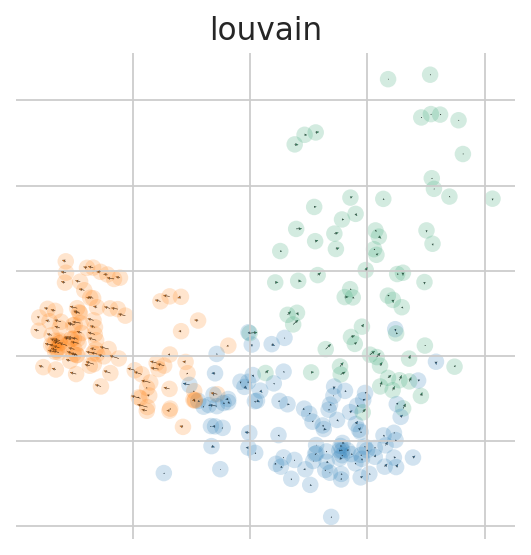

WSSS_PLA8764122


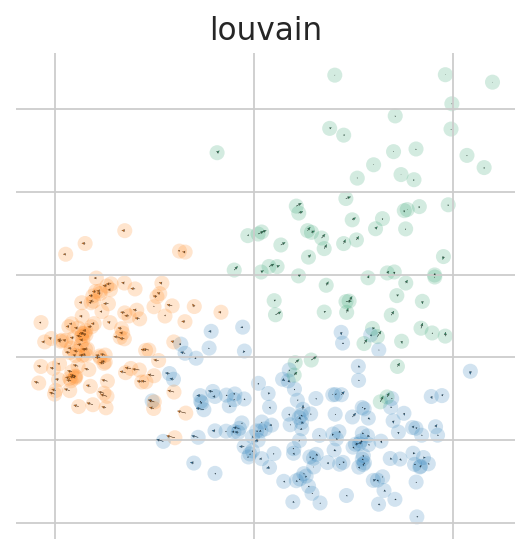

WSSS_PLA8810750


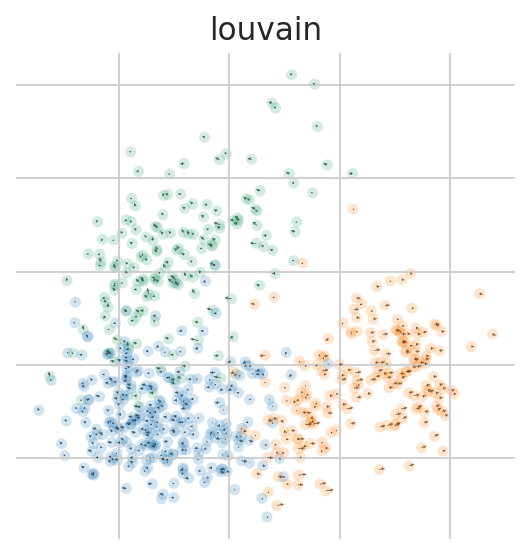

WSSS_PLA8810751


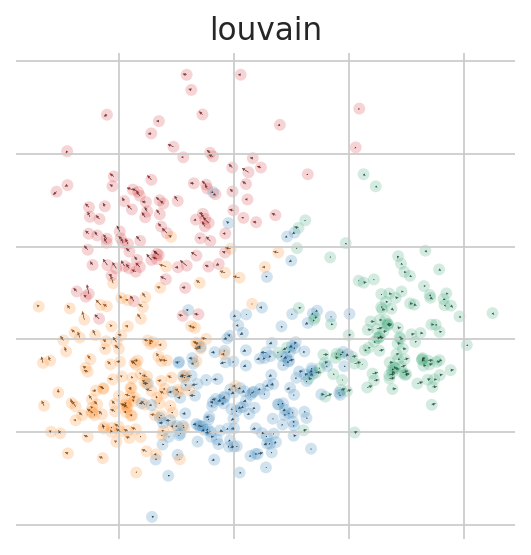

In [156]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding(adatas_loom[sample], basis='pca')

In [157]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.terminal_states(adatas_loom[sample])

WSSS_PLA8764121
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8764122
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810750
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810751
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', 

In [158]:
adatas_loom['WSSS_PLA8764121'].obs.columns

Index(['n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced',
       'initial_size_unspliced', 'initial_size', 'n_counts',
       'velocity_self_transition', 'louvain', 'root_cells', 'end_points'],
      dtype='object')

WSSS_PLA8764121


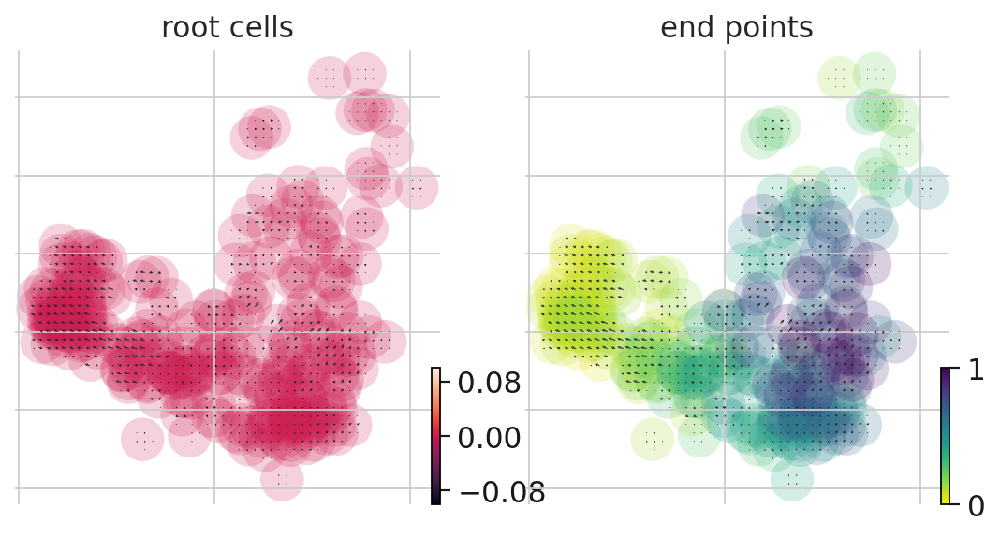

WSSS_PLA8764122


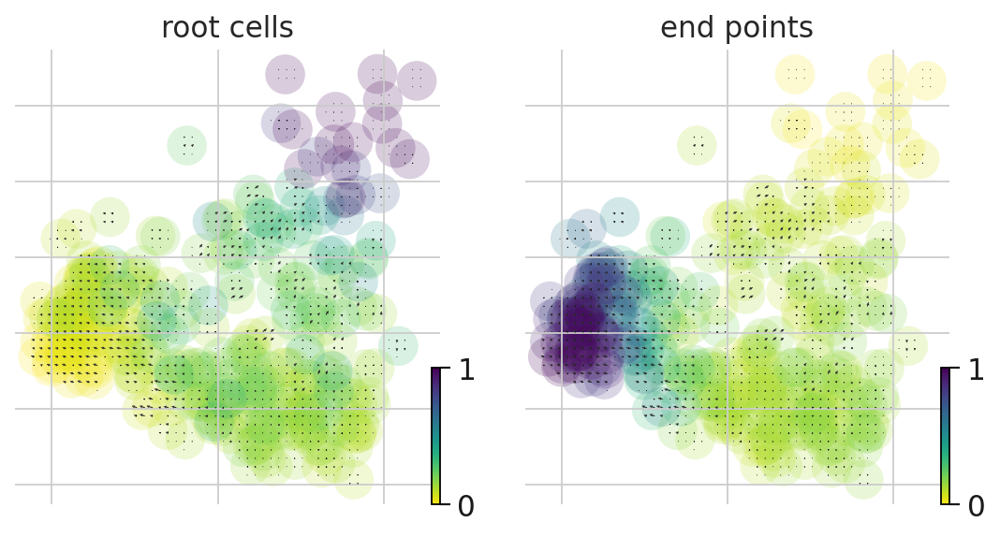

WSSS_PLA8810750


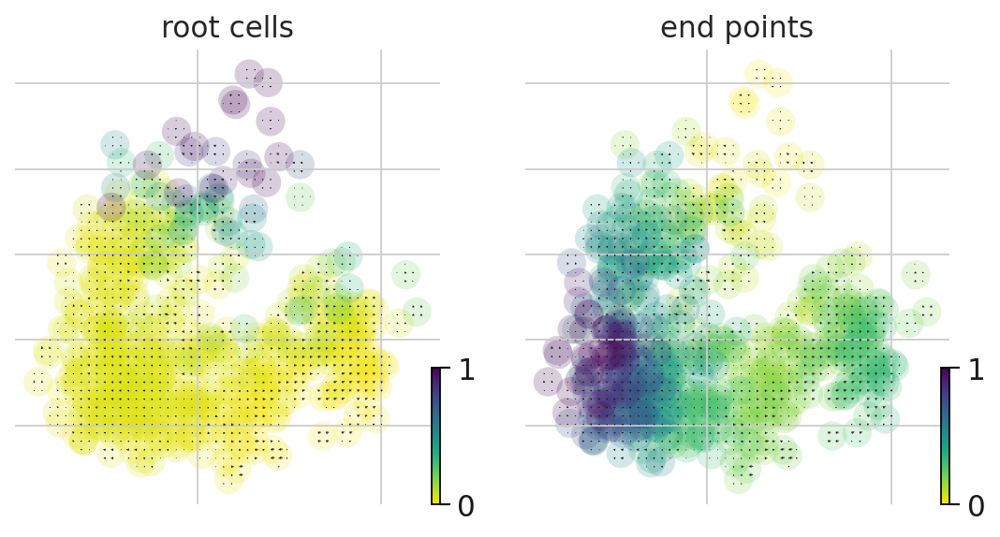

WSSS_PLA8810751


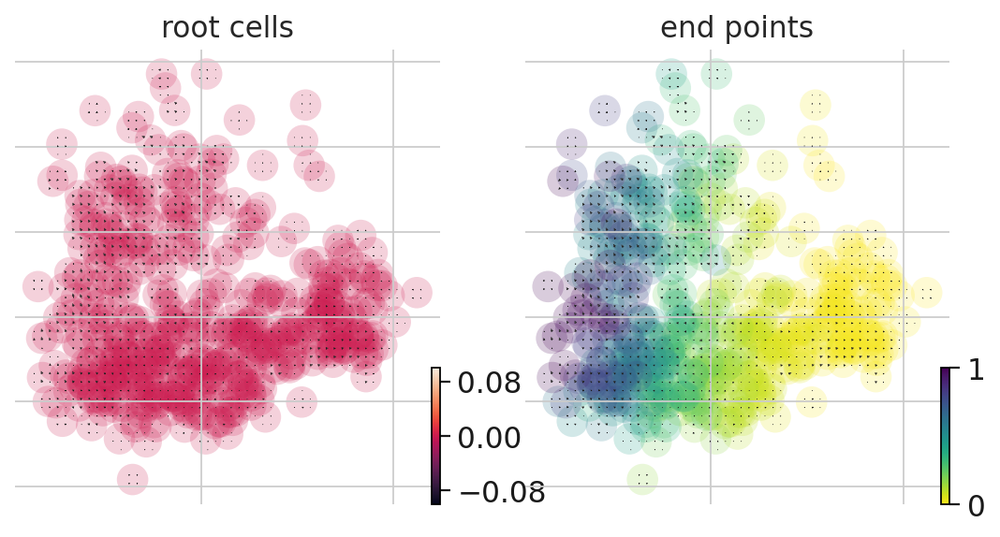

In [159]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='pca', color=['root_cells', 'end_points'])

In [160]:
adata.obs

,n_genes,donor,tissue_block,age,sample,barcode_sample,percent_mito,n_counts,dataset,technique,...,louvain_R_2,prelim_annot_inv_troph,final_annot_inv_troph,root_score_+LGR5_+TP63,root_score_+LGR5_+TP63_-HLA-G_-MKI67,root_argmax_+LGR5_+TP63,root_argmax_+LGR5_+TP63_-HLA-G_-MKI67,rootcell,dpt_pseudotime,palantir_pseudotime
AACAACCAGTCCTGCG-1,2486,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACAACCAGTCCTGCG-1_WSSS_PLA8764121,0.000170,5877.0,snRNA-seq,10X,...,1,inv_troph_3,EVT_3,0.000000,-0.993825,0,0,0,0.736640,0.646171
AACACACCACTGAGGA-1,2081,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACACACCACTGAGGA-1_WSSS_PLA8764121,0.000291,3433.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,0.000000,0.000000,0,0,0,0.229578,0.470050
AACCAACAGGTGGTTG-1,2721,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCAACAGGTGGTTG-1_WSSS_PLA8764121,0.000157,6351.0,snRNA-seq,10X,...,"2,0",VCT_CCC,EVT_1,0.000000,-1.891354,0,0,0,0.258171,0.540808
AACCATGCACTAAACC-1,1718,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCATGCACTAAACC-1_WSSS_PLA8764121,0.000244,4098.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,2.894890,2.894890,0,0,0,0.227170,0.492076
AACCATGTCCAGCACG-1,1489,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCATGTCCAGCACG-1_WSSS_PLA8764121,0.001342,2236.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,1.699694,1.699694,0,0,0,0.219780,0.428034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1,3863,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTACTGCATTGTAGC-1_WSSS_PLA8810751,0.000334,11983.0,snRNA-seq,10X,...,1,inv_troph_3,EVT_3,0.606780,-1.036591,0,0,0,0.720896,0.625391
TTTACTGTCTGCATGA-1,2917,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTACTGTCTGCATGA-1_WSSS_PLA8810751,0.001026,6823.0,snRNA-seq,10X,...,4,inv_troph_4,EVT_2,0.000000,0.000000,0,0,0,0.550102,0.612573
TTTATGCCAGATACCT-1,2361,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTATGCCAGATACCT-1_WSSS_PLA8810751,0.001711,5259.0,snRNA-seq,10X,...,4,inv_troph_4,EVT_2,0.000000,-1.569242,0,0,0,0.651858,0.690932
TTTGACTCAGGAATAT-1,3547,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTGACTCAGGAATAT-1_WSSS_PLA8810751,0.000207,9681.0,snRNA-seq,10X,...,4,inv_troph_3,EVT_2,0.000000,-0.709489,0,0,0,0.634959,0.725957


In [161]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adata_subset = adata[adata.obs['sample'] == sample]
    adata_subset.obs_names = adata_subset.obs['barcode_sample']
    adata_subset.obs.set_index('barcode_sample', inplace=True)
    adatas_loom[sample].obsm['X_umap'] = adata_subset.obsm['X_umap']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [162]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='umap')

WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8764122
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8810750
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


In [163]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.terminal_states(adatas_loom[sample])

WSSS_PLA8764121
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8764122
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810750
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810751
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', 

WSSS_PLA8764121


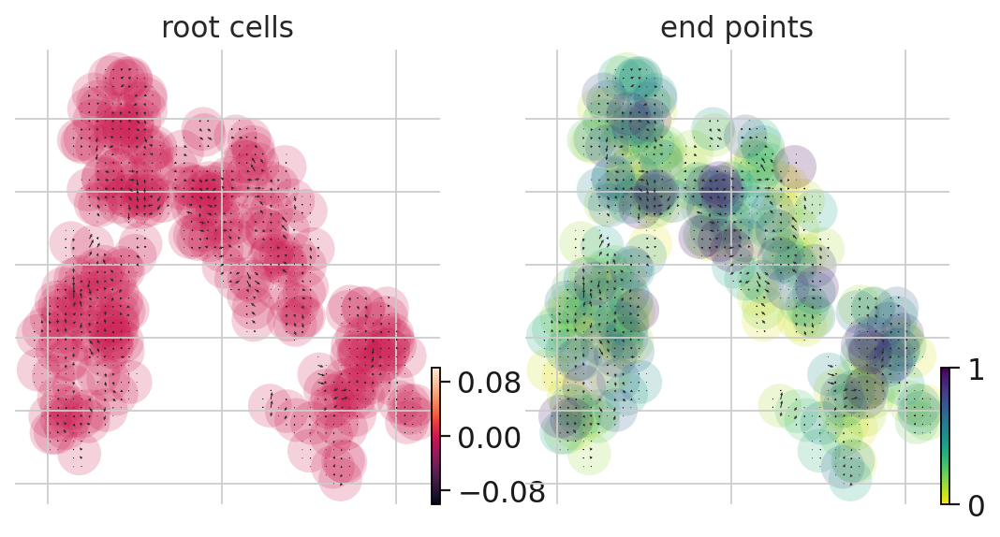

WSSS_PLA8764122


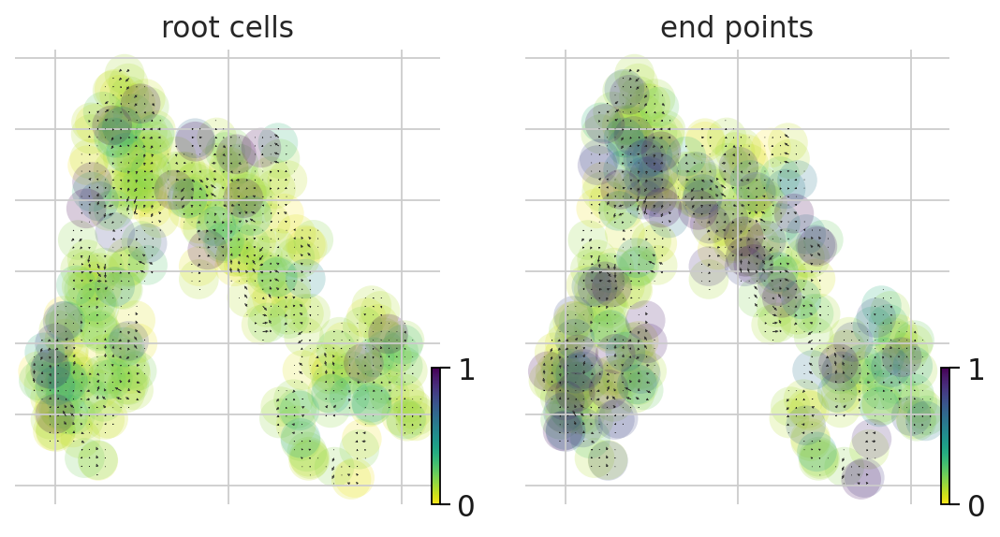

WSSS_PLA8810750


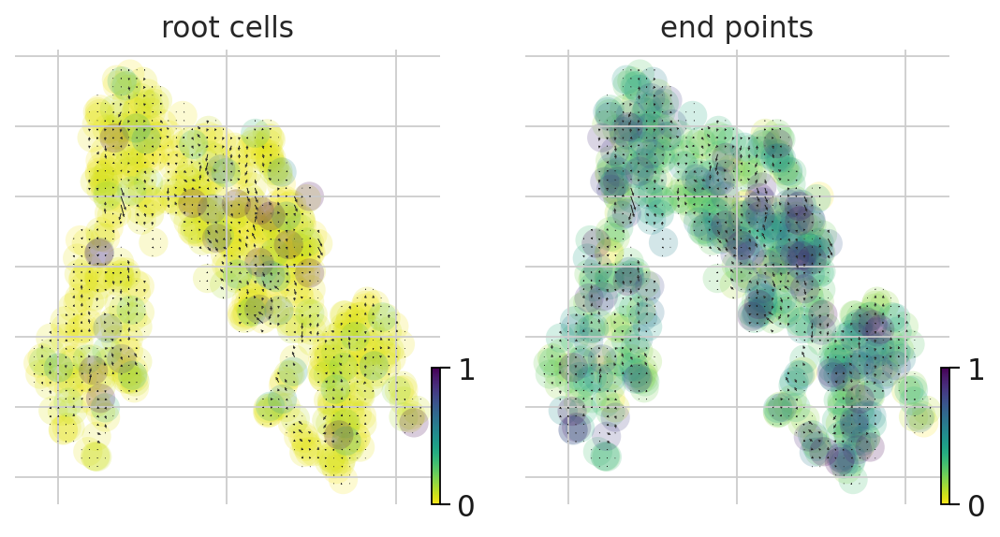

WSSS_PLA8810751


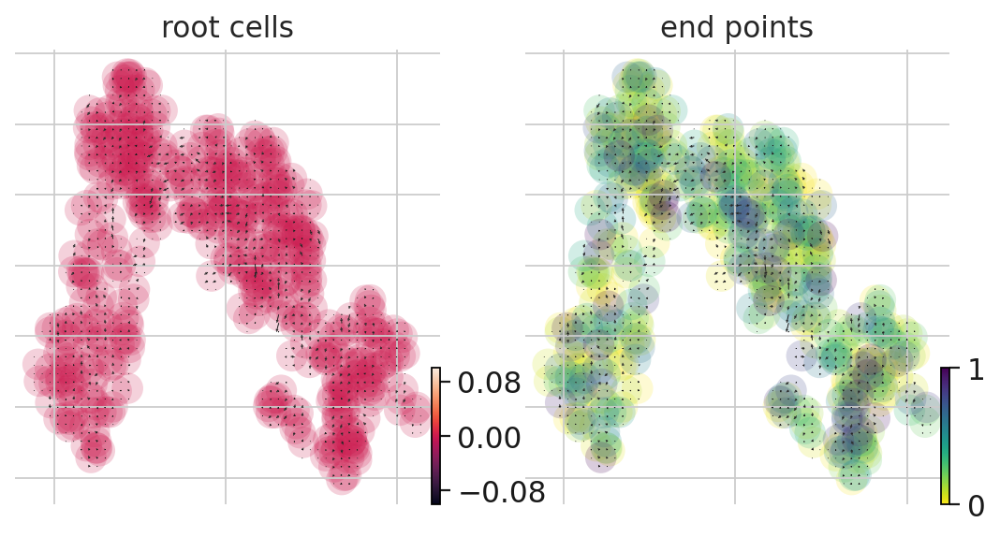

In [164]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='umap', color=['root_cells', 'end_points'])

In [165]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.umap(adatas_loom[sample])

computing UMAP


WSSS_PLA8764121


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8764122


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8810750


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8810751


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


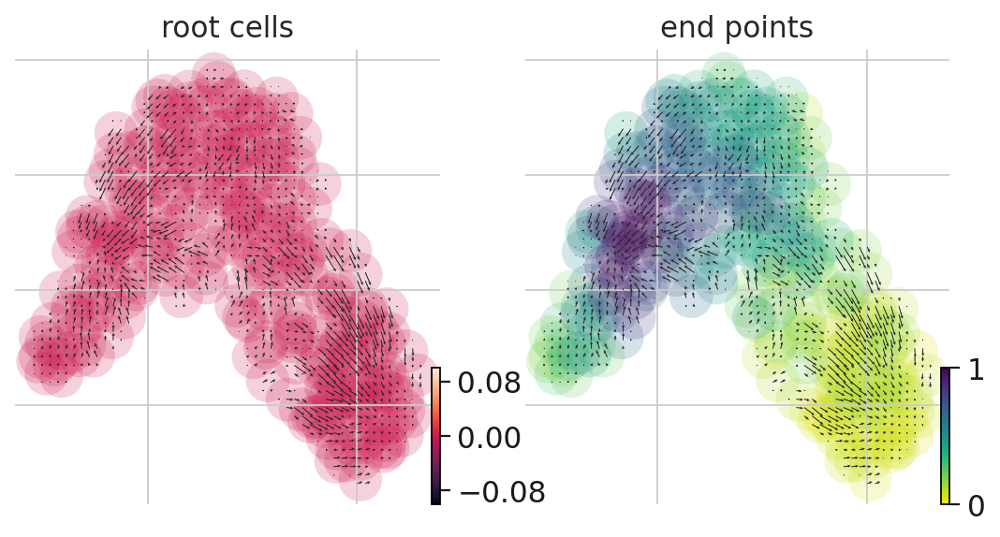

WSSS_PLA8764122
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


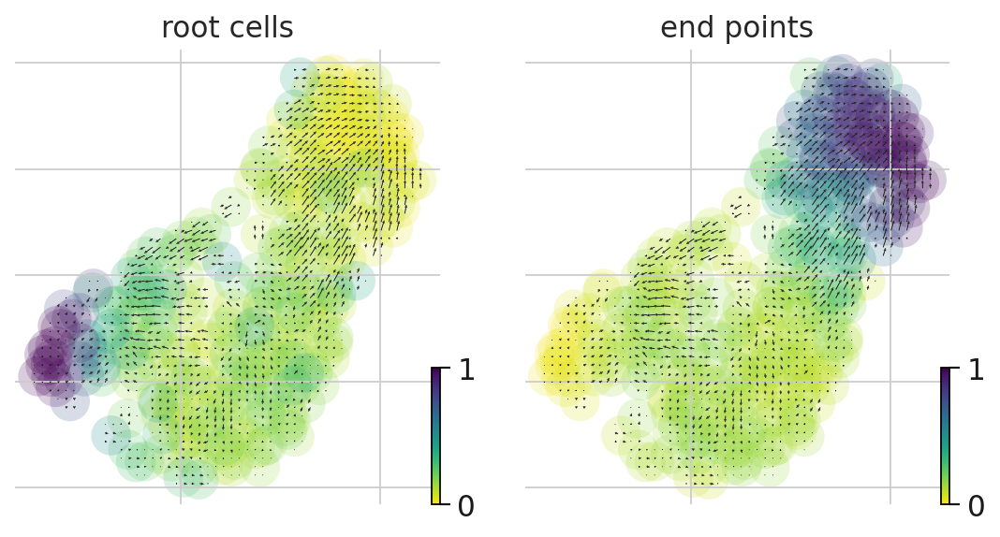

WSSS_PLA8810750
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


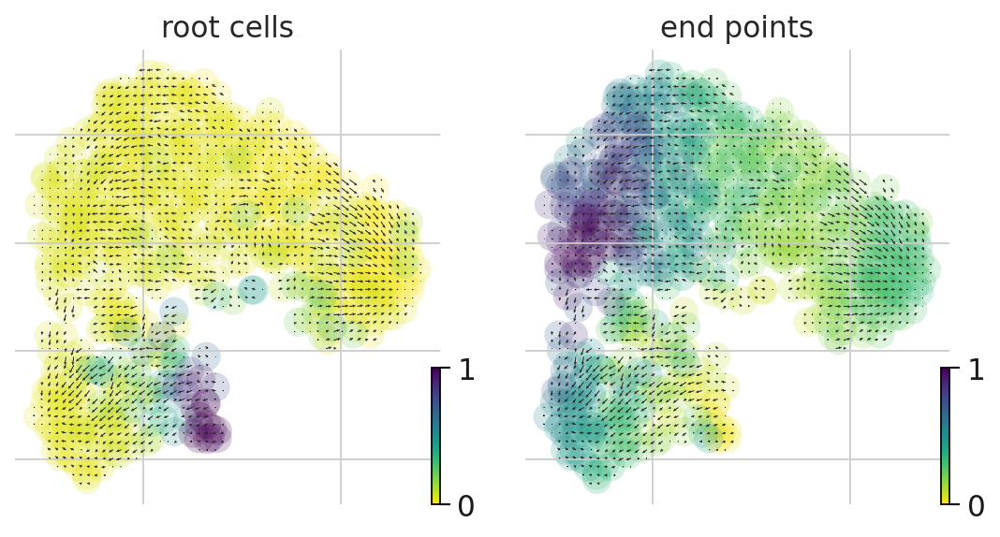

WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


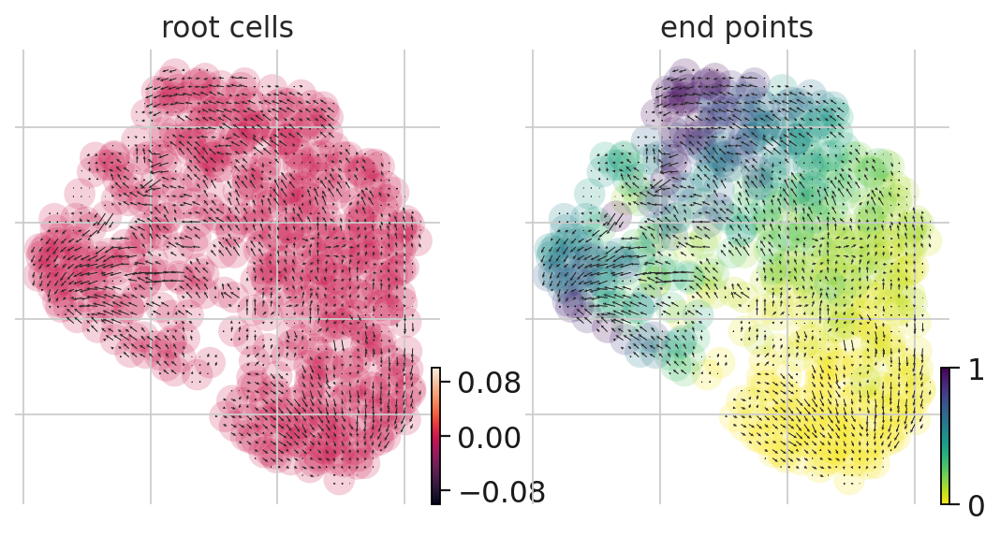

In [166]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='umap')
    scv.tl.terminal_states(adatas_loom[sample])
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='umap', color=['root_cells', 'end_points'])

In [167]:
adatas_loom['WSSS_PLA8764121'].obs

,n_counts_spliced,n_counts_unspliced,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,louvain,root_cells,end_points
barcode_sample_sn_like,,,,,,,,,,
CTGCCTATCGCTTTAT-1_WSSS_PLA8764121,761,1944,761,1944,761.0,461.181396,0.130207,1,0.0,0.078448
TAACTTCGTCTACGTA-1_WSSS_PLA8764121,1225,4541,1225,4541,1225.0,509.385712,0.180219,0,0.0,0.628166
ACGCACGTCGATTGAC-1_WSSS_PLA8764121,1017,5453,1017,5453,1017.0,512.032410,0.121096,0,0.0,0.424985
TGGATGTGTGCACAAG-1_WSSS_PLA8764121,561,2328,561,2328,561.0,447.176483,0.108937,1,0.0,0.135795
CAACGATTCCTCTCGA-1_WSSS_PLA8764121,530,1414,530,1414,530.0,504.409485,0.092018,2,0.0,0.431977
...,...,...,...,...,...,...,...,...,...,...
CAGGTATTCACTAGCA-1_WSSS_PLA8764121,812,4277,812,4277,812.0,503.991364,0.153287,0,0.0,0.787532
TCTTTGATCTCTGACC-1_WSSS_PLA8764121,534,1961,534,1961,534.0,438.942017,0.174082,1,0.0,0.073890
CACTGAATCGCTCTCA-1_WSSS_PLA8764121,518,1727,518,1727,518.0,496.527069,0.281379,2,0.0,0.772024


In [168]:
adata.obs_names = adata.obs['barcode_sample']
adata.obs.set_index('barcode_sample', inplace=True)

In [169]:
adata.obs['root_cells_velocyto'] = [0 for i in range(len(adata.obs))]
adata.obs['end_points_velocyto'] = [0 for i in range(len(adata.obs))]

In [170]:
# smth wrong with this code
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adata[adata.obs['sample'] == sample].obs.loc[adatas_loom[sample].obs_names,'root_cells_velocyto'] = list(adatas_loom[sample].obs['root_cells'])
    adata[adata.obs['sample'] == sample].obs.loc[adatas_loom[sample].obs_names,'end_points_velocyto'] = list(adatas_loom[sample].obs['end_points'])


WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


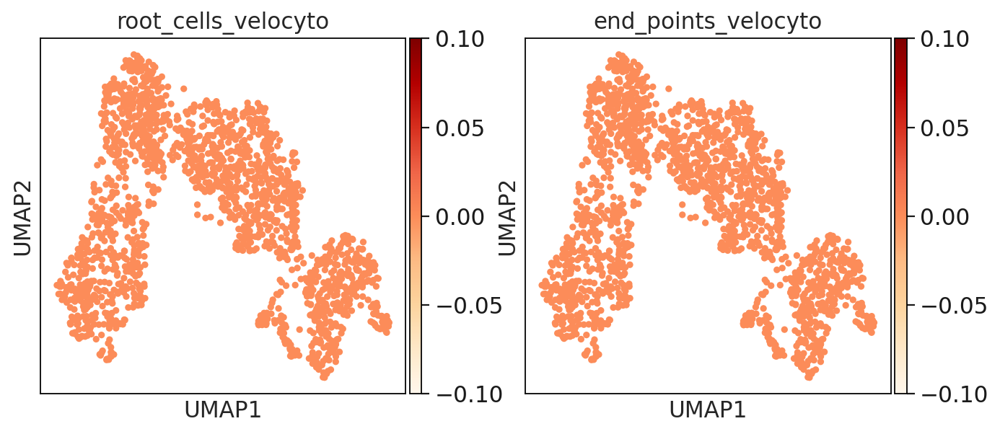

In [171]:
# this is wrong
sc.pl.umap(adata, color=['root_cells_velocyto','end_points_velocyto'], cmap='OrRd')

WSSS_PLA8764121


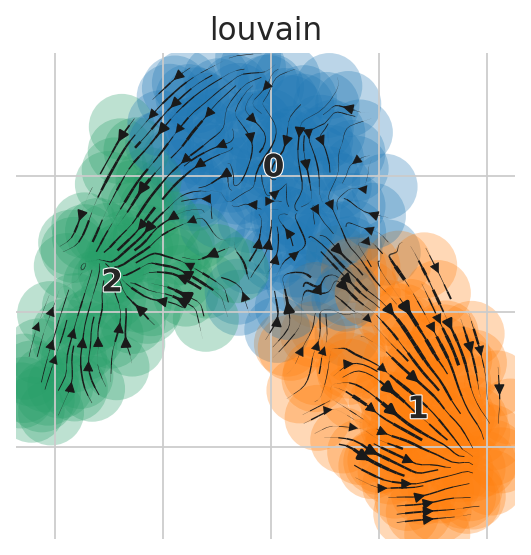

WSSS_PLA8764122


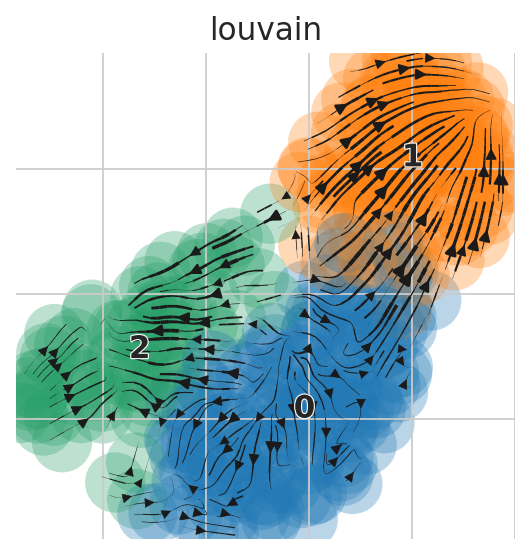

WSSS_PLA8810750


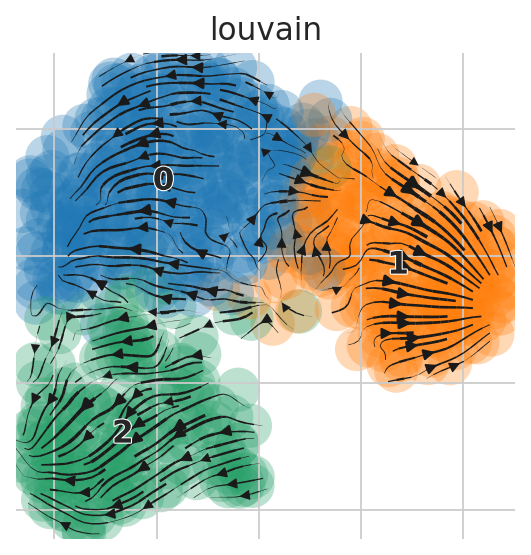

WSSS_PLA8810751


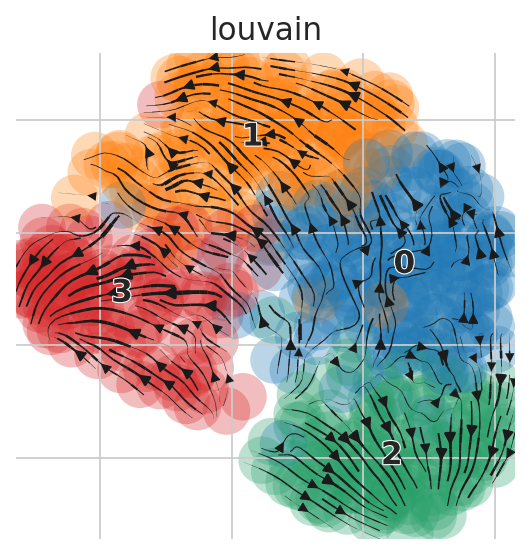

In [173]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_stream(adatas_loom[sample], basis='umap')


In [174]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 2954
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points'
    var: 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'louvain', 'louvain_colors', 'umap'
    obsm: 'X_pca', 'velocity_pca', 'X_umap', 'velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

WSSS_PLA8764121


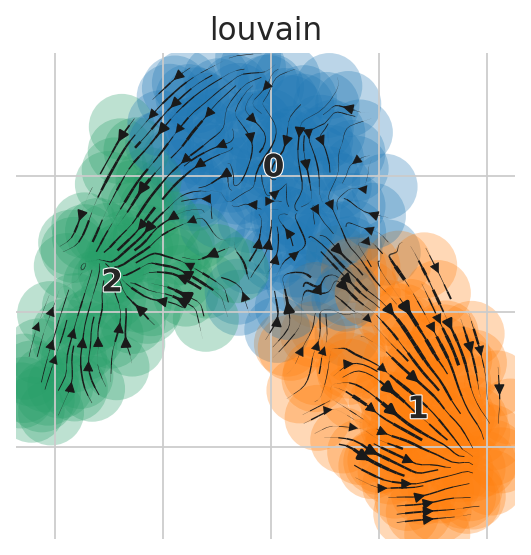

WSSS_PLA8764122


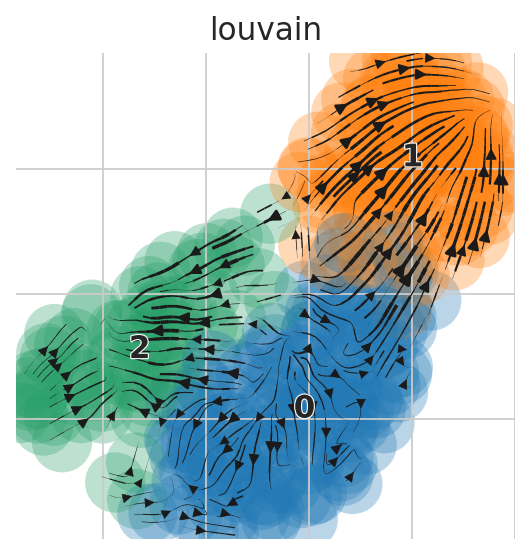

WSSS_PLA8810750


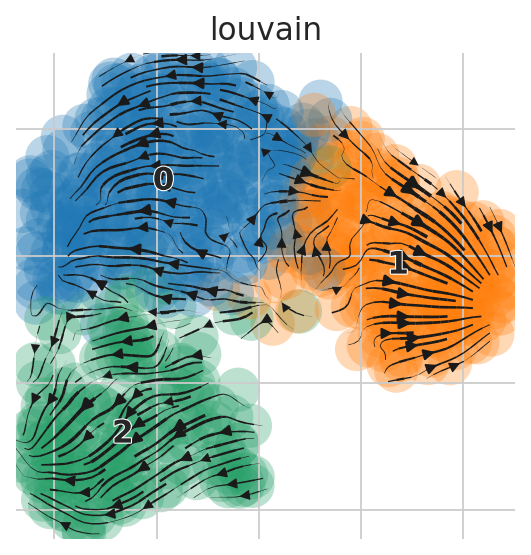

WSSS_PLA8810751


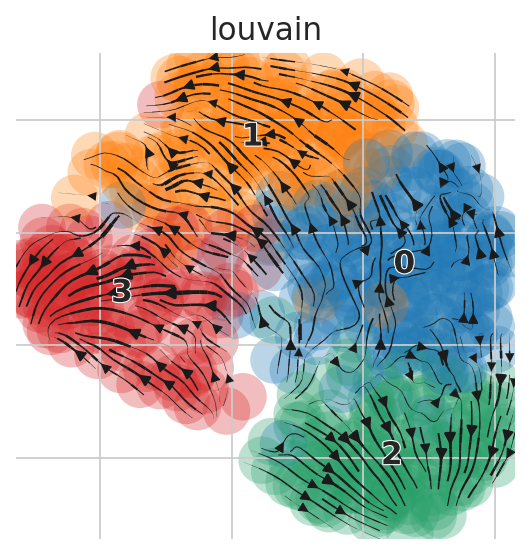

In [175]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_stream(adatas_loom[sample], basis='X_umap')


In [176]:
adata.obs

,n_genes,donor,tissue_block,age,sample,percent_mito,n_counts,dataset,technique,scrublet_score,...,final_annot_inv_troph,root_score_+LGR5_+TP63,root_score_+LGR5_+TP63_-HLA-G_-MKI67,root_argmax_+LGR5_+TP63,root_argmax_+LGR5_+TP63_-HLA-G_-MKI67,rootcell,dpt_pseudotime,palantir_pseudotime,root_cells_velocyto,end_points_velocyto
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AACAACCAGTCCTGCG-1_WSSS_PLA8764121,2486,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000170,5877.0,snRNA-seq,10X,0.068493,...,EVT_3,0.000000,-0.993825,0,0,0,0.736640,0.646171,0,0
AACACACCACTGAGGA-1_WSSS_PLA8764121,2081,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000291,3433.0,snRNA-seq,10X,0.070162,...,VCT_CCC,0.000000,0.000000,0,0,0,0.229578,0.470050,0,0
AACCAACAGGTGGTTG-1_WSSS_PLA8764121,2721,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000157,6351.0,snRNA-seq,10X,0.107143,...,EVT_1,0.000000,-1.891354,0,0,0,0.258171,0.540808,0,0
AACCATGCACTAAACC-1_WSSS_PLA8764121,1718,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000244,4098.0,snRNA-seq,10X,0.068493,...,VCT_CCC,2.894890,2.894890,0,0,0,0.227170,0.492076,0,0
AACCATGTCCAGCACG-1_WSSS_PLA8764121,1489,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.001342,2236.0,snRNA-seq,10X,0.062229,...,VCT_CCC,1.699694,1.699694,0,0,0,0.219780,0.428034,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1_WSSS_PLA8810751,3863,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.000334,11983.0,snRNA-seq,10X,0.025431,...,EVT_3,0.606780,-1.036591,0,0,0,0.720896,0.625391,0,0
TTTACTGTCTGCATGA-1_WSSS_PLA8810751,2917,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.001026,6823.0,snRNA-seq,10X,0.030408,...,EVT_2,0.000000,0.000000,0,0,0,0.550102,0.612573,0,0
TTTATGCCAGATACCT-1_WSSS_PLA8810751,2361,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.001711,5259.0,snRNA-seq,10X,0.022047,...,EVT_2,0.000000,-1.569242,0,0,0,0.651858,0.690932,0,0


In [177]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['cell_type'] = adata.obs.loc[adatas_loom[sample].obs_names,'final_annot_inv_troph']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


WSSS_PLA8764121


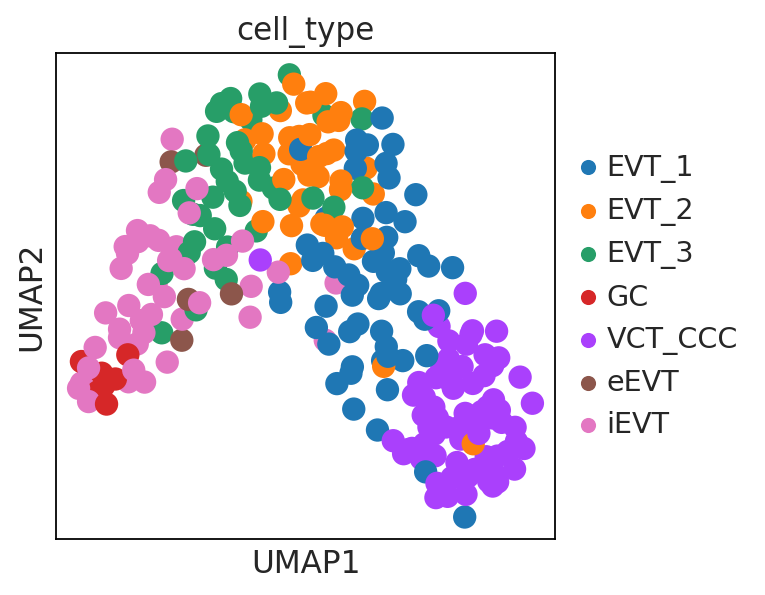

WSSS_PLA8764122


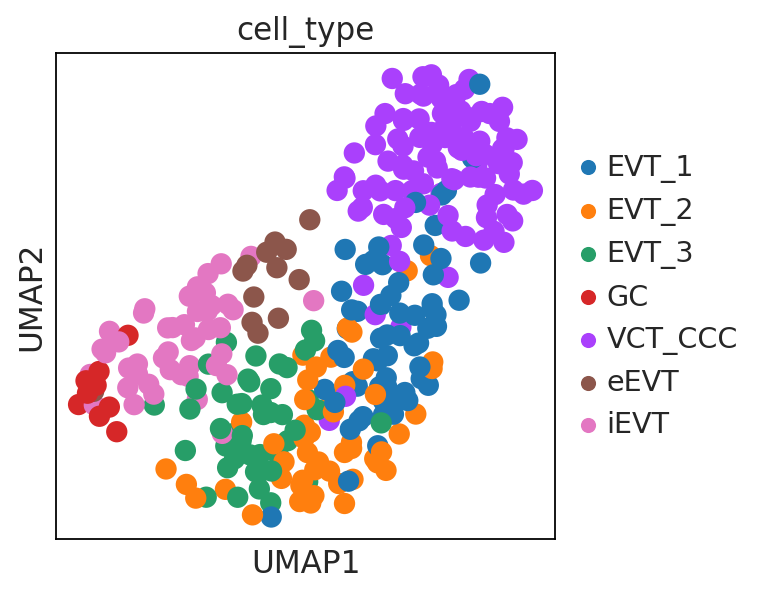

WSSS_PLA8810750


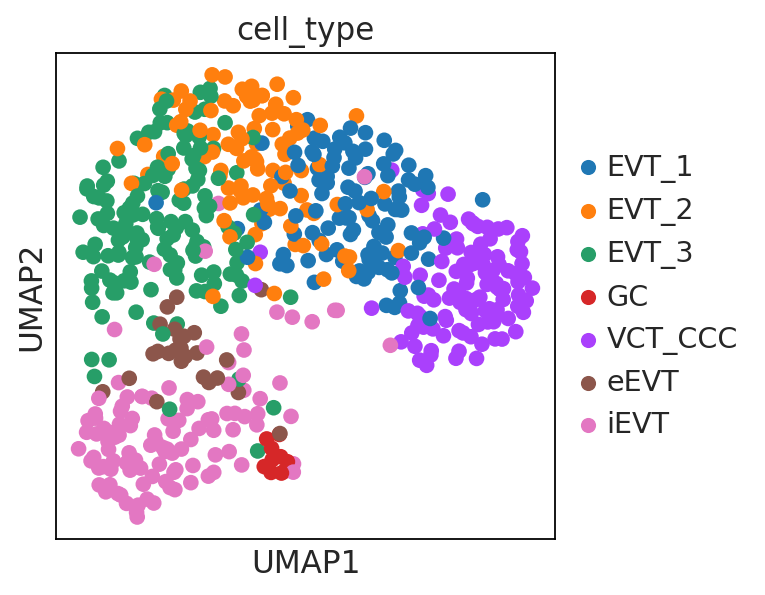

WSSS_PLA8810751


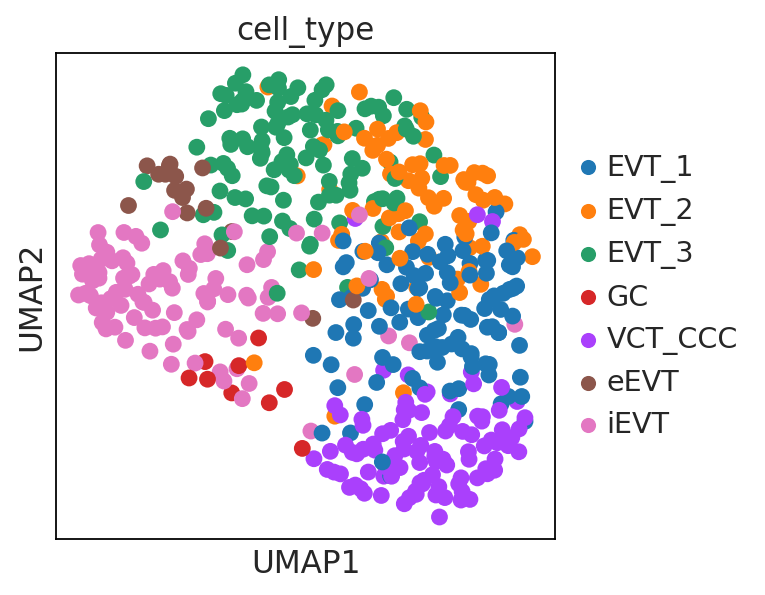

In [178]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    sc.pl.umap(adatas_loom[sample], color='cell_type')

In [179]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['sample'] = adata.obs.loc[adatas_loom[sample].obs_names,'sample']
    adatas_loom[sample].obs['tissue_block'] = adata.obs.loc[adatas_loom[sample].obs_names,'tissue_block']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


WSSS_PLA8764121


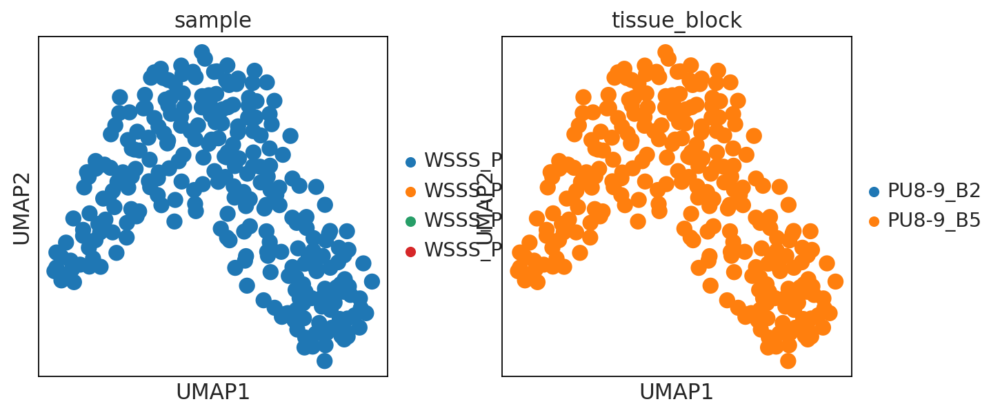

WSSS_PLA8764122


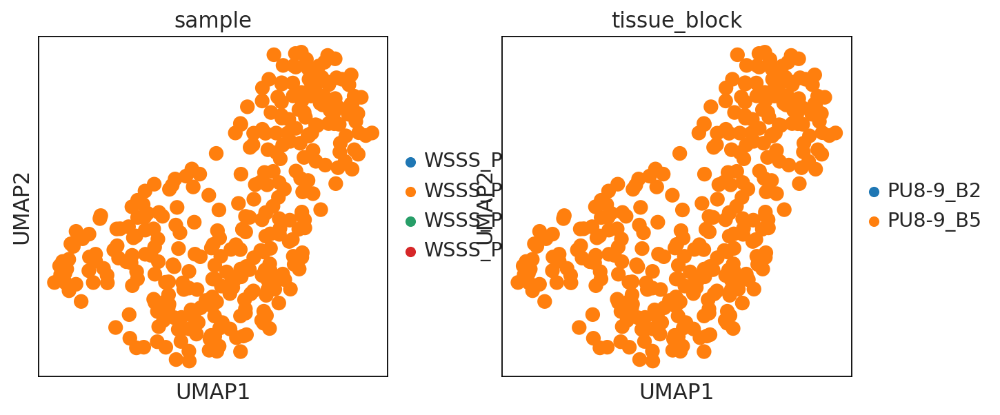

WSSS_PLA8810750


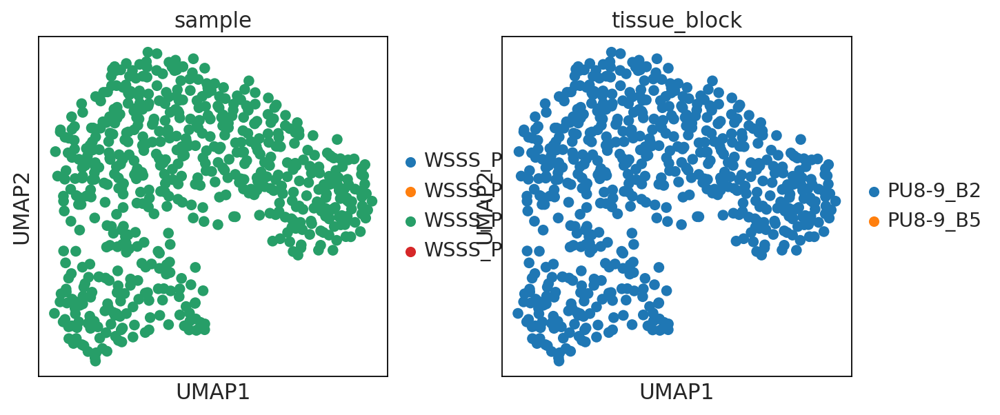

WSSS_PLA8810751


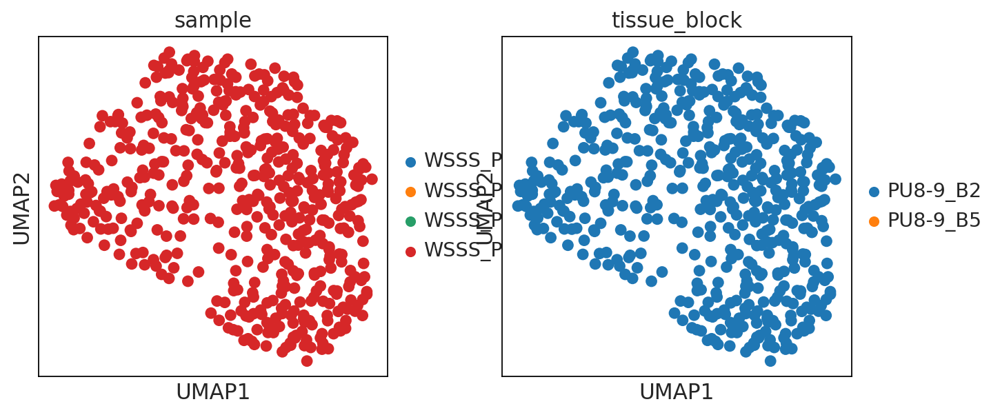

In [180]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    sc.pl.umap(adatas_loom[sample], color=['sample','tissue_block'])

# Final attempt - using only HVGs

In [182]:
%%time
# takes about 25 minutes, but later faster
adatas_loom = {}

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample] = scv.read(save_path + '20210423_velocyto_donor_P13_sample_' + sample + '.loom', cache=True)

... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8764121.h5ad


WSSS_PLA8764121


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8764122.h5ad


WSSS_PLA8764122


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8810750.h5ad


WSSS_PLA8810750


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... reading from cache file cache/lustre-scratch117-cellgen-team292-aa22-adata_objects-202007_snRNA-seq_MFI-snRNA_seq_MFI_202007_adatas-202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants-donor_P13_analysis-20210423_velocyto_donor_P13_sample_WSSS_PLA8810751.h5ad


WSSS_PLA8810751


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


CPU times: user 11.6 s, sys: 1.46 s, total: 13.1 s
Wall time: 13.1 s


In [183]:
adatas_loom

{'WSSS_PLA8764121': AnnData object with n_obs × n_vars = 85256 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced',
 'WSSS_PLA8764122': AnnData object with n_obs × n_vars = 81782 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced',
 'WSSS_PLA8810750': AnnData object with n_obs × n_vars = 84598 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced',
 'WSSS_PLA8810751': AnnData object with n_obs × n_vars = 71733 × 33538
     var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
     layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'}

In [184]:
adatas_loom['WSSS_PLA8764121'].obs.head()

""
possorted_genome_bam_7ZNK7:AAACCCAAGATCACCT
possorted_genome_bam_7ZNK7:AAACCCAAGATCGCTT
possorted_genome_bam_7ZNK7:AAACCCAAGATACATG
possorted_genome_bam_7ZNK7:AAACCCAAGATTGCGG
possorted_genome_bam_7ZNK7:AAACCCAAGACGCTCC


In [185]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [186]:
len(adata.obs_names)

1729

In [187]:
adatas_loom['WSSS_PLA8764121'].obs_names

Index(['possorted_genome_bam_7ZNK7:AAACCCAAGATCACCT',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATCGCTT',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATACATG',
       'possorted_genome_bam_7ZNK7:AAACCCAAGATTGCGG',
       'possorted_genome_bam_7ZNK7:AAACCCAAGACGCTCC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGAGTCAGC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGAGGATCC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCTCACTA',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCGTGCTC',
       'possorted_genome_bam_7ZNK7:AAACCCAAGCGGTAGT',
       ...
       'possorted_genome_bam_7ZNK7:TTTGTTGTCCTTTGAT',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCCGTAATG',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCGGACTGC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTCCGCAT',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTGCTAGA',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACGGGC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACCCAC',
       'possorted_genome_bam_7ZNK7:TTTGTTGTCTACAGGT',
       'possorted

In [188]:
# dict of bam names to sample names
bam2sample = {}

bam2sample['possorted_genome_bam_7ZNK7'] = 'WSSS_PLA8764121'
bam2sample['possorted_genome_bam_V4O8B'] = 'WSSS_PLA8764122'
bam2sample['possorted_genome_bam_PSPJC'] = 'WSSS_PLA8810750'
bam2sample['possorted_genome_bam_T8XDM'] = 'WSSS_PLA8810751'



In [189]:
for barcode_sample in list(adata.obs['barcode_sample']):
    if '-1' not in barcode_sample:
        print(barcode_sample)

In [190]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 85256 × 33538
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [191]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [192]:
# getting from the indices above to the ones in adata.obs['barcode_sample']

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['barcode_sample_sn_like'] = [elem.split(':')[1] + '-1_' + bam2sample[elem.split(':')[0]] for elem in adatas_loom[sample].obs_names]

    adatas_loom[sample].obs.set_index('barcode_sample_sn_like', inplace=True)
    

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [193]:
adatas_loom['WSSS_PLA8764121'].obs

""
barcode_sample_sn_like
AAACCCAAGATCACCT-1_WSSS_PLA8764121
AAACCCAAGATCGCTT-1_WSSS_PLA8764121
AAACCCAAGATACATG-1_WSSS_PLA8764121
AAACCCAAGATTGCGG-1_WSSS_PLA8764121
AAACCCAAGACGCTCC-1_WSSS_PLA8764121
...
TTTGTTGTCTACGGGC-1_WSSS_PLA8764121
TTTGTTGTCTACCCAC-1_WSSS_PLA8764121
TTTGTTGTCTACAGGT-1_WSSS_PLA8764121


In [194]:
#adata_loom.obs_names = [i.split(':')[1] for i in adata_loom.obs_names]

In [195]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs_names_make_unique()

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [196]:
adatas_loom['WSSS_PLA8764121'].obs_names

Index(['AAACCCAAGATCACCT-1_WSSS_PLA8764121',
       'AAACCCAAGATCGCTT-1_WSSS_PLA8764121',
       'AAACCCAAGATACATG-1_WSSS_PLA8764121',
       'AAACCCAAGATTGCGG-1_WSSS_PLA8764121',
       'AAACCCAAGACGCTCC-1_WSSS_PLA8764121',
       'AAACCCAAGAGTCAGC-1_WSSS_PLA8764121',
       'AAACCCAAGAGGATCC-1_WSSS_PLA8764121',
       'AAACCCAAGCTCACTA-1_WSSS_PLA8764121',
       'AAACCCAAGCGTGCTC-1_WSSS_PLA8764121',
       'AAACCCAAGCGGTAGT-1_WSSS_PLA8764121',
       ...
       'TTTGTTGTCCTTTGAT-1_WSSS_PLA8764121',
       'TTTGTTGTCCGTAATG-1_WSSS_PLA8764121',
       'TTTGTTGTCGGACTGC-1_WSSS_PLA8764121',
       'TTTGTTGTCTCCGCAT-1_WSSS_PLA8764121',
       'TTTGTTGTCTGCTAGA-1_WSSS_PLA8764121',
       'TTTGTTGTCTACGGGC-1_WSSS_PLA8764121',
       'TTTGTTGTCTACCCAC-1_WSSS_PLA8764121',
       'TTTGTTGTCTACAGGT-1_WSSS_PLA8764121',
       'TTTGTTGTCGGTGTAT-1_WSSS_PLA8764121',
       'TTTGTTGTCTTGTTAC-1_WSSS_PLA8764121'],
      dtype='object', name='barcode_sample_sn_like', length=85256)

In [197]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['WSSS_PLA8764121', 'WSSS_PLA8764122', 'WSSS_PLA8810750',
        'WSSS_PLA8810751'], dtype=object),
 array([272, 326, 606, 525]))

In [198]:
adata

AnnData object with n_obs × n_vars = 1729 × 4790
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'barcode_sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_id', 'S_score', 'G2M_score', 'phase', 'celltype_predictions', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'probabilities', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'prelim_annot', 'louvain_R_2', 'prelim_annot_inv_troph', 'final_annot_inv_troph', 'root_score_+LGR5_+TP63', 'root_score_+LGR5_+TP63_-HLA-G_-MKI67', 'root_argmax_+LGR5_+TP63', 'root_argmax_+LGR5_+TP63_-HLA-G_-MKI67', 'rootcell', 'dpt_pseudotime', 'palantir_pseudotime'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'highly_variable', 'means', 'dispersions'

In [200]:
len(list(adata.var_names))

4790

In [201]:
len(set(adata.var_names))

4790

In [202]:
# subsetting to only final cells and only all genes in raw (27605 filtered genes)

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    curr_overlap = set(adata.obs['barcode_sample']) & set(adatas_loom[sample].obs_names)
    #print('curr_overlap', list(curr_overlap)[:5])
    adatas_loom[sample] = adatas_loom[sample][list(curr_overlap),:].copy()
    
    adatas_loom[sample].var_names_make_unique()
    adatas_loom[sample].obs_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [203]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample] = adatas_loom[sample][:,list(adata.var_names)].copy()

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [204]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 4790
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [205]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.show_proportions(adatas_loom[sample])
    scv.pp.cleanup(adatas_loom[sample], clean='all')

WSSS_PLA8764121
Abundance of ['spliced', 'unspliced']: [0.21 0.79]
WSSS_PLA8764122
Abundance of ['spliced', 'unspliced']: [0.2 0.8]
WSSS_PLA8810750
Abundance of ['spliced', 'unspliced']: [0.23 0.77]
WSSS_PLA8810751
Abundance of ['spliced', 'unspliced']: [0.22 0.78]


In [206]:
adatas_loom['WSSS_PLA8764121'].layers['spliced']

<272x4790 sparse matrix of type '<class 'numpy.uint32'>'
	with 37021 stored elements in Compressed Sparse Row format>

In [207]:
adatas_loom['WSSS_PLA8764121'].layers['unspliced']

<272x4790 sparse matrix of type '<class 'numpy.uint32'>'
	with 96145 stored elements in Compressed Sparse Row format>

In [208]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 4790
    layers: 'spliced', 'unspliced'

In [209]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['n_counts_spliced'] = adatas_loom[sample].layers['spliced'].sum(1)
    adatas_loom[sample].obs['n_counts_unspliced'] = adatas_loom[sample].layers['unspliced'].sum(1)

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [210]:
np.unique(adatas_loom['WSSS_PLA8764121'].obs['n_counts_spliced'])

array([  41,   55,   57,   58,   61,   62,   66,   69,   72,   74,   76,
         78,   79,   80,   82,   83,   84,   85,   86,   87,   88,   89,
         91,   92,   93,   94,   95,   96,   98,  100,  101,  102,  103,
        104,  105,  106,  107,  108,  109,  110,  111,  113,  115,  116,
        117,  118,  119,  120,  121,  122,  123,  124,  125,  126,  127,
        128,  130,  131,  132,  134,  135,  136,  137,  138,  139,  140,
        141,  143,  144,  145,  147,  149,  152,  153,  154,  156,  158,
        159,  160,  161,  162,  163,  166,  167,  168,  169,  170,  171,
        173,  175,  176,  177,  180,  181,  183,  184,  185,  187,  188,
        189,  191,  192,  193,  196,  197,  198,  199,  201,  202,  204,
        207,  210,  211,  212,  215,  216,  217,  218,  227,  228,  231,
        234,  236,  241,  248,  249,  251,  253,  255,  256,  257,  258,
        261,  275,  278,  281,  285,  295,  304,  309,  311,  312,  326,
        327,  346,  348,  349,  356,  357,  360,  3

In [211]:
np.unique(adatas_loom['WSSS_PLA8764121'].obs['n_counts_unspliced'])

array([ 115,  144,  163,  171,  183,  189,  200,  207,  216,  219,  228,
        238,  244,  248,  254,  257,  265,  266,  267,  268,  270,  274,
        276,  289,  293,  294,  300,  302,  303,  309,  314,  324,  328,
        329,  330,  334,  335,  337,  338,  344,  347,  349,  351,  364,
        367,  374,  375,  376,  377,  379,  380,  385,  387,  391,  392,
        395,  399,  401,  402,  403,  407,  409,  418,  419,  420,  424,
        429,  436,  441,  442,  443,  450,  459,  461,  462,  471,  473,
        477,  480,  496,  499,  501,  503,  507,  509,  511,  514,  516,
        517,  532,  533,  536,  540,  544,  552,  554,  557,  562,  565,
        572,  573,  574,  580,  583,  584,  586,  588,  595,  597,  606,
        607,  617,  620,  621,  622,  623,  629,  633,  639,  649,  653,
        655,  659,  660,  669,  672,  673,  678,  694,  699,  700,  704,
        708,  712,  717,  720,  725,  730,  731,  736,  741,  745,  755,
        757,  762,  763,  764,  767,  780,  787,  7

In [212]:
#adata_loom.var_names_make_unique()

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.filter_and_normalize(adatas_loom[sample], min_counts=20, 
                            #min_counts_u=10, 
                            n_top_genes=4000)

WSSS_PLA8764121
Filtered out 4177 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
WSSS_PLA8764122
Filtered out 3896 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
WSSS_PLA8810750
Filtered out 3428 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
WSSS_PLA8810751
Filtered out 3440 genes that are detected 20 counts (spliced).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.


In [213]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 613
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    layers: 'spliced', 'unspliced'

In [214]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pp.moments(adatas_loom[sample])

computing PCA
    with n_comps=30


WSSS_PLA8764121


    finished (0:00:00)
computing PCA
    with n_comps=30


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8764122


    finished (0:00:00)
computing PCA
    with n_comps=30


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8810750


    finished (0:00:00)
computing PCA
    with n_comps=30


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
WSSS_PLA8810751


    finished (0:00:00)


computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [215]:
%%time

for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity(adatas_loom[sample])
    scv.tl.velocity_graph(adatas_loom[sample])

WSSS_PLA8764121
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8764122
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8810750
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
WSSS_PLA8810751
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
   

In [216]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.louvain(adatas_loom[sample], resolution=0.6)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='pca')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8764122
computing velocity embedding


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8810750
computing velocity embedding


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


WSSS_PLA8764121


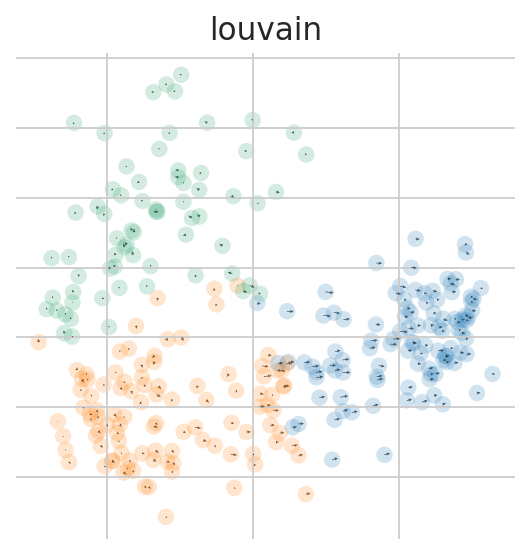

WSSS_PLA8764122


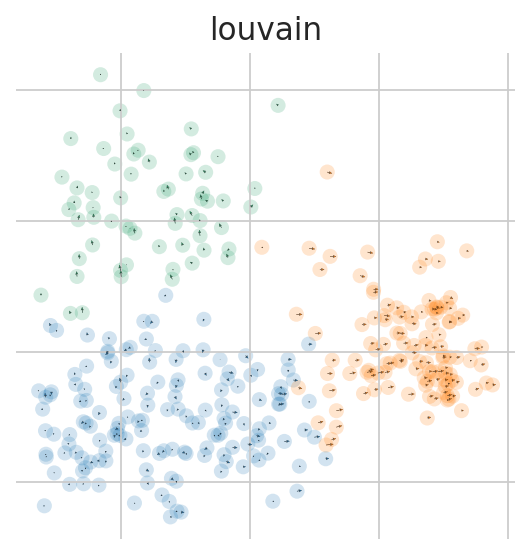

WSSS_PLA8810750


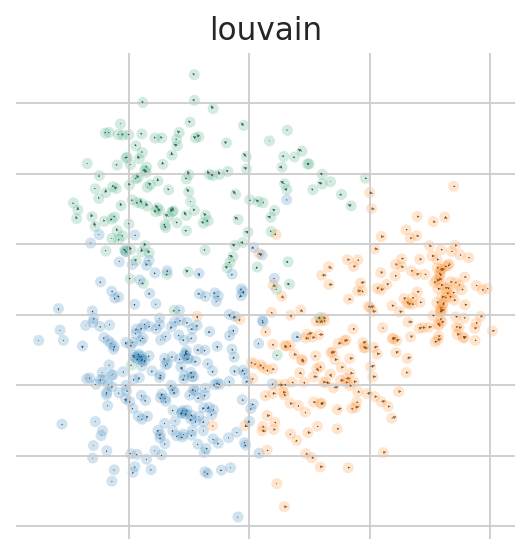

WSSS_PLA8810751


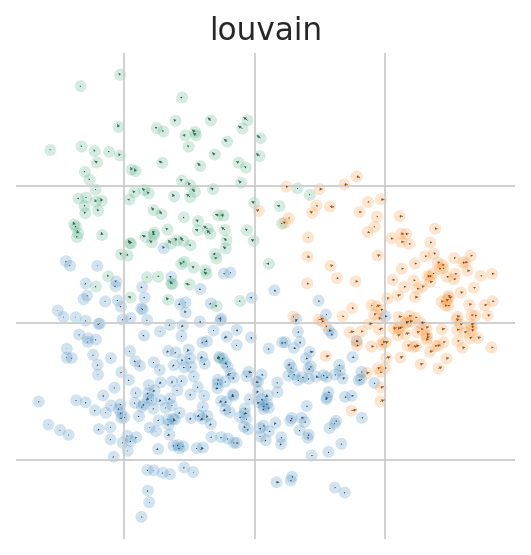

In [217]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding(adatas_loom[sample], basis='pca')

In [218]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.terminal_states(adatas_loom[sample])

WSSS_PLA8764121
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8764122
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810750
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810751
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', 

In [219]:
adatas_loom['WSSS_PLA8764121'].obs.columns

Index(['n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced',
       'initial_size_unspliced', 'initial_size', 'n_counts',
       'velocity_self_transition', 'louvain', 'root_cells', 'end_points'],
      dtype='object')

WSSS_PLA8764121


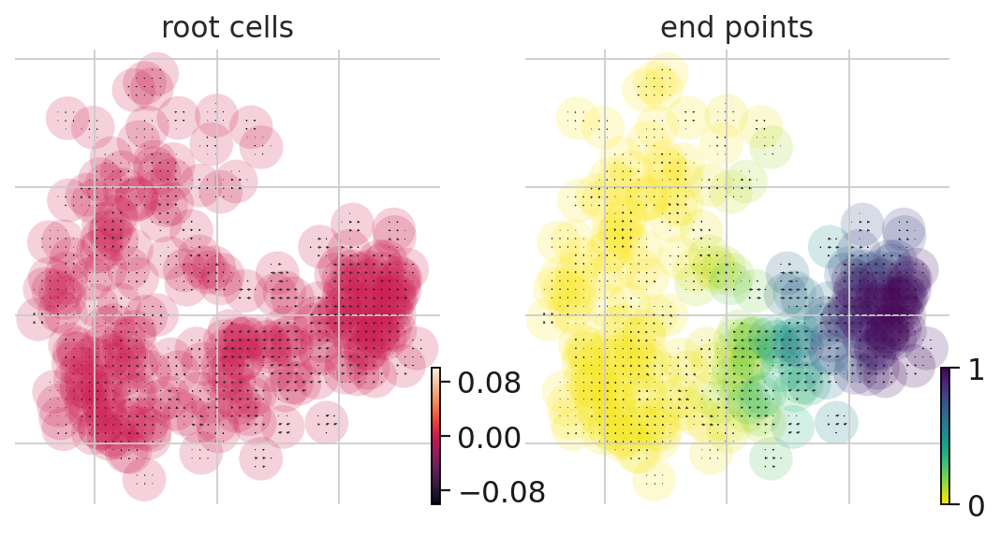

WSSS_PLA8764122


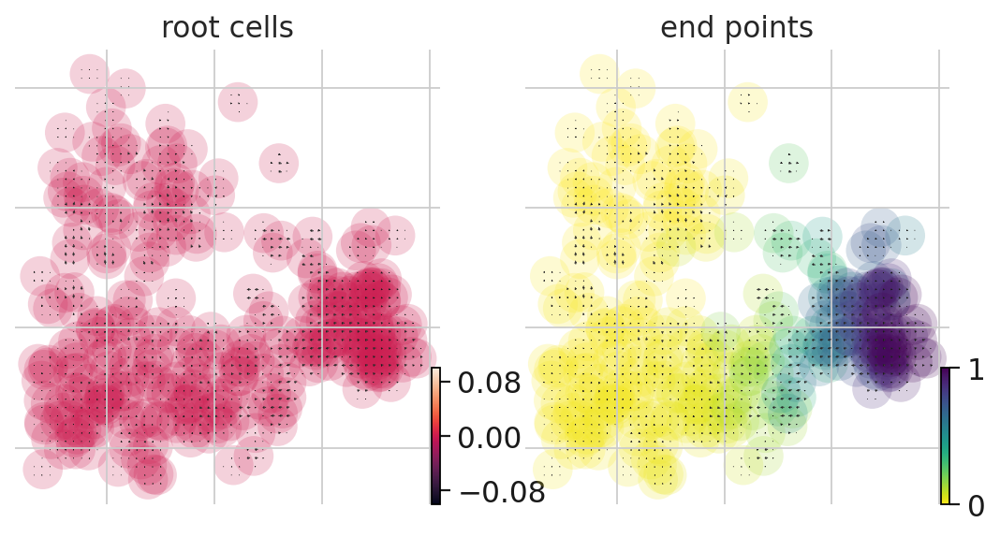

WSSS_PLA8810750


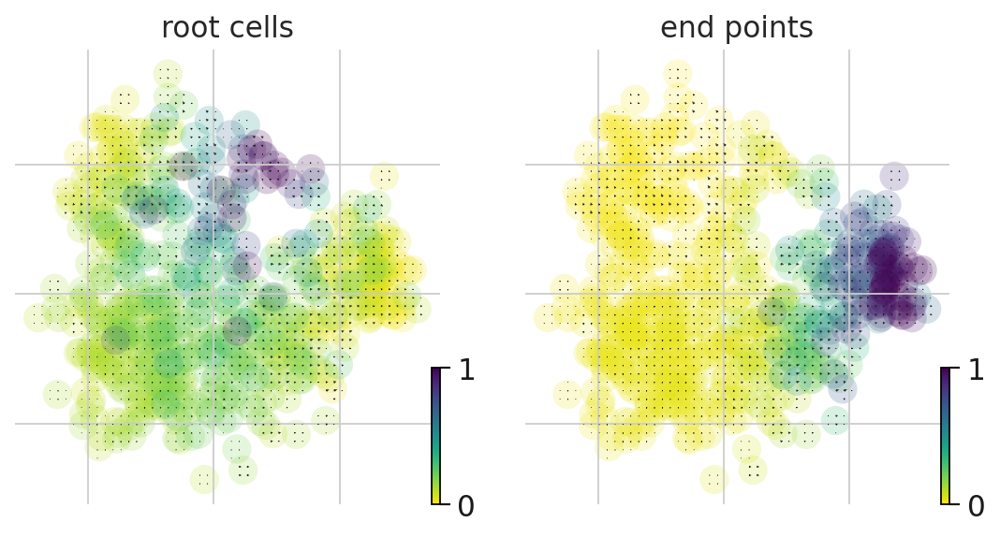

WSSS_PLA8810751


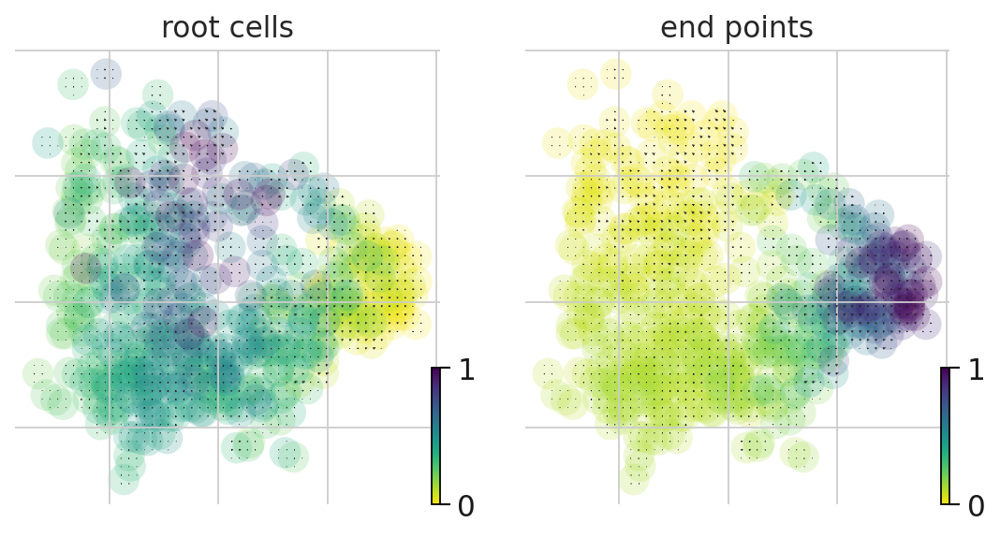

In [220]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='pca', color=['root_cells', 'end_points'])

In [221]:
adata.obs

,n_genes,donor,tissue_block,age,sample,barcode_sample,percent_mito,n_counts,dataset,technique,...,louvain_R_2,prelim_annot_inv_troph,final_annot_inv_troph,root_score_+LGR5_+TP63,root_score_+LGR5_+TP63_-HLA-G_-MKI67,root_argmax_+LGR5_+TP63,root_argmax_+LGR5_+TP63_-HLA-G_-MKI67,rootcell,dpt_pseudotime,palantir_pseudotime
AACAACCAGTCCTGCG-1,2486,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACAACCAGTCCTGCG-1_WSSS_PLA8764121,0.000170,5877.0,snRNA-seq,10X,...,1,inv_troph_3,EVT_3,0.000000,-0.993825,0,0,0,0.736640,0.646171
AACACACCACTGAGGA-1,2081,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACACACCACTGAGGA-1_WSSS_PLA8764121,0.000291,3433.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,0.000000,0.000000,0,0,0,0.229578,0.470050
AACCAACAGGTGGTTG-1,2721,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCAACAGGTGGTTG-1_WSSS_PLA8764121,0.000157,6351.0,snRNA-seq,10X,...,"2,0",VCT_CCC,EVT_1,0.000000,-1.891354,0,0,0,0.258171,0.540808
AACCATGCACTAAACC-1,1718,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCATGCACTAAACC-1_WSSS_PLA8764121,0.000244,4098.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,2.894890,2.894890,0,0,0,0.227170,0.492076
AACCATGTCCAGCACG-1,1489,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,AACCATGTCCAGCACG-1_WSSS_PLA8764121,0.001342,2236.0,snRNA-seq,10X,...,0,VCT_CCC,VCT_CCC,1.699694,1.699694,0,0,0,0.219780,0.428034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1,3863,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTACTGCATTGTAGC-1_WSSS_PLA8810751,0.000334,11983.0,snRNA-seq,10X,...,1,inv_troph_3,EVT_3,0.606780,-1.036591,0,0,0,0.720896,0.625391
TTTACTGTCTGCATGA-1,2917,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTACTGTCTGCATGA-1_WSSS_PLA8810751,0.001026,6823.0,snRNA-seq,10X,...,4,inv_troph_4,EVT_2,0.000000,0.000000,0,0,0,0.550102,0.612573
TTTATGCCAGATACCT-1,2361,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTATGCCAGATACCT-1_WSSS_PLA8810751,0.001711,5259.0,snRNA-seq,10X,...,4,inv_troph_4,EVT_2,0.000000,-1.569242,0,0,0,0.651858,0.690932
TTTGACTCAGGAATAT-1,3547,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,TTTGACTCAGGAATAT-1_WSSS_PLA8810751,0.000207,9681.0,snRNA-seq,10X,...,4,inv_troph_3,EVT_2,0.000000,-0.709489,0,0,0,0.634959,0.725957


In [222]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adata_subset = adata[adata.obs['sample'] == sample]
    adata_subset.obs_names = adata_subset.obs['barcode_sample']
    adata_subset.obs.set_index('barcode_sample', inplace=True)
    adatas_loom[sample].obsm['X_umap'] = adata_subset.obsm['X_umap']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


In [223]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='umap')

WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8764122
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8810750
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


In [224]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.terminal_states(adatas_loom[sample])

WSSS_PLA8764121
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8764122
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810750
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
WSSS_PLA8810751
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', 

WSSS_PLA8764121


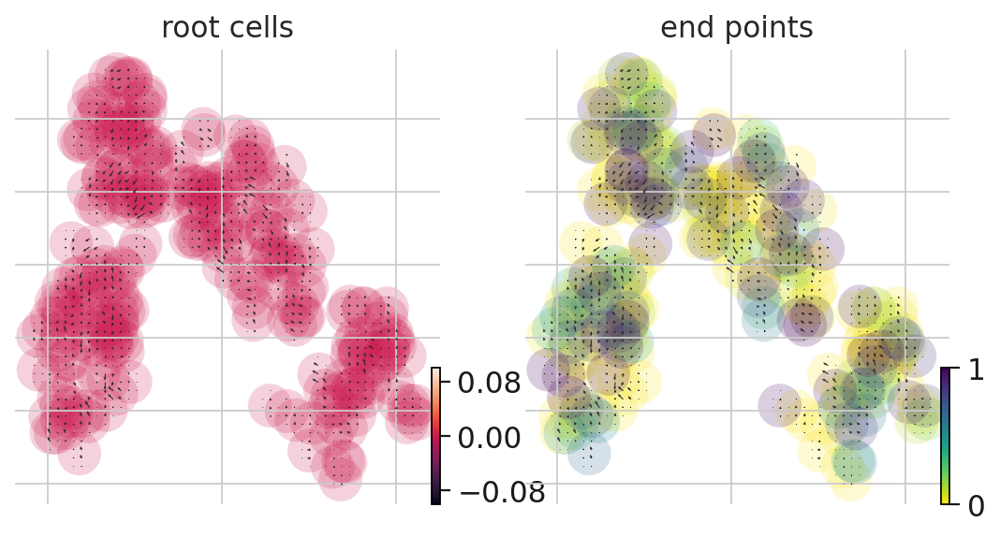

WSSS_PLA8764122


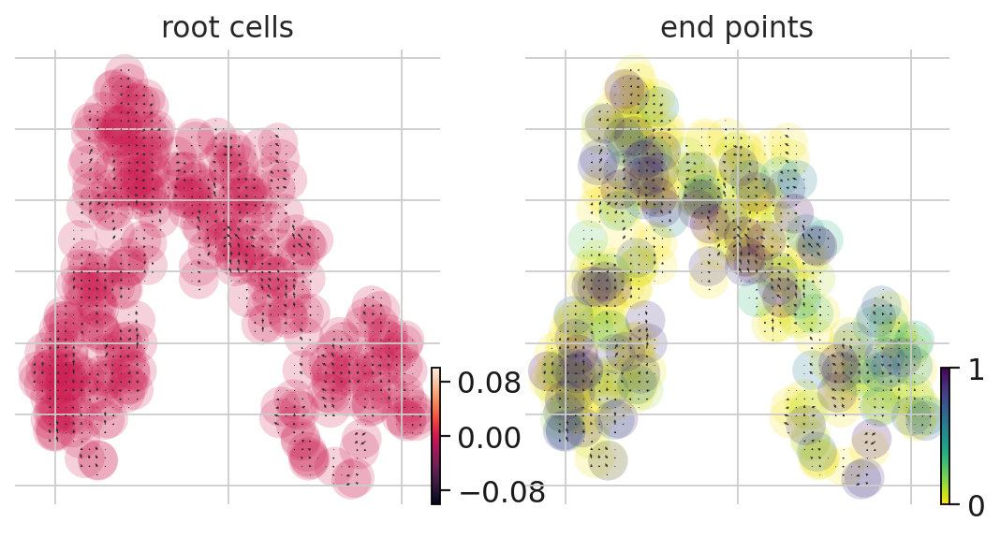

WSSS_PLA8810750


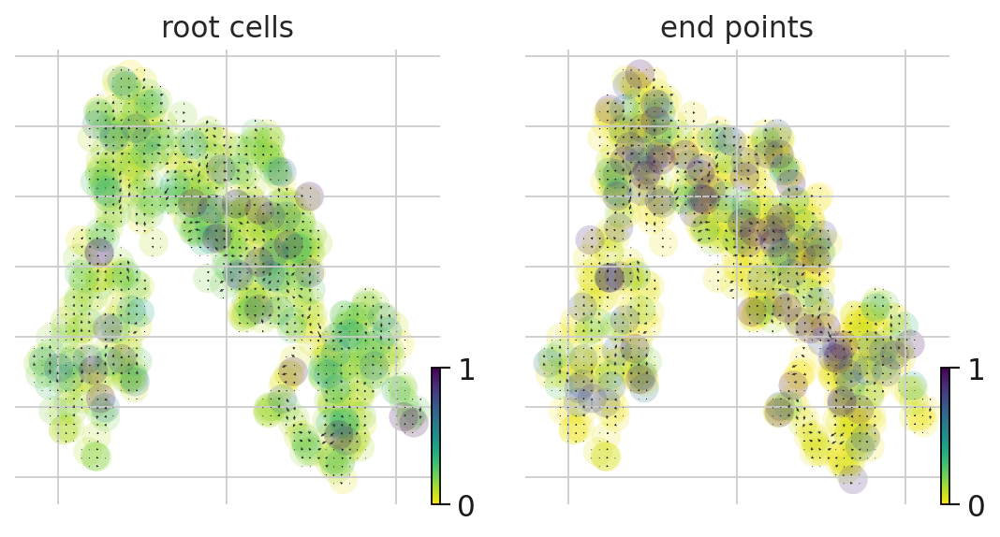

WSSS_PLA8810751


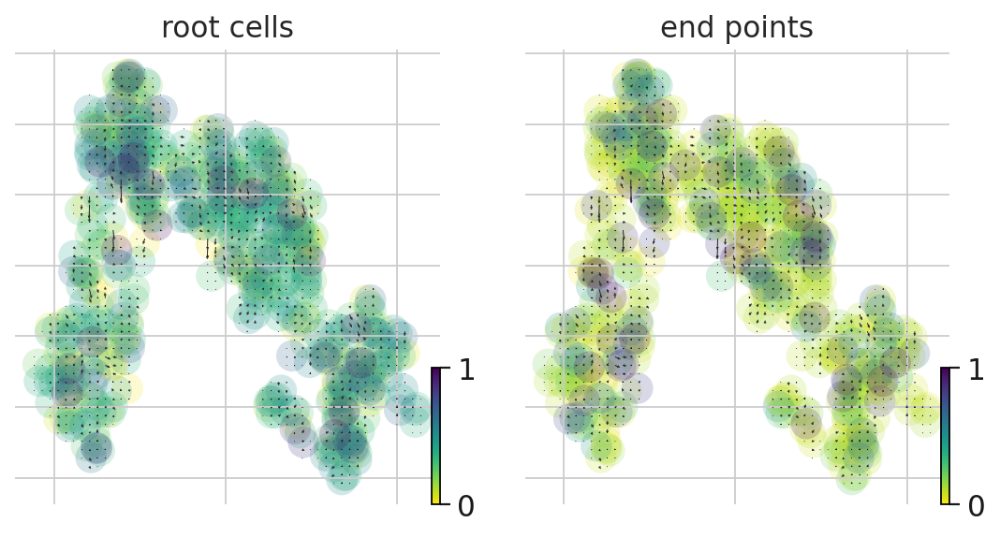

In [225]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='umap', color=['root_cells', 'end_points'])

In [226]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.umap(adatas_loom[sample])

computing UMAP


WSSS_PLA8764121


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8764122


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing UMAP


WSSS_PLA8810750


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)
computing UMAP


WSSS_PLA8810751


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


WSSS_PLA8764121
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


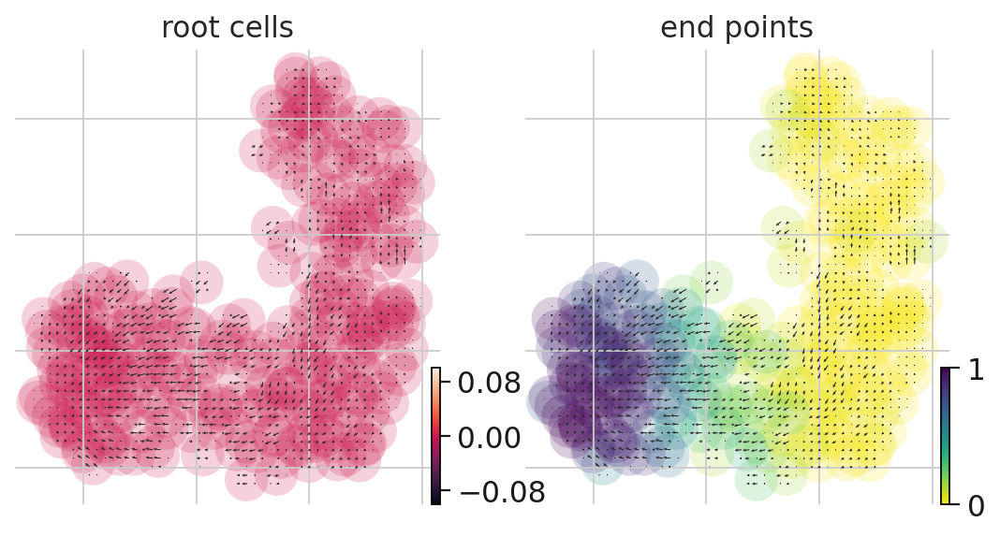

WSSS_PLA8764122
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


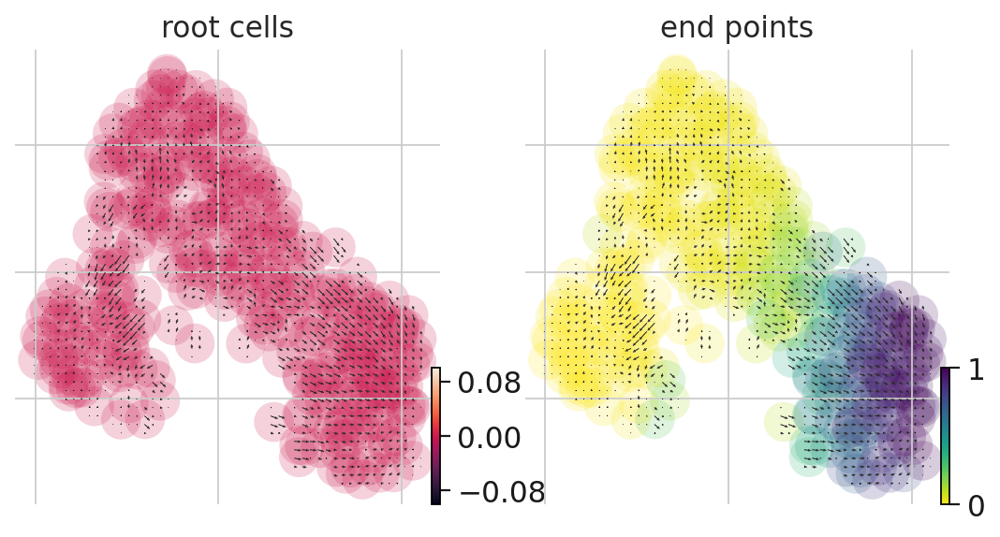

WSSS_PLA8810750
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


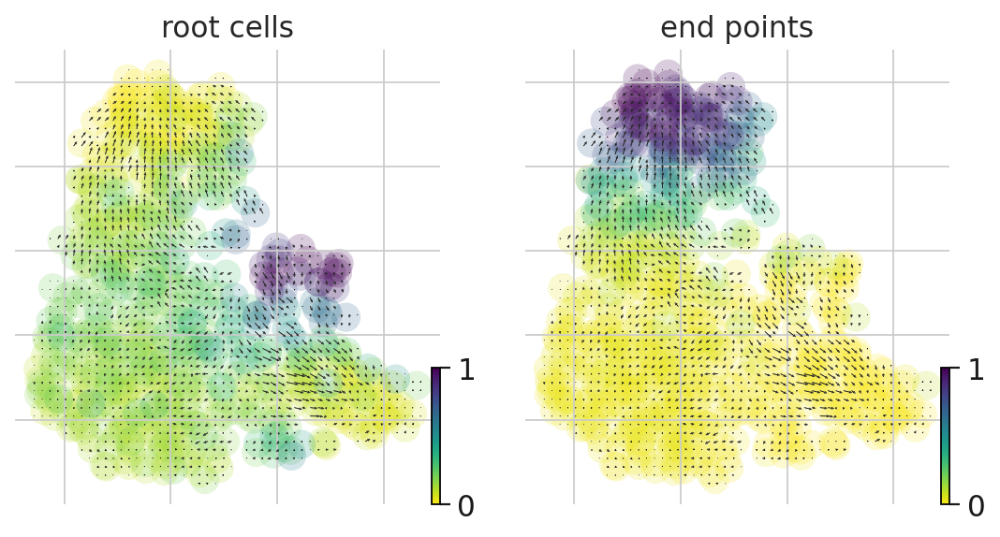

WSSS_PLA8810751
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


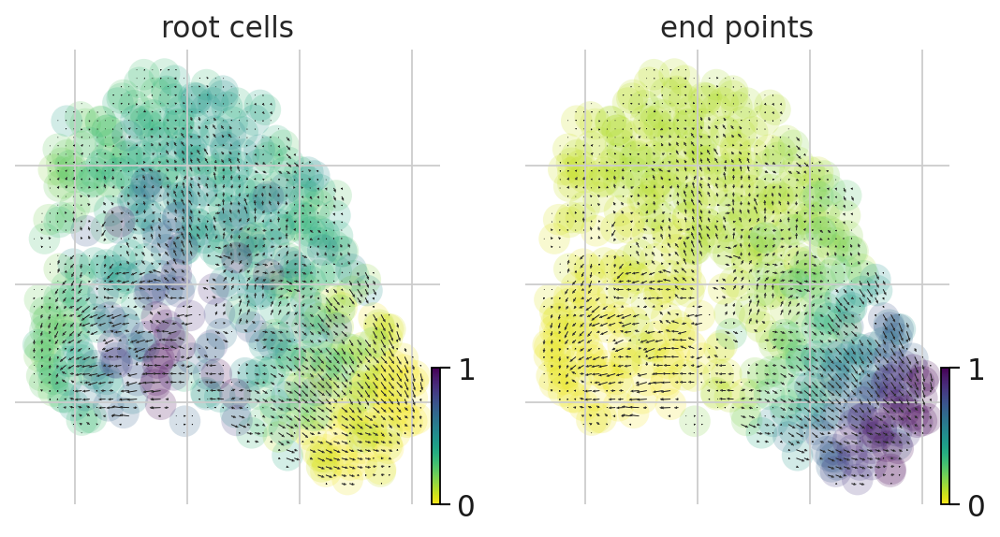

In [227]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.tl.velocity_embedding(adatas_loom[sample], basis='umap')
    scv.tl.terminal_states(adatas_loom[sample])
    scv.pl.velocity_embedding_grid(adatas_loom[sample], basis='umap', color=['root_cells', 'end_points'])

In [228]:
adatas_loom['WSSS_PLA8764121'].obs

,n_counts_spliced,n_counts_unspliced,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,louvain,root_cells,end_points
barcode_sample_sn_like,,,,,,,,,,
CTGCCTATCGCTTTAT-1_WSSS_PLA8764121,175,443,175,443,175.0,94.508568,0.223284,0,0.0,0.923563
TAACTTCGTCTACGTA-1_WSSS_PLA8764121,309,930,309,930,309.0,122.478958,0.221395,1,0.0,0.012230
ACGCACGTCGATTGAC-1_WSSS_PLA8764121,215,914,215,914,215.0,121.279091,0.112191,1,0.0,0.014032
TGGATGTGTGCACAAG-1_WSSS_PLA8764121,109,379,109,379,109.0,109.357826,0.055360,0,0.0,0.385066
CAACGATTCCTCTCGA-1_WSSS_PLA8764121,163,330,163,330,163.0,121.576683,0.129057,2,0.0,0.002067
...,...,...,...,...,...,...,...,...,...,...
CAGGTATTCACTAGCA-1_WSSS_PLA8764121,143,780,143,780,143.0,110.447556,0.060352,1,0.0,0.012729
TCTTTGATCTCTGACC-1_WSSS_PLA8764121,110,462,110,462,110.0,83.981819,0.137934,0,0.0,0.766204
CACTGAATCGCTCTCA-1_WSSS_PLA8764121,149,367,149,367,149.0,126.000000,0.084729,2,0.0,0.003270


In [229]:
adata.obs_names = adata.obs['barcode_sample']
adata.obs.set_index('barcode_sample', inplace=True)

In [230]:
adata.obs['root_cells_velocyto'] = [0 for i in range(len(adata.obs))]
adata.obs['end_points_velocyto'] = [0 for i in range(len(adata.obs))]

In [231]:
# smth wrong with this code
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adata[adata.obs['sample'] == sample].obs.loc[adatas_loom[sample].obs_names,'root_cells_velocyto'] = list(adatas_loom[sample].obs['root_cells'])
    adata[adata.obs['sample'] == sample].obs.loc[adatas_loom[sample].obs_names,'end_points_velocyto'] = list(adatas_loom[sample].obs['end_points'])


WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


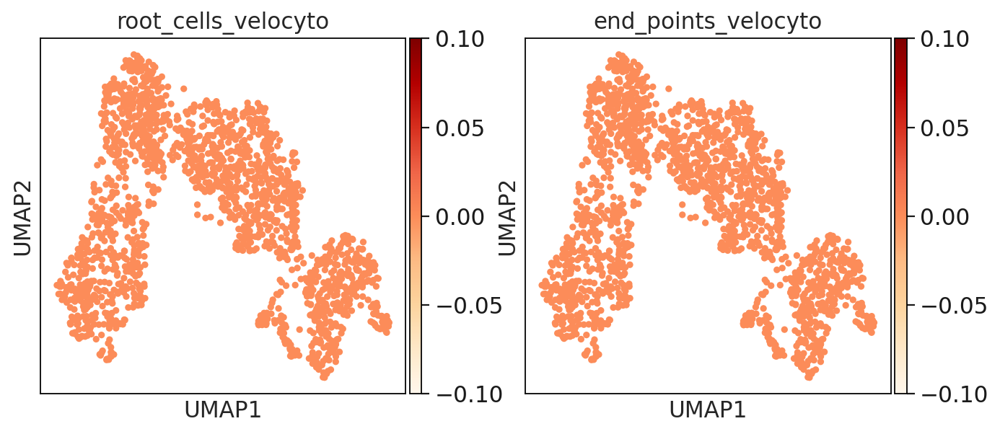

In [232]:
# this is wrong
sc.pl.umap(adata, color=['root_cells_velocyto','end_points_velocyto'], cmap='OrRd')

WSSS_PLA8764121


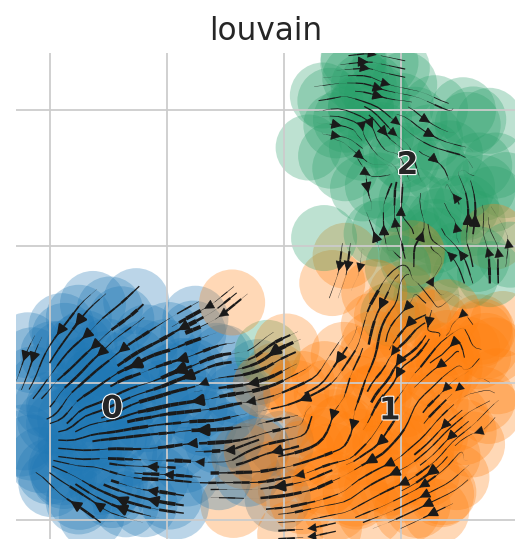

WSSS_PLA8764122


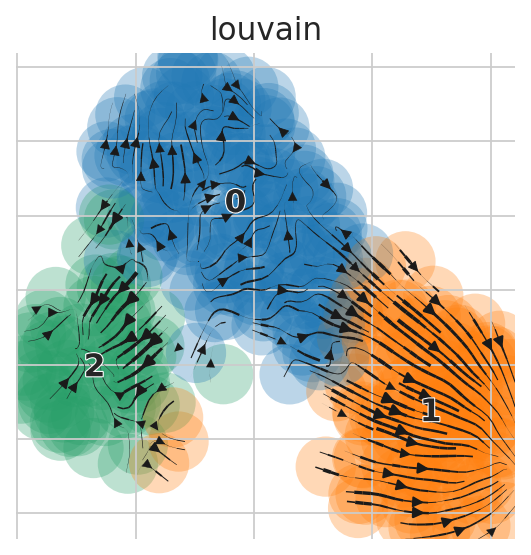

WSSS_PLA8810750


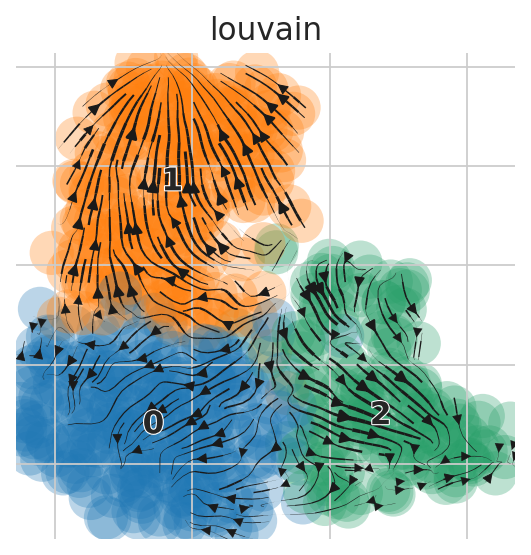

WSSS_PLA8810751


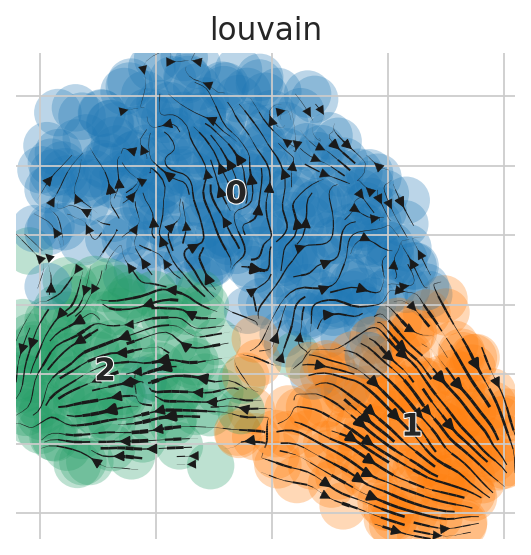

In [233]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_stream(adatas_loom[sample], basis='umap')


In [234]:
adatas_loom['WSSS_PLA8764121']

AnnData object with n_obs × n_vars = 272 × 613
    obs: 'n_counts_spliced', 'n_counts_unspliced', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'louvain', 'root_cells', 'end_points'
    var: 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'louvain', 'louvain_colors', 'umap'
    obsm: 'X_pca', 'velocity_pca', 'X_umap', 'velocity_umap'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

WSSS_PLA8764121


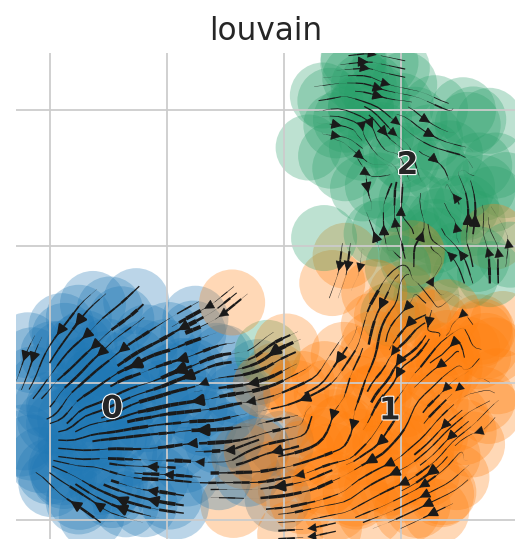

WSSS_PLA8764122


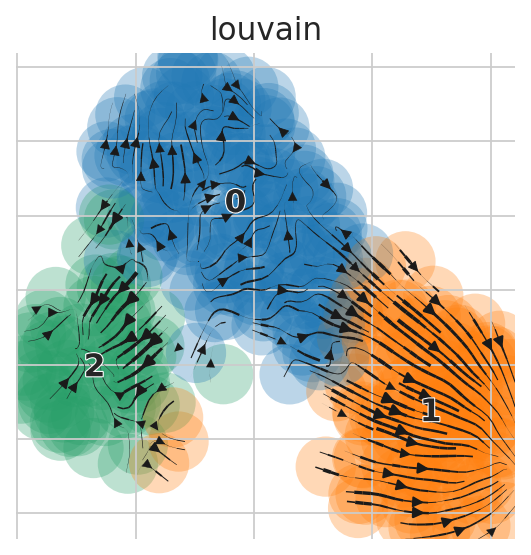

WSSS_PLA8810750


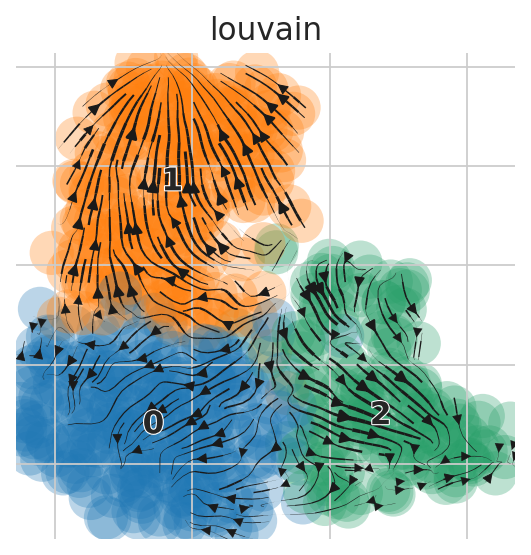

WSSS_PLA8810751


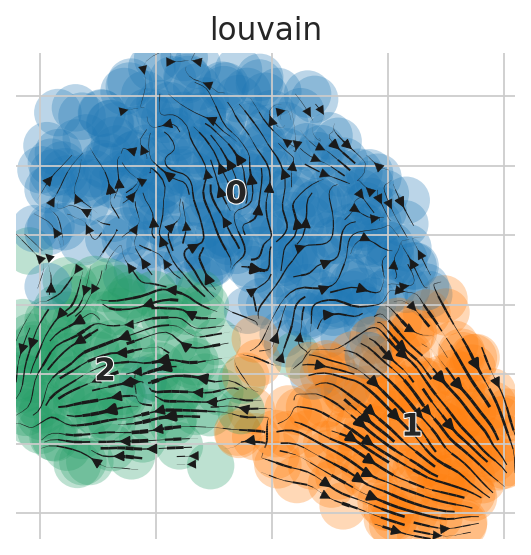

In [235]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    scv.pl.velocity_embedding_stream(adatas_loom[sample], basis='X_umap')


In [236]:
adata.obs

,n_genes,donor,tissue_block,age,sample,percent_mito,n_counts,dataset,technique,scrublet_score,...,final_annot_inv_troph,root_score_+LGR5_+TP63,root_score_+LGR5_+TP63_-HLA-G_-MKI67,root_argmax_+LGR5_+TP63,root_argmax_+LGR5_+TP63_-HLA-G_-MKI67,rootcell,dpt_pseudotime,palantir_pseudotime,root_cells_velocyto,end_points_velocyto
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AACAACCAGTCCTGCG-1_WSSS_PLA8764121,2486,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000170,5877.0,snRNA-seq,10X,0.068493,...,EVT_3,0.000000,-0.993825,0,0,0,0.736640,0.646171,0,0
AACACACCACTGAGGA-1_WSSS_PLA8764121,2081,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000291,3433.0,snRNA-seq,10X,0.070162,...,VCT_CCC,0.000000,0.000000,0,0,0,0.229578,0.470050,0,0
AACCAACAGGTGGTTG-1_WSSS_PLA8764121,2721,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000157,6351.0,snRNA-seq,10X,0.107143,...,EVT_1,0.000000,-1.891354,0,0,0,0.258171,0.540808,0,0
AACCATGCACTAAACC-1_WSSS_PLA8764121,1718,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000244,4098.0,snRNA-seq,10X,0.068493,...,VCT_CCC,2.894890,2.894890,0,0,0,0.227170,0.492076,0,0
AACCATGTCCAGCACG-1_WSSS_PLA8764121,1489,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.001342,2236.0,snRNA-seq,10X,0.062229,...,VCT_CCC,1.699694,1.699694,0,0,0,0.219780,0.428034,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGCATTGTAGC-1_WSSS_PLA8810751,3863,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.000334,11983.0,snRNA-seq,10X,0.025431,...,EVT_3,0.606780,-1.036591,0,0,0,0.720896,0.625391,0,0
TTTACTGTCTGCATGA-1_WSSS_PLA8810751,2917,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.001026,6823.0,snRNA-seq,10X,0.030408,...,EVT_2,0.000000,0.000000,0,0,0,0.550102,0.612573,0,0
TTTATGCCAGATACCT-1_WSSS_PLA8810751,2361,P13,PU8-9_B2,8-9_PCW,WSSS_PLA8810751,0.001711,5259.0,snRNA-seq,10X,0.022047,...,EVT_2,0.000000,-1.569242,0,0,0,0.651858,0.690932,0,0


In [237]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['cell_type'] = adata.obs.loc[adatas_loom[sample].obs_names,'final_annot_inv_troph']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


WSSS_PLA8764121


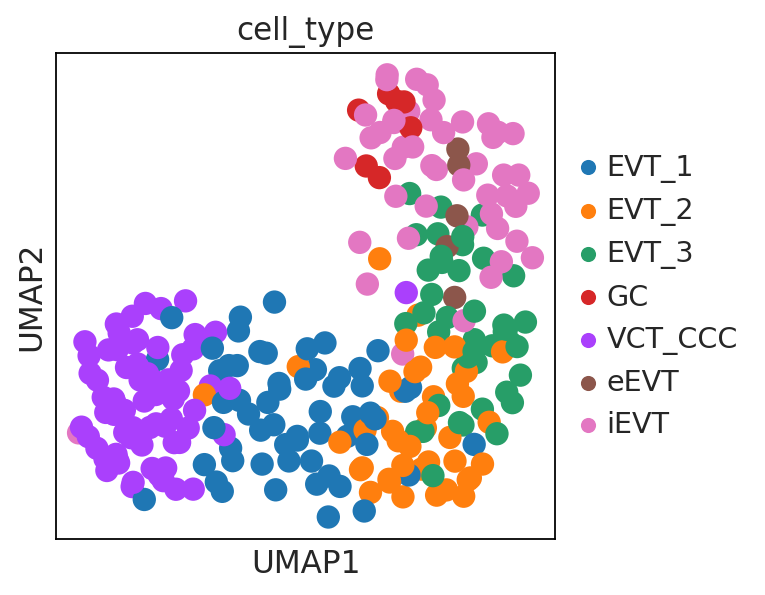

WSSS_PLA8764122


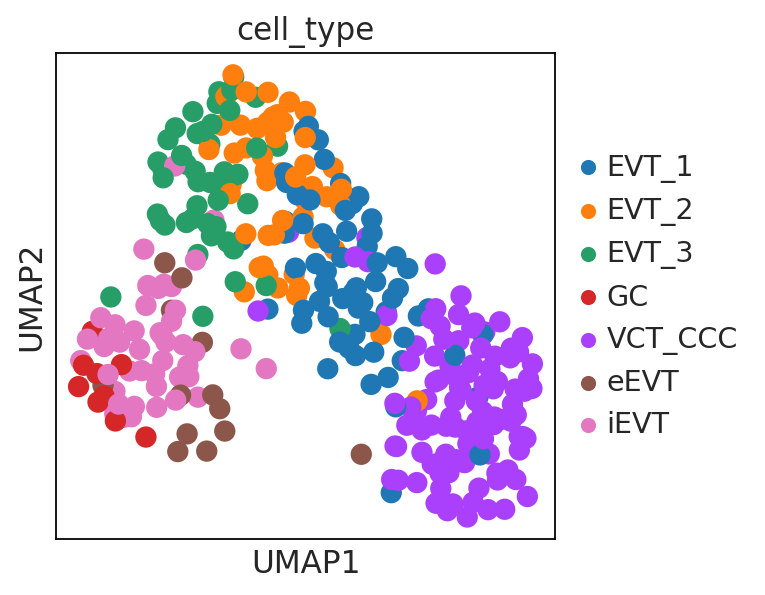

WSSS_PLA8810750


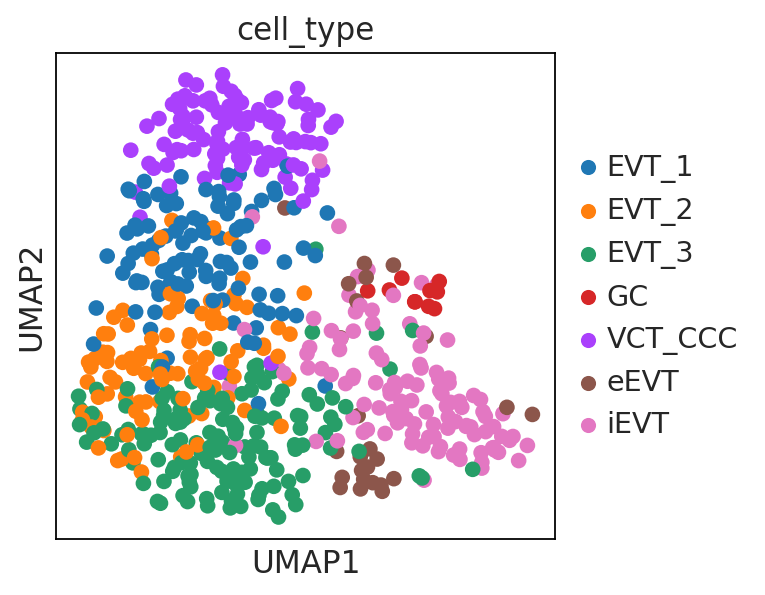

WSSS_PLA8810751


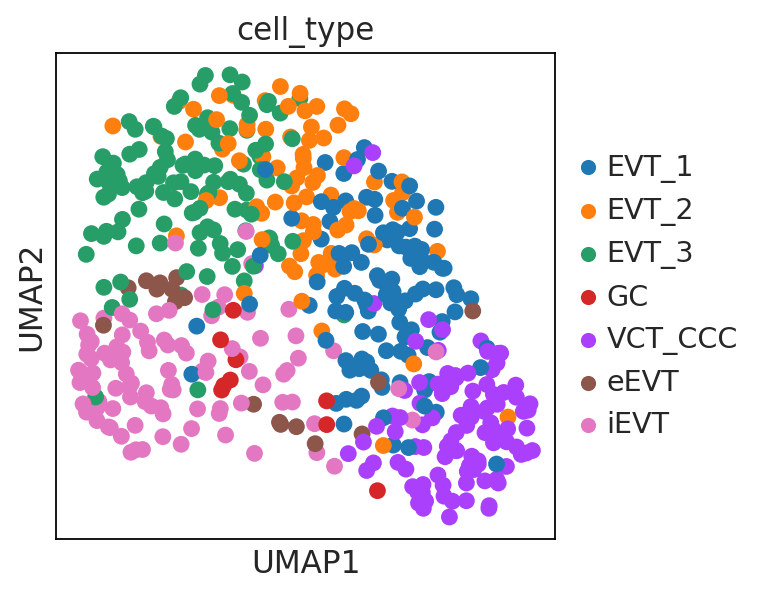

In [238]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    sc.pl.umap(adatas_loom[sample], color='cell_type')

In [239]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    adatas_loom[sample].obs['sample'] = adata.obs.loc[adatas_loom[sample].obs_names,'sample']
    adatas_loom[sample].obs['tissue_block'] = adata.obs.loc[adatas_loom[sample].obs_names,'tissue_block']

WSSS_PLA8764121
WSSS_PLA8764122
WSSS_PLA8810750
WSSS_PLA8810751


WSSS_PLA8764121


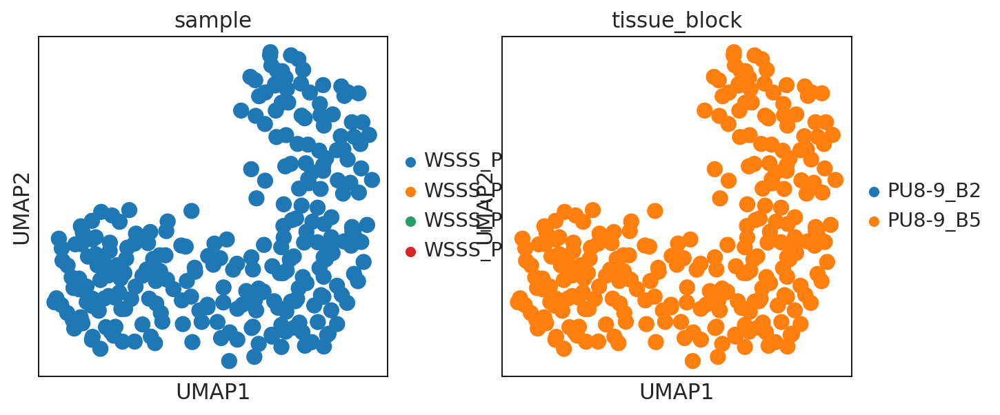

WSSS_PLA8764122


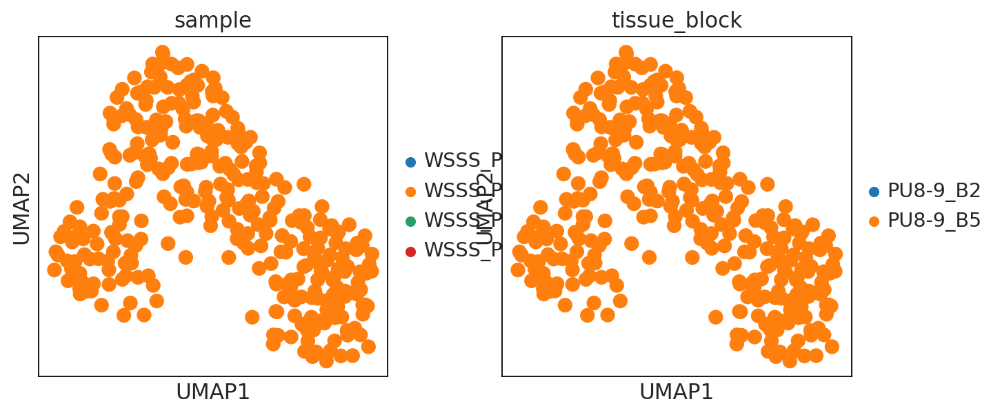

WSSS_PLA8810750


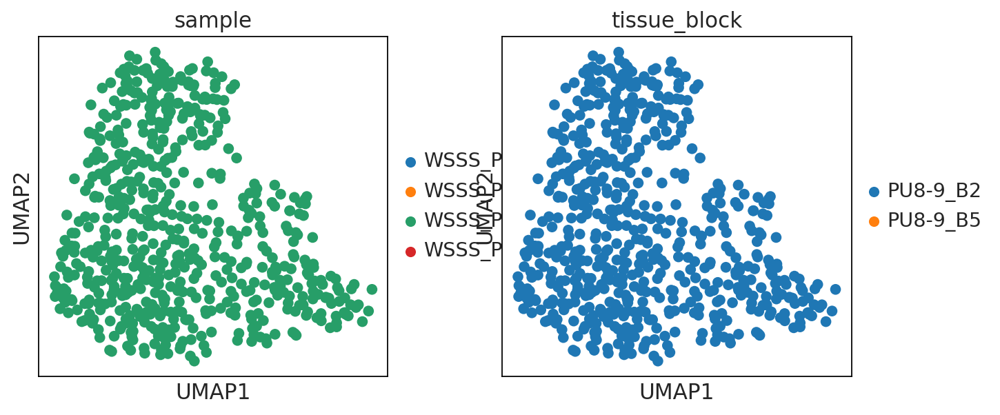

WSSS_PLA8810751


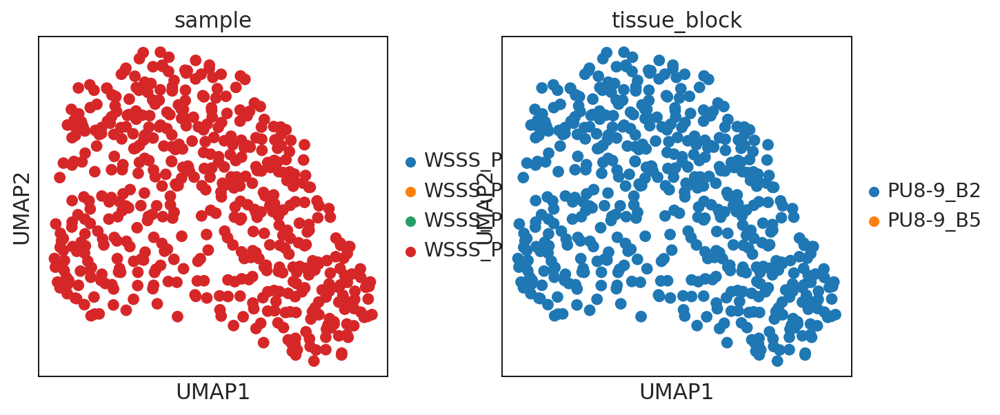

In [240]:
for sample in list(np.unique(adata.obs['sample'])):
    print(sample)
    sc.pl.umap(adatas_loom[sample], color=['sample','tissue_block'])

# Nothing clean.